In [1]:
import pandas as pd
import numpy as np
import yfinance as yf
from arch import arch_model
from scipy.stats import genpareto, chi2
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
import warnings

import yfinance as yf
import pandas as pd
import numpy as np

def compute_log_returns_yf(ticker, start_date, end_date):
    data = yf.download(ticker, start=start_date, end=end_date, progress=False, auto_adjust=True)
    
    if len(data.columns) > 0:
        df = pd.DataFrame()
        df['Price'] = data['Close']
        df['LogReturn'] = 100 * np.log(df['Price'] / df['Price'].shift(1))
        df = df.dropna(subset=['LogReturn'])
        
        return df
    else:
        raise ValueError(f"No data found for {ticker}")

tickers = ['^KS11', '^GSPC', '000001.SS', '^N225']

# 전체 기간 정의
start_date = '2014-01-01'
end_date = '2024-12-31'
train_end = '2022-09-30'
test_start = '2022-10-01'

train_returns = {}
test_returns = {}
price_dict = {}

# 1. 먼저 모든 데이터를 수집
for ticker in tickers:
    full_df = compute_log_returns_yf(ticker, start_date, end_date)
    
    train_df = full_df[full_df.index <= train_end]
    test_df = full_df[full_df.index >= test_start]
    
    train_returns[ticker] = train_df['LogReturn']
    test_returns[ticker] = test_df['LogReturn']
    price_dict[ticker] = full_df['Price']

# 2. 공통 거래일 추출
# Train 기간 공통 거래일
common_train_dates = train_returns[tickers[0]].index
for ticker in tickers[1:]:
    common_train_dates = common_train_dates.intersection(train_returns[ticker].index)

# Test 기간 공통 거래일
common_test_dates = test_returns[tickers[0]].index
for ticker in tickers[1:]:
    common_test_dates = common_test_dates.intersection(test_returns[ticker].index)

print(f"공통 Train 거래일 수: {len(common_train_dates)}")
print(f"공통 Test 거래일 수: {len(common_test_dates)}")

# 3. 원본 변수를 공통 거래일로 필터링 (변수명 유지)
for ticker in tickers:
    # reindex를 사용하여 공통 거래일만 선택
    train_returns[ticker] = train_returns[ticker].reindex(common_train_dates)
    test_returns[ticker] = test_returns[ticker].reindex(common_test_dates)
    
    # NaN 값 제거 (혹시 있을 수 있는 경우를 대비)
    train_returns[ticker] = train_returns[ticker].dropna()
    test_returns[ticker] = test_returns[ticker].dropna()

# 4. 결과 확인
print("\n공통 거래일 적용 후 데이터 수:")
for ticker in tickers:
    print(f"{ticker} - Train: {len(train_returns[ticker])}, Test: {len(test_returns[ticker])}")

공통 Train 거래일 수: 1887
공통 Test 거래일 수: 484

공통 거래일 적용 후 데이터 수:
^KS11 - Train: 1887, Test: 484
^GSPC - Train: 1887, Test: 484
000001.SS - Train: 1887, Test: 484
^N225 - Train: 1887, Test: 484


In [2]:
def create_enhanced_summary_statistics(train_returns, test_returns):
    import pandas as pd
    from scipy import stats
    
    summary_stats = []
    
    for name in train_returns.keys():
        for period, data in [('Train', train_returns[name]), ('Test', test_returns[name])]:
            # 기본 통계
            basic_stats = {
                'Asset': name,
                'Period': period,
                'Mean': data.mean(),
                'Std Dev': data.std(),
                'Skewness': data.skew(),
                'Kurtosis': data.kurtosis(),
                'Min': data.min(),
                'Max': data.max(),
                'Count': len(data)
            }
            
            # 추가 통계
            additional_stats = {
                # 리스크 지표
                
                # 정규성 검정
                'JB Stat': stats.jarque_bera(data)[0],
                'JB p-value': stats.jarque_bera(data)[1],
                
                # 극단값 비율
                '% > 2σ': (np.abs(data) > 2*data.std()).sum() / len(data) * 100,
                '% > 3σ': (np.abs(data) > 3*data.std()).sum() / len(data) * 100
            }
            
            # 합치기
            full_stats = {**basic_stats, **additional_stats}
            summary_stats.append(full_stats)
    
    # DataFrame 생성
    stats_df = pd.DataFrame(summary_stats)
    
    # 숫자 컬럼만 반올림
    numeric_columns = stats_df.select_dtypes(include=[np.number]).columns
    stats_df[numeric_columns] = stats_df[numeric_columns].round(4)
    
    return stats_df

# 실행
enhanced_stats = create_enhanced_summary_statistics(train_returns, test_returns)
print(enhanced_stats)

       Asset Period    Mean  Std Dev  Skewness  Kurtosis      Min     Max  \
0      ^KS11  Train  0.0070   0.9917   -0.4714    8.6885  -8.7670  8.2513   
1      ^KS11   Test -0.0216   1.1351   -0.8708    9.4245  -9.1761  5.5049   
2      ^GSPC  Train  0.0424   1.1425   -1.0875   18.8209 -12.7652  8.9683   
3      ^GSPC   Test  0.0808   0.9250    0.2275    2.6591  -3.0427  5.3953   
4  000001.SS  Train  0.0128   1.3583   -0.9823    7.5210  -8.8732  6.0399   
5  000001.SS   Test  0.0161   0.9923    1.5092    9.2104  -3.1102  7.7550   
6      ^N225  Train  0.0261   1.2807   -0.1055    4.3141  -8.2529  7.7314   
7      ^N225   Test  0.0545   1.3798   -1.3823   22.7657 -13.2341  9.7366   

   Count     JB Stat  JB p-value  % > 2σ  % > 3σ  
0   1887   5969.5305         0.0  4.3985  1.3778  
1    484   1810.6534         0.0  3.9256  0.6198  
2   1887  28065.6622         0.0  4.1865  1.4308  
3    484    142.5110         0.0  5.3719  0.8264  
4   1887   4723.2170         0.0  4.7165  2.0138  


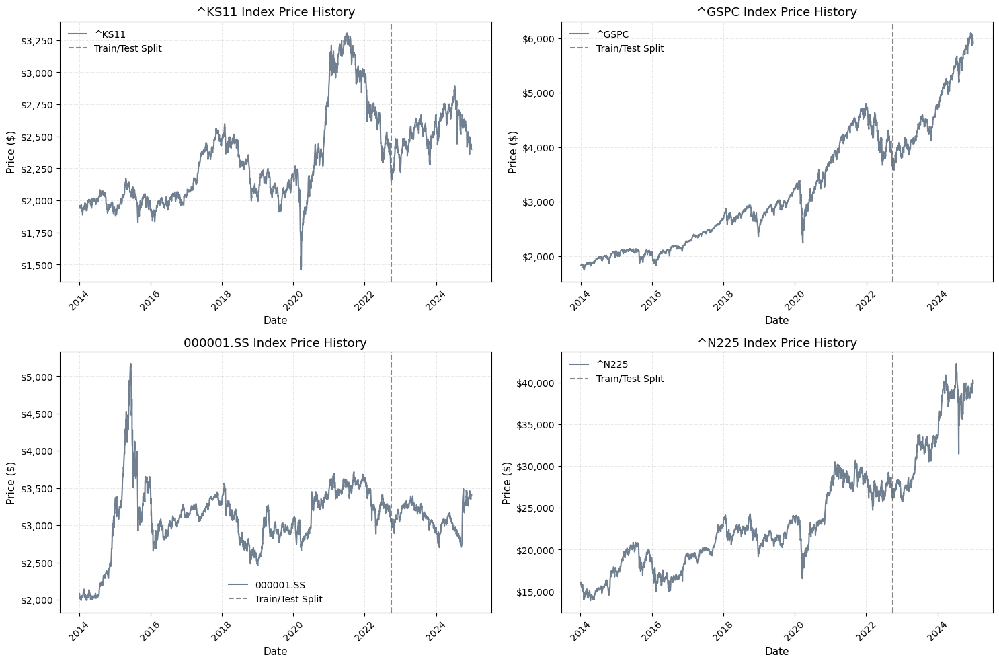

In [3]:
def plot_asset_prices(price_dict, save_path='price_graph.png'):
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    axes = axes.flatten()
    
    for idx, (name, prices) in enumerate(price_dict.items()):
        ax = axes[idx]
        
        # 가격 플롯 (연한 회색)
        ax.plot(prices.index, prices.values, linewidth=1.5, label=name, color='slategray')
        
        # 학습/테스트 기간 구분선
        train_end = pd.Timestamp('2022-09-30')
        ax.axvline(train_end, color='dimgray', linestyle='--', alpha=0.8, label='Train/Test Split')
        
        # 포맷팅
        ax.set_title(f'{name} Index Price History', fontsize=13)
        ax.set_xlabel('Date', fontsize=11)
        ax.set_ylabel('Price ($)', fontsize=11)
        ax.legend(loc='best', fontsize=10, frameon=False)
        
        # y축 포맷
        ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'${x:,.0f}'))
        
        # x축 날짜 포맷
        ax.tick_params(axis='x', rotation=45)
        
        # Grid
        ax.grid(True, linestyle=':', linewidth=0.5, alpha=0.7)
    
    #plt.suptitle('KOSPI, S&P 500, SSE, and Nikkei 225 Price Trends (2014–2024)', fontsize=15, y=1.02)
    plt.tight_layout(pad=1.2)
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    plt.show()

# 실행
plot_asset_prices(price_dict)

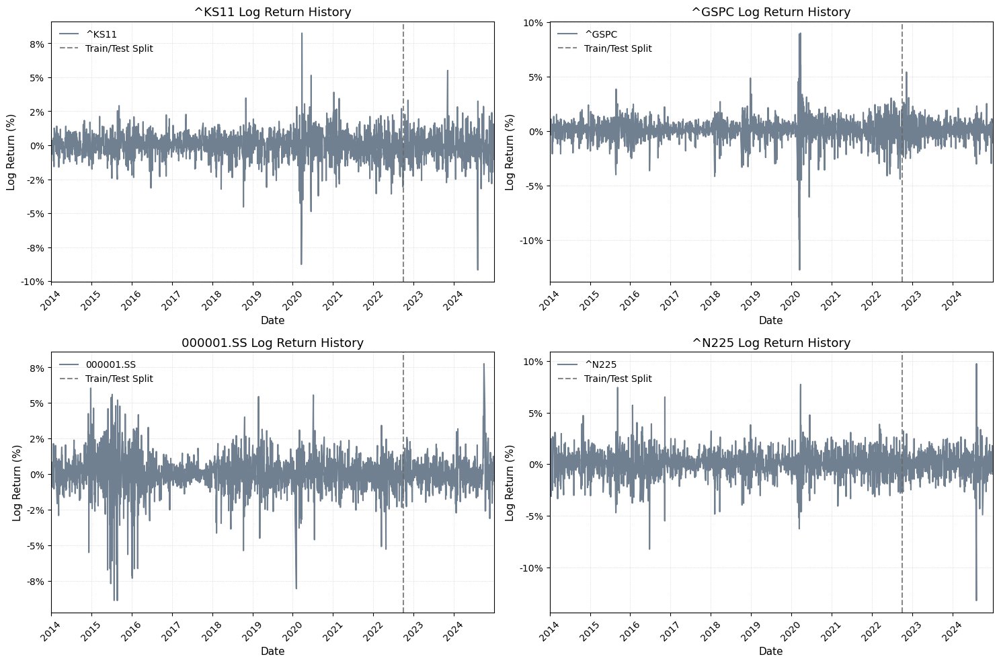

In [4]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_log_return(logreturn_dict, save_path='logreturn_graph.png'):
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    axes = axes.flatten()
    
    for idx, (name, logreturns) in enumerate(logreturn_dict.items()):
        ax = axes[idx]
        
        # 로그리턴 플롯 (연한 회색)
        ax.plot(logreturns.index, logreturns.values, linewidth=1.5, label=name, color='slategray')
        
        # 학습/테스트 구분선
        train_end = pd.Timestamp('2022-09-30')
        ax.axvline(train_end, color='dimgray', linestyle='--', alpha=0.8, label='Train/Test Split')
        
        # 포맷팅
        ax.set_title(f'{name} Log Return History', fontsize=13)
        ax.set_xlabel('Date', fontsize=11)
        ax.set_ylabel('Log Return (%)', fontsize=11)
        ax.legend(loc='best', fontsize=10, frameon=False)
        
        # y축 포맷
        ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{x:.0f}%'))
        
        # x축 범위를 2014-01-01 ~ 2024-12-31로 고정
        ax.set_xlim([pd.Timestamp('2014-01-01'), pd.Timestamp('2024-12-31')])
        
        # x축 포맷: mdates 대신 pandas 인덱스 사용하여 연도만 표시
        tick_dates = pd.date_range(start='2014-01-01', end='2024-12-31', freq='YS')
        ax.set_xticks(tick_dates)
        ax.set_xticklabels([date.strftime('%Y') for date in tick_dates], rotation=45)
        
        # Grid
        ax.grid(True, linestyle=':', linewidth=0.5, alpha=0.7)
    
    plt.tight_layout(pad=1.2)
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    plt.show()




full_returns = {}
for name in tickers: 
    full_returns[name] = pd.concat([train_returns[name], test_returns[name]])


plot_log_return(full_returns)


In [5]:
def fit_garch_models(train_returns, model_type='EGARCH', p=1, q=1, dist='t'):
    models = {}
    residuals = {}
    
    for name, returns in train_returns.items():
        # 모델 설정
        if model_type.upper() == 'GARCH':
            # GARCH 모델 설정
            model = arch_model(
                returns, 
                mean='Constant',
                vol='GARCH',  # GARCH 모델
                p=p,
                q=q,
                dist=dist
            )
        elif model_type.upper() == 'EGARCH':
            # EGARCH 모델 설정 (표준 EGARCH)
            model = arch_model(
                returns, 
                mean='Constant',
                vol='EGARCH',  # EGARCH 모델
                p=p,
                o=1,  # 비대칭성 (leverage effect) 반영
                q=q,
                dist=dist
            )
        elif model_type.upper() == 'GJR-GARCH':
            # GJR-GARCH 모델 설정 (o=1)
            model = arch_model(
                returns, 
                mean='Constant',
                vol='GARCH',  # GJR-GARCH는 GARCH 구조
                p=p,
                o=1,  # GJR을 위한 threshold parameter
                q=q,
                dist=dist
            )
        else:
            raise ValueError(f"Invalid model_type: {model_type}")
        
        try:
            fitted = model.fit(disp='off')
            models[name] = fitted
            
            # 모델 요약 출력
            print(f"\n{name} {model_type} Model Summary:")
            print(fitted.summary())
            
            # 표준화된 잔차 계산
            residuals[name] = fitted.resid / fitted.conditional_volatility
            
        except Exception as e:
            print(f"Error fitting {name}: {e}")
            models[name] = None
            residuals[name] = None
    
    return models, residuals


egarch_models, egarch_residuals = fit_garch_models(train_returns, model_type='EGARCH')

garch_models, garch_residuals = fit_garch_models(train_returns, model_type='GARCH')

gjr_models, gjr_residuals = fit_garch_models(train_returns, model_type='GJR-GARCH')




^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2342.91
Distribution:      Standardized Student's t   AIC:                           4697.82
Method:                  Maximum Likelihood   BIC:                           4731.08
                                              No. Observations:                 1887
Date:                      Sat, Aug 16 2025   Df Residuals:                     1886
Time:                              18:53:23   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
--------------------------------------------------

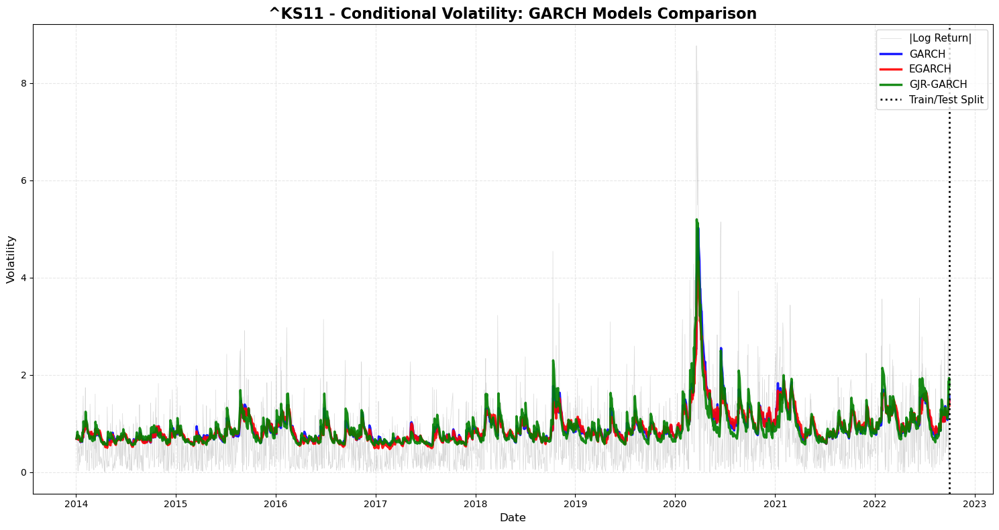

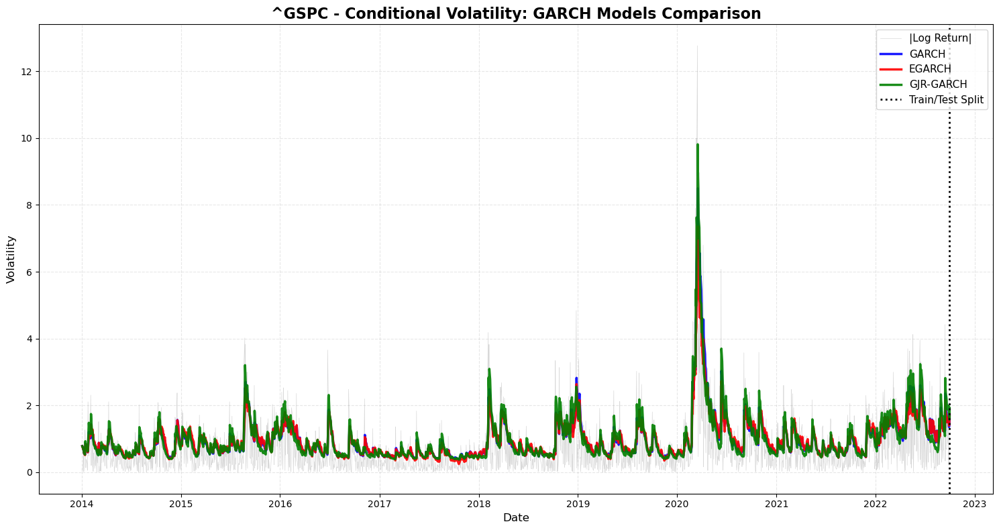

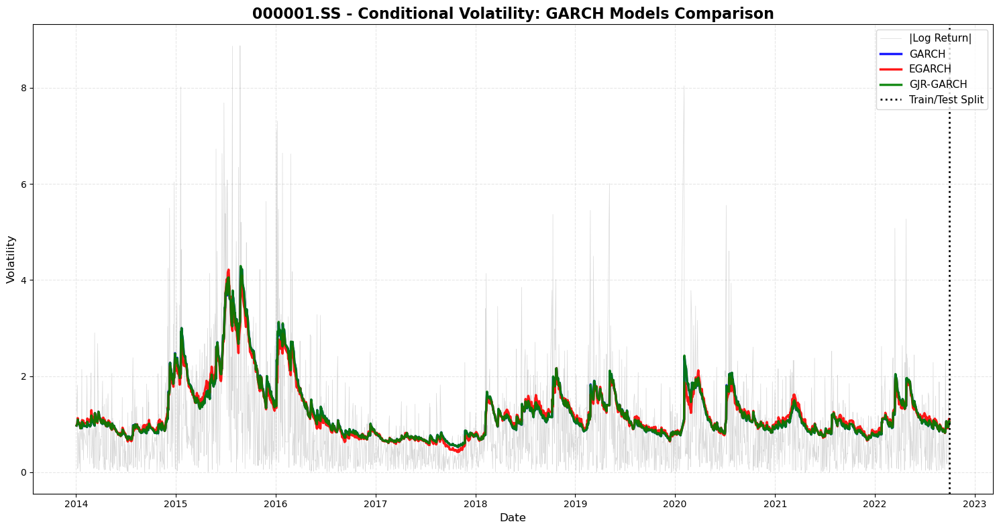

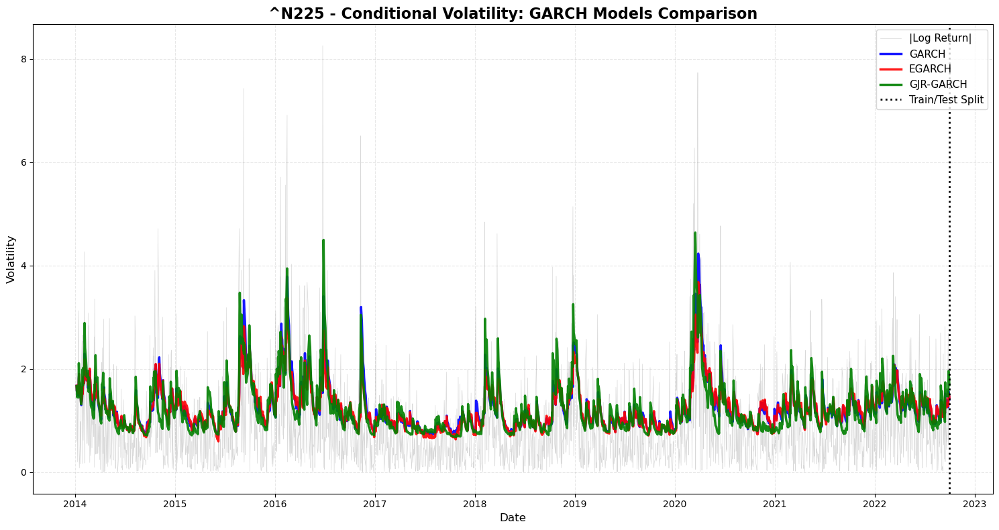

In [8]:
def plot_volatilities_single_panel(train_returns, garch_models, egarch_models, gjr_models, asset_name):
    """
    Plot all GARCH model volatilities for a single asset in one panel
    """
    plt.figure(figsize=(15, 8))
    
    # 원본 수익률의 절대값
    plt.plot(train_returns[asset_name].index, np.abs(train_returns[asset_name]), 
            color='grey', alpha=0.3, label=f'|Log Return|', linewidth=0.5)
    
    # 각 모델의 변동성
    if asset_name in garch_models and garch_models[asset_name] is not None:
        plt.plot(garch_models[asset_name].conditional_volatility.index, 
                garch_models[asset_name].conditional_volatility, 
                color='blue', lw=2.5, label='GARCH', alpha=0.9)
    
    if asset_name in egarch_models and egarch_models[asset_name] is not None:
        plt.plot(egarch_models[asset_name].conditional_volatility.index, 
                egarch_models[asset_name].conditional_volatility, 
                color='red', lw=2.5, label='EGARCH', alpha=0.9)
    
    if asset_name in gjr_models and gjr_models[asset_name] is not None:
        plt.plot(gjr_models[asset_name].conditional_volatility.index, 
                gjr_models[asset_name].conditional_volatility, 
                color='green', lw=2.5, label='GJR-GARCH', alpha=0.9)
    
    # 학습/테스트 기간 구분선
    plt.axvline(train_returns[asset_name].index[-1], color='black', 
               linestyle=':', lw=2, label='Train/Test Split')
    
    plt.title(f'{asset_name} - Conditional Volatility: GARCH Models Comparison', 
             fontsize=16, fontweight='bold')
    plt.xlabel('Date', fontsize=12)
    plt.ylabel('Volatility', fontsize=12)
    plt.legend(fontsize=11, loc='upper right')
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()
    plt.show()

# 각 자산별로 실행
for asset in train_returns.keys():
    plot_volatilities_single_panel(train_returns, garch_models, egarch_models, gjr_models, asset)

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from scipy.stats import gaussian_kde, genpareto
from statsmodels.distributions.empirical_distribution import ECDF
import warnings

class ParetoTailsEVT:
    def __init__(self, data, tail_fraction_up=0.1, tail_fraction_down=0.1, method='kernel'):
        self.data = np.asarray(data).flatten()
        self.n = len(self.data)
        self.tail_fraction_up = tail_fraction_up
        self.tail_fraction_down = tail_fraction_down
        self.method = method
        
        # Determine thresholds
        self.lower_threshold = np.quantile(self.data, tail_fraction_down)
        self.upper_threshold = np.quantile(self.data, 1 - tail_fraction_up)
        
        # Fit the model
        self._fit()
        
    def _fit(self):
        
        # 1. Lower tail GPD fitting
        lower_tail_data = self.data[self.data < self.lower_threshold]
        lower_exceedances = self.lower_threshold - lower_tail_data
        
        if len(lower_exceedances) > 20:  # Need sufficient data
            try:
                self.lower_gpd = genpareto.fit(lower_exceedances, floc=0)
                self.n_lower = len(lower_exceedances)
            except:
                warnings.warn("Lower tail GPD fitting failed, using default parameters")
                self.lower_gpd = (0.1, 0, 1)  # Default: shape, loc, scale
                self.n_lower = len(lower_exceedances)
        else:
            self.lower_gpd = (0.1, 0, 1)
            self.n_lower = len(lower_exceedances)
            
        # 2. Upper tail GPD fitting  
        upper_tail_data = self.data[self.data > self.upper_threshold]
        upper_exceedances = upper_tail_data - self.upper_threshold
        
        if len(upper_exceedances) > 20:
            try:
                self.upper_gpd = genpareto.fit(upper_exceedances, floc=0)
                self.n_upper = len(upper_exceedances)
            except:
                warnings.warn("Upper tail GPD fitting failed, using default parameters")
                self.upper_gpd = (0.1, 0, 1)
                self.n_upper = len(upper_exceedances)
        else:
            self.upper_gpd = (0.1, 0, 1)
            self.n_upper = len(upper_exceedances)
            
        # 3. Interior fitting
        interior_data = self.data[(self.data >= self.lower_threshold) & 
                                 (self.data <= self.upper_threshold)]
        
        if self.method == 'kernel' and len(interior_data) > 1:
            try:
                self.interior_kde = gaussian_kde(interior_data, bw_method='scott')
            except:
                self.interior_kde = None
        else:
            self.interior_kde = None
        
        # Always create empirical CDF for interior
        self.interior_ecdf = ECDF(interior_data)
        
        # Store probabilities at thresholds
        self.p_lower = self.tail_fraction_down
        self.p_upper = 1 - self.tail_fraction_up
        
    def cdf(self, x):
        x = np.asarray(x)
        scalar_input = x.ndim == 0
        x = np.atleast_1d(x)
        
        result = np.zeros_like(x, dtype=float)
        
        # Process each point
        for i, xi in enumerate(x):
            if xi < self.lower_threshold:
                # Lower tail: use GPD survival function
                exceedance = self.lower_threshold - xi
                if exceedance > 0 and self.n_lower > 0:
                    # GPD survival probability
                    tail_prob = genpareto.sf(exceedance, *self.lower_gpd)
                    # Scale by the fraction of data in lower tail
                    result[i] = self.p_lower * tail_prob
                else:
                    result[i] = 0.0
                    
            elif xi > self.upper_threshold:
                # Upper tail: use GPD CDF
                exceedance = xi - self.upper_threshold
                if exceedance >= 0 and self.n_upper > 0:
                    # GPD cumulative probability
                    tail_prob = genpareto.cdf(exceedance, *self.upper_gpd)
                    # Add to upper threshold probability
                    result[i] = self.p_upper + (1 - self.p_upper) * tail_prob
                else:
                    result[i] = 1.0
                    
            else:
                # Interior: use empirical CDF
                interior_prob = self.interior_ecdf(xi)
                # Scale to fit between tail probabilities
                result[i] = self.p_lower + (self.p_upper - self.p_lower) * interior_prob
        
        # Ensure valid probabilities
        result = np.clip(result, 0, 1)
        
        return result[0] if scalar_input else result
    
    def icdf(self, p):
        """Inverse CDF (quantile function)"""
        p = np.asarray(p)
        scalar_input = p.ndim == 0
        p = np.atleast_1d(p)
        
        result = np.zeros_like(p, dtype=float)
        
        for i, pi in enumerate(p):
            if pi <= 0:
                result[i] = -np.inf
            elif pi >= 1:
                result[i] = np.inf
            elif pi < self.p_lower:
                # Lower tail: inverse GPD
                if self.n_lower > 0:
                    # Convert to tail probability
                    tail_prob = pi / self.p_lower
                    # Get exceedance from GPD
                    exceedance = genpareto.isf(tail_prob, *self.lower_gpd)
                    result[i] = self.lower_threshold - exceedance
                else:
                    result[i] = self.lower_threshold
                    
            elif pi > self.p_upper:
                # Upper tail: inverse GPD
                if self.n_upper > 0:
                    # Convert to tail probability
                    tail_prob = (pi - self.p_upper) / (1 - self.p_upper)
                    # Get exceedance from GPD
                    exceedance = genpareto.ppf(tail_prob, *self.upper_gpd)
                    result[i] = self.upper_threshold + exceedance
                else:
                    result[i] = self.upper_threshold
                    
            else:
                # Interior: use empirical quantile
                interior_prob = (pi - self.p_lower) / (self.p_upper - self.p_lower)
                
                # Get quantile from interior data
                interior_data = self.data[(self.data >= self.lower_threshold) & 
                                        (self.data <= self.upper_threshold)]
                if len(interior_data) > 0:
                    result[i] = np.quantile(interior_data, interior_prob)
                else:
                    result[i] = (self.lower_threshold + self.upper_threshold) / 2
        
        return result[0] if scalar_input else result

In [7]:
def plot_evt_cdfs_by_model(residuals_dict, model_type='EGARCH', 
                         tail_fractions=None,  # 자산별 딕셔너리로 변경
                         n_points=200, figsize=(15, 10)):
   
   # 기본값 설정
   if tail_fractions is None:
       tail_fractions = {asset: {'lower': 0.1, 'upper': 0.1} 
                        for asset in residuals_dict.keys()}
   
   # Number of assets
   n_assets = len(residuals_dict)
   
   # Create figure
   fig = plt.figure(figsize=figsize)
   fig.suptitle(f'Semi-parametric CDFs with GPD Tails ({model_type} Model)', 
               fontsize=16)
   
   # Initialize storage
   evt_models = {}
   uniform_data_dict = {}
   
   # Create grid for subplots (2x2 for 4 assets)
   from matplotlib.gridspec import GridSpec
   gs = GridSpec(2, 2, figure=fig, hspace=0.3, wspace=0.25)
   
   # Process each asset
   for idx, (asset_name, residuals) in enumerate(residuals_dict.items()):
       if residuals is None:
           continue
           
       # Create subplot
       ax = fig.add_subplot(gs[idx // 2, idx % 2])
       
       # Handle input data
       data = np.array(residuals)
       if data.ndim > 1:
           data = data[:, 0]
       
       # 자산별 꼬리 비율 가져오기
       asset_tail_fractions = tail_fractions.get(asset_name, {'lower': 0.1, 'upper': 0.1})
       
       # Create ParetoTails object with asset-specific tail fractions
       tail_obj = ParetoTailsEVT(
           data, 
           tail_fraction_up=asset_tail_fractions['upper'],
           tail_fraction_down=asset_tail_fractions['lower'], 
           method='kernel'
       )
       evt_models[asset_name] = tail_obj
       
       # Transform to uniform
       uniform_data = tail_obj.cdf(data)
       uniform_data_dict[asset_name] = uniform_data
       
       # Calculate plotting range
       data_min = np.min(data)
       data_max = np.max(data)
       data_range = data_max - data_min
       
       # Create x values for plotting
       x_plot = np.linspace(data_min - 0.2 * data_range, 
                           data_max + 0.2 * data_range, 
                           n_points * 3)
       
       # Calculate CDF values
       y_plot = tail_obj.cdf(x_plot)
       
       # Identify regions
       lower_mask = x_plot < tail_obj.lower_threshold
       upper_mask = x_plot > tail_obj.upper_threshold
       interior_mask = ~lower_mask & ~upper_mask
       
       # Plot each region
       if np.any(lower_mask):
           ax.plot(x_plot[lower_mask], y_plot[lower_mask], 'red', 
                  linewidth=2, label=f"GPD lower tail ({asset_tail_fractions['lower']*100:.0f}%)")
       
       if np.any(interior_mask):
           ax.plot(x_plot[interior_mask], y_plot[interior_mask], 'black', 
                  linewidth=2, label='Empirical interior')
       
       if np.any(upper_mask):
           ax.plot(x_plot[upper_mask], y_plot[upper_mask], 'blue', 
                  linewidth=2, label=f"GPD upper tail ({asset_tail_fractions['upper']*100:.0f}%)")
       
       # Add vertical lines for thresholds
       ax.axvline(tail_obj.lower_threshold, color='red', linestyle='--', 
                 alpha=0.5, linewidth=1)
       ax.axvline(tail_obj.upper_threshold, color='blue', linestyle='--', 
                 alpha=0.5, linewidth=1)
       
       # Formatting
       ax.set_xlabel('Standardized Residual', fontsize=11)
       ax.set_ylabel('Probability', fontsize=11)
       ax.set_title(f'{asset_name}', fontsize=13)
       ax.set_xlim(data_min - 0.1 * data_range, data_max + 0.1 * data_range)
       ax.set_ylim(0, 1)
       ax.grid(True, alpha=0.3)
       
       # Add legend to each subplot
       ax.legend(loc='best', fontsize=9)
   
   # Add common note about model
   fig.text(0.5, 0.02, 
           f'Note: Standardized residuals obtained from {model_type} model with t-distribution', 
           ha='center', fontsize=10, style='italic')
   
   plt.tight_layout()
   plt.show()
   
   # Print summary statistics with asset-specific fractions
   print("\n" + "="*60)
   print(f"EVT Model Summary ({model_type}-filtered residuals)")
   print("="*60)
   for asset_name, tail_obj in evt_models.items():
       asset_fractions = tail_fractions.get(asset_name, {'lower': 0.1, 'upper': 0.1})
       print(f"\n{asset_name}:")
       print(f"  Tail fractions - Lower: {asset_fractions['lower']*100:.0f}%, Upper: {asset_fractions['upper']*100:.0f}%")
       print(f"  Lower GPD - Shape (ξ): {tail_obj.lower_gpd[0]:.4f}, Scale (σ): {tail_obj.lower_gpd[2]:.4f}")
       print(f"  Upper GPD - Shape (ξ): {tail_obj.upper_gpd[0]:.4f}, Scale (σ): {tail_obj.upper_gpd[2]:.4f}")
       print(f"  Thresholds - Lower: {tail_obj.lower_threshold:.4f}, Upper: {tail_obj.upper_threshold:.4f}")
       print(f"  Tail observations - Lower: {tail_obj.n_lower}, Upper: {tail_obj.n_upper}")
   
   return evt_models, uniform_data_dict


C:\Users\rwe20\AppData\Local\Temp\ipykernel_27016\2386104073.py:108: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


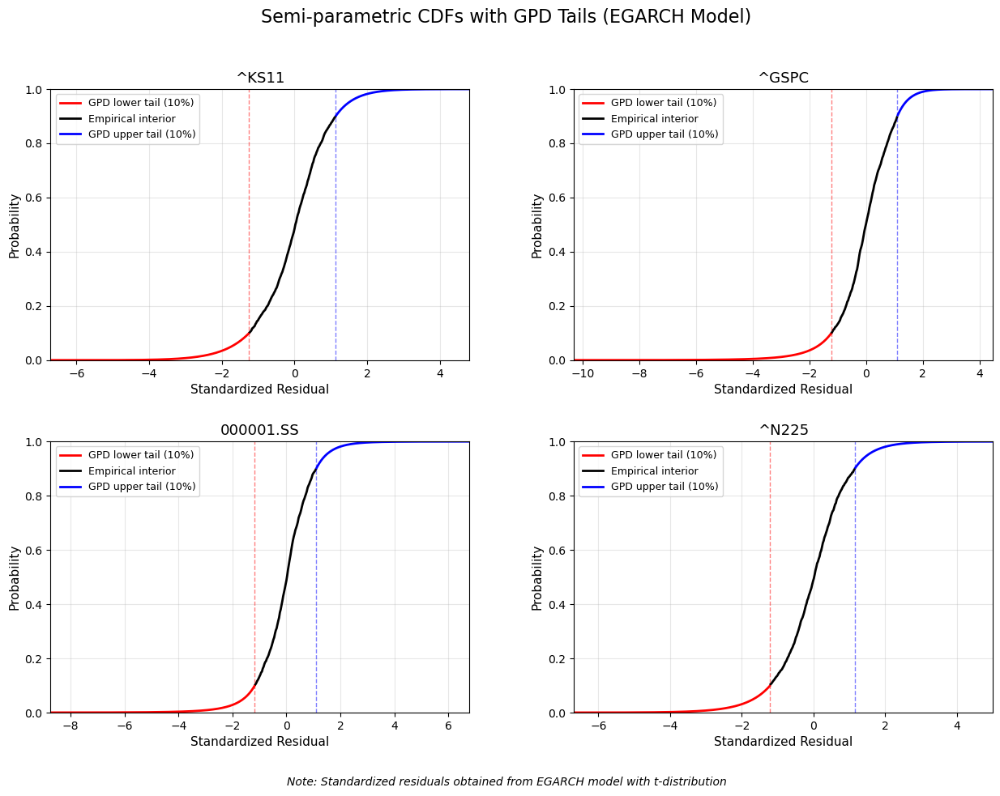


EVT Model Summary (EGARCH-filtered residuals)

^KS11:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): -0.0487, Scale (σ): 0.7235
  Upper GPD - Shape (ξ): -0.0341, Scale (σ): 0.5195
  Thresholds - Lower: -1.2495, Upper: 1.1325
  Tail observations - Lower: 189, Upper: 189

^GSPC:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.1609, Scale (σ): 0.6969
  Upper GPD - Shape (ξ): -0.0516, Scale (σ): 0.4116
  Thresholds - Lower: -1.2216, Upper: 1.1047
  Tail observations - Lower: 189, Upper: 189

000001.SS:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.2099, Scale (σ): 0.5716
  Upper GPD - Shape (ξ): 0.0725, Scale (σ): 0.5019
  Thresholds - Lower: -1.1731, Upper: 1.1076
  Tail observations - Lower: 189, Upper: 189

^N225:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.0436, Scale (σ): 0.6587
  Upper GPD - Shape (ξ): 0.0190, Scale (σ): 0.5095
  Thresholds - Lower: -1.2068, Upper: 1.1536
  Tail observations - L

In [8]:
TAIL_FRACTIONS = {
    '^KS11': {'lower': 0.10, 'upper': 0.10},    # 코스피
    '^GSPC': {'lower': 0.10, 'upper': 0.10},    # S&P 500
    '000001.SS': {'lower': 0.10, 'upper': 0.10}, # SSE Composite
    '^N225': {'lower': 0.10, 'upper': 0.10}     # Nikkei 225
}
evt_models, uniform_data = plot_evt_cdfs_by_model(
    egarch_residuals, 
    model_type='EGARCH',
    tail_fractions=TAIL_FRACTIONS  # 자산별 꼬리 비율 전달
)

C:\Users\rwe20\AppData\Local\Temp\ipykernel_27016\2386104073.py:108: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


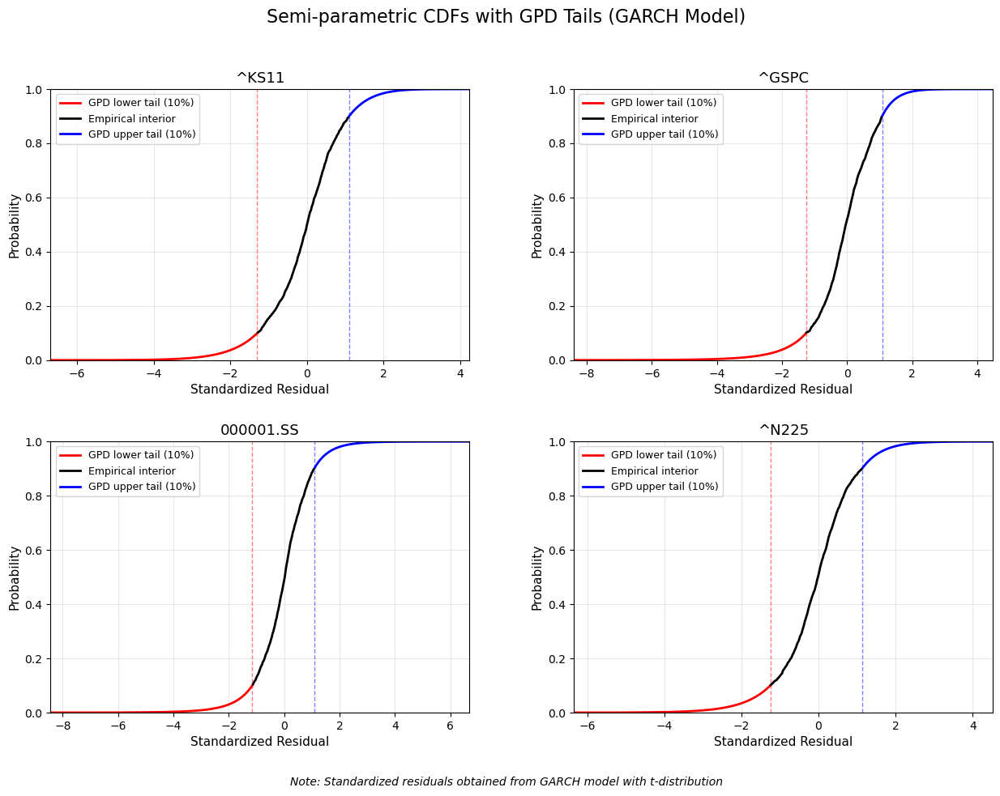


EVT Model Summary (GARCH-filtered residuals)

^KS11:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): -0.0349, Scale (σ): 0.7185
  Upper GPD - Shape (ξ): -0.1345, Scale (σ): 0.5418
  Thresholds - Lower: -1.2947, Upper: 1.1010
  Tail observations - Lower: 189, Upper: 189

^GSPC:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.0958, Scale (σ): 0.7431
  Upper GPD - Shape (ξ): -0.0682, Scale (σ): 0.4155
  Thresholds - Lower: -1.2559, Upper: 1.0796
  Tail observations - Lower: 189, Upper: 189

000001.SS:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.1170, Scale (σ): 0.6540
  Upper GPD - Shape (ξ): 0.0342, Scale (σ): 0.5477
  Thresholds - Lower: -1.1536, Upper: 1.0859
  Tail observations - Lower: 189, Upper: 189

^N225:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): -0.0004, Scale (σ): 0.6998
  Upper GPD - Shape (ξ): -0.0432, Scale (σ): 0.5126
  Thresholds - Lower: -1.2509, Upper: 1.1314
  Tail observations - 

In [9]:
evt_models, uniform_data = plot_evt_cdfs_by_model(
    garch_residuals, 
    model_type='GARCH',
    tail_fractions=TAIL_FRACTIONS  # 자산별 꼬리 비율 전달
)

C:\Users\rwe20\AppData\Local\Temp\ipykernel_27016\2386104073.py:108: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


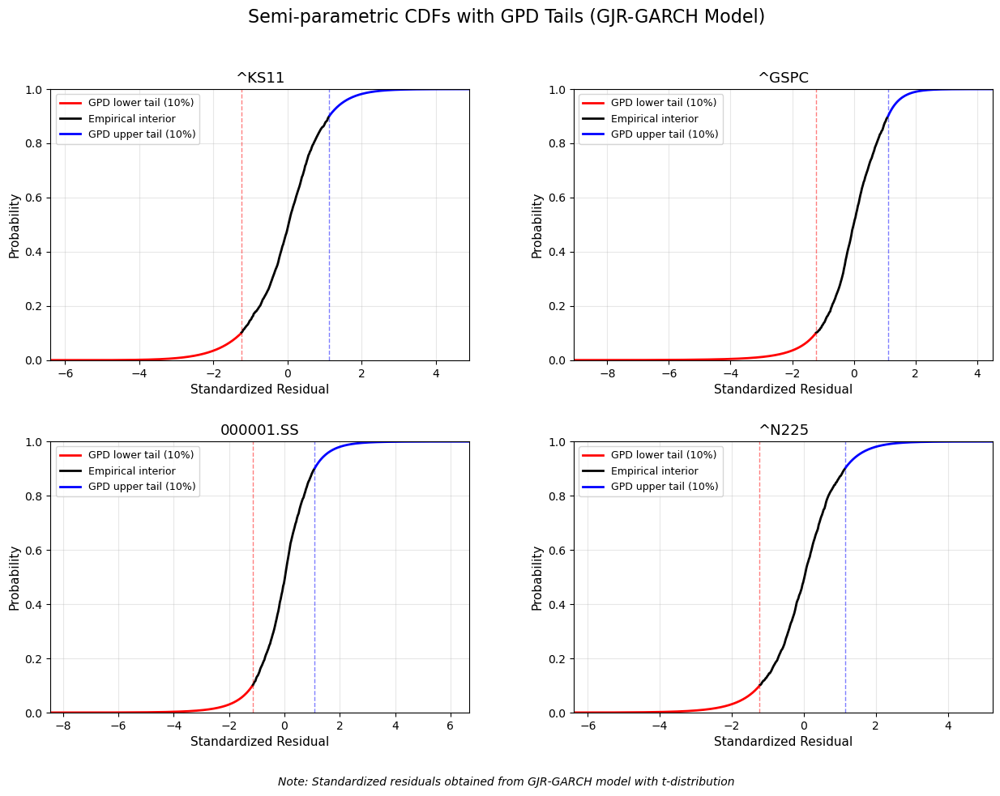


EVT Model Summary (GJR-GARCH-filtered residuals)

^KS11:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): -0.0730, Scale (σ): 0.7449
  Upper GPD - Shape (ξ): -0.0362, Scale (σ): 0.5283
  Thresholds - Lower: -1.2483, Upper: 1.1204
  Tail observations - Lower: 189, Upper: 189

^GSPC:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.1635, Scale (σ): 0.6837
  Upper GPD - Shape (ξ): -0.0156, Scale (σ): 0.3949
  Thresholds - Lower: -1.2330, Upper: 1.1076
  Tail observations - Lower: 189, Upper: 189

000001.SS:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.1195, Scale (σ): 0.6513
  Upper GPD - Shape (ξ): 0.0349, Scale (σ): 0.5462
  Thresholds - Lower: -1.1550, Upper: 1.0867
  Tail observations - Lower: 189, Upper: 189

^N225:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.0711, Scale (σ): 0.6331
  Upper GPD - Shape (ξ): -0.0275, Scale (σ): 0.5372
  Thresholds - Lower: -1.2278, Upper: 1.1391
  Tail observations

In [10]:
evt_models, uniform_data = plot_evt_cdfs_by_model(
    gjr_residuals, 
    model_type='GJR-GARCH',
    tail_fractions=TAIL_FRACTIONS  # 자산별 꼬리 비율 전달
)

In [11]:
def fast_gpd_pvalue(exceedances, gpd_params, n_sim=500):
    """
    Fast GPD goodness-of-fit test using Cramér-von Mises and Anderson-Darling statistics
    """
    from scipy import stats
    
    # GPD parameters
    xi, _, sigma = gpd_params  # shape, location (0), scale
    
    # Transform to uniform using GPD CDF
    n = len(exceedances)
    u_empirical = np.zeros(n)
    
    for i, x in enumerate(exceedances):
        if xi != 0:
            u_empirical[i] = 1 - (1 + xi * x / sigma) ** (-1/xi)
        else:
            u_empirical[i] = 1 - np.exp(-x / sigma)
    
    # Sort for test statistics
    u_sorted = np.sort(u_empirical)
    
    # Cramér-von Mises statistic
    W2 = 0
    for i in range(n):
        W2 += (u_sorted[i] - (2*i + 1)/(2*n))**2
    W2 = W2 + 1/(12*n)
    
    # Anderson-Darling statistic
    A2 = -n
    for i in range(n):
        if u_sorted[i] > 0 and u_sorted[i] < 1:
            A2 -= (2*i + 1)/n * (np.log(u_sorted[i]) + np.log(1 - u_sorted[n-1-i]))
    
    # Bootstrap p-values
    W2_sim = np.zeros(n_sim)
    A2_sim = np.zeros(n_sim)
    
    for sim in range(n_sim):
        # Generate GPD samples
        if xi != 0:
            u_sim = np.random.uniform(0, 1, n)
            x_sim = sigma/xi * ((1-u_sim)**(-xi) - 1)
        else:
            x_sim = stats.expon.rvs(scale=sigma, size=n)
        
        # Fit GPD to simulated data
        from scipy.stats import genpareto
        xi_sim, _, sigma_sim = genpareto.fit(x_sim, floc=0)
        
        # Transform to uniform
        u_sim_sorted = np.sort(genpareto.cdf(x_sim, xi_sim, scale=sigma_sim))
        
        # Calculate test statistics
        W2_temp = 0
        for i in range(n):
            W2_temp += (u_sim_sorted[i] - (2*i + 1)/(2*n))**2
        W2_sim[sim] = W2_temp + 1/(12*n)
        
        A2_temp = -n
        for i in range(n):
            if u_sim_sorted[i] > 0 and u_sim_sorted[i] < 1:
                A2_temp -= (2*i + 1)/n * (np.log(u_sim_sorted[i]) + np.log(1 - u_sim_sorted[n-1-i]))
        A2_sim[sim] = A2_temp
    
    # Calculate p-values
    W2_pvalue = np.mean(W2_sim > W2)
    A2_pvalue = np.mean(A2_sim > A2)
    
    return {
        'W2': W2,
        'W2_pvalue': W2_pvalue,
        'A2': A2,
        'A2_pvalue': A2_pvalue
    }

def gpd_goodness_of_fit_by_model(residuals_dict, model_type='EGARCH', 
                                 tail_fractions=None, n_sim=500):
    """
    GPD goodness-of-fit test with asset-specific tail fractions
    """
    # 기본값 설정
    if tail_fractions is None:
        tail_fractions = {asset: {'lower': 0.1, 'upper': 0.1} 
                         for asset in residuals_dict.keys()}
    
    results = []
    
    print(f"\nGPD Goodness-of-Fit Tests for {model_type} Model")
    print("="*80)
    
    for asset_name, residuals in residuals_dict.items():
        if residuals is None:
            continue
            
        print(f"\nProcessing {asset_name}...")
        
        # Handle input data
        data = np.array(residuals)
        if data.ndim > 1:
            data = data[:, 0]
        
        # 자산별 꼬리 비율 가져오기
        asset_tail_fractions = tail_fractions.get(asset_name, {'lower': 0.1, 'upper': 0.1})
        
        # Create EVT model with asset-specific tail fractions
        evt_model = ParetoTailsEVT(
            data, 
            tail_fraction_up=asset_tail_fractions['upper'],
            tail_fraction_down=asset_tail_fractions['lower']
        )
        
        # Test lower tail
        lower_tail_data = data[data < evt_model.lower_threshold]
        lower_exceedances = evt_model.lower_threshold - lower_tail_data
        
        if len(lower_exceedances) > 20:
            lower_test = fast_gpd_pvalue(lower_exceedances, evt_model.lower_gpd, n_sim)
            lower_result = {
                'Asset': asset_name,
                'Model': model_type,
                'Tail': 'Lower',
                'Tail_fraction': asset_tail_fractions['lower'],
                'n_exceedances': len(lower_exceedances),
                'Shape': evt_model.lower_gpd[0],
                'Scale': evt_model.lower_gpd[2],
                'W2_stat': lower_test['W2'],
                'W2_pvalue': lower_test['W2_pvalue'],
                'A2_stat': lower_test['A2'],
                'A2_pvalue': lower_test['A2_pvalue']
            }
            results.append(lower_result)
        
        # Test upper tail
        upper_tail_data = data[data > evt_model.upper_threshold]
        upper_exceedances = upper_tail_data - evt_model.upper_threshold
        
        if len(upper_exceedances) > 20:
            upper_test = fast_gpd_pvalue(upper_exceedances, evt_model.upper_gpd, n_sim)
            upper_result = {
                'Asset': asset_name,
                'Model': model_type,
                'Tail': 'Upper',
                'Tail_fraction': asset_tail_fractions['upper'],
                'n_exceedances': len(upper_exceedances),
                'Shape': evt_model.upper_gpd[0],
                'Scale': evt_model.upper_gpd[2],
                'W2_stat': upper_test['W2'],
                'W2_pvalue': upper_test['W2_pvalue'],
                'A2_stat': upper_test['A2'],
                'A2_pvalue': upper_test['A2_pvalue']
            }
            results.append(upper_result)
    
    # Create DataFrame
    results_df = pd.DataFrame(results)
    
    # Format for display
    display_df = results_df.round(4)
    
    # Print summary
    print(f"\n{model_type} Model - GPD Goodness-of-Fit Summary:")
    print("-"*80)
    print(display_df.to_string(index=False))
    
    # Summary statistics
    print(f"\n{model_type} Model - Test Summary:")
    print(f"Total tests performed: {len(results_df)}")
    print(f"W2 tests passed (p > 0.05): {sum(results_df['W2_pvalue'] > 0.05)} / {len(results_df)}")
    print(f"A2 tests passed (p > 0.05): {sum(results_df['A2_pvalue'] > 0.05)} / {len(results_df)}")
    
    # 자산별 꼬리 비율 정보 출력
    print(f"\nTail Fractions Used:")
    for asset in residuals_dict.keys():
        fractions = tail_fractions.get(asset, {'lower': 0.1, 'upper': 0.1})
        print(f"  {asset}: Lower {fractions['lower']*100:.0f}%, Upper {fractions['upper']*100:.0f}%")
    
    return results_df



# EGARCH 모델 테스트 (같은 꼬리 비율 사용)
egarch_gof = gpd_goodness_of_fit_by_model(
    egarch_residuals, 
    model_type='EGARCH', 
    tail_fractions=TAIL_FRACTIONS,
    n_sim=500
)

# GARCH 모델 테스트
garch_gof = gpd_goodness_of_fit_by_model(
    garch_residuals, 
    model_type='GARCH', 
    tail_fractions=TAIL_FRACTIONS,
    n_sim=500
)

# GJR-GARCH 모델 테스트
gjr_gof = gpd_goodness_of_fit_by_model(
    gjr_residuals, 
    model_type='GJR-GARCH', 
    tail_fractions=TAIL_FRACTIONS,
    n_sim=500
)

# 모든 결과를 하나의 DataFrame으로 합치기
all_gof_results = pd.concat([egarch_gof, garch_gof, gjr_gof], ignore_index=True)

# LaTeX 테이블로 변환 (논문용) - 꼬리 비율 정보 포함
def create_gof_latex_table_with_fractions(all_results):
    """Create LaTeX table for goodness-of-fit results with tail fractions"""
    
    # Pivot table for better presentation
    pivot_df = all_results.pivot_table(
        index=['Asset', 'Tail', 'Tail_fraction'],
        columns='Model',
        values=['W2_pvalue', 'A2_pvalue'],
        aggfunc='first'
    )
    
    print("\nLaTeX Table for Goodness-of-Fit Results:")
    print(pivot_df.to_latex(float_format='%.3f'))
    
    return pivot_df

latex_table = create_gof_latex_table_with_fractions(all_gof_results)


GPD Goodness-of-Fit Tests for EGARCH Model

Processing ^KS11...

Processing ^GSPC...

Processing 000001.SS...


KeyboardInterrupt: 

In [ ]:
def plot_gpd_tail_fits_by_model(residuals_dict, model_type='EGARCH', tail_fractions=None, save_path='./'):
    """
    Plot GPD tail fits for all assets using residuals from a specific model
    
    Parameters:
    -----------
    residuals_dict : dict
        Dictionary of standardized residuals for each asset
    model_type : str
        Type of model ('EGARCH', 'GARCH', 'GJR-GARCH', 'SV-QML')
    tail_fractions : dict
        Dictionary with asset-specific tail fractions
    save_path : str
        Directory path to save figures
    """
    
    # 기본값 설정
    if tail_fractions is None:
        tail_fractions = {asset: {'lower': 0.1, 'upper': 0.1} 
                         for asset in residuals_dict.keys()}
    
    # Create EVT models for all assets
    evt_models = {}
    for asset_name, residuals in residuals_dict.items():
        if residuals is None:
            continue
        
        # Handle input data
        data = np.array(residuals)
        if data.ndim > 1:
            data = data[:, 0]
        
        # 자산별 꼬리 비율 가져오기
        asset_tail_fractions = tail_fractions.get(asset_name, {'lower': 0.1, 'upper': 0.1})
        
        # Create EVT model with asset-specific tail fractions
        evt_models[asset_name] = ParetoTailsEVT(
            data, 
            tail_fraction_up=asset_tail_fractions['upper'],
            tail_fraction_down=asset_tail_fractions['lower']
        )
    
    # Create figure with subplots for all assets
    n_assets = len(evt_models)
    fig, axes = plt.subplots(n_assets, 2, figsize=(15, 5*n_assets))
    
    if n_assets == 1:
        axes = axes.reshape(1, -1)
    
    fig.suptitle(f'GPD Tail Fits - {model_type} Model', fontsize=16)
    
    for idx, (asset_name, evt_obj) in enumerate(evt_models.items()):
        # Get asset-specific tail fractions
        asset_fractions = tail_fractions.get(asset_name, {'lower': 0.1, 'upper': 0.1})
        
        # Upper tail
        ax_upper = axes[idx, 0]
        upper_exceedances = evt_obj.data[evt_obj.data > evt_obj.upper_threshold] - evt_obj.upper_threshold
        
        if len(upper_exceedances) > 0:
            # Empirical CDF
            sorted_exc = np.sort(upper_exceedances)
            n = len(sorted_exc)
            emp_cdf = np.arange(1, n + 1) / n
            
            # Fitted GPD
            x_gpd = np.linspace(0, sorted_exc.max() * 1.2, 200)
            gpd_cdf = genpareto.cdf(x_gpd, *evt_obj.upper_gpd)
            
            # Plot
            ax_upper.step(sorted_exc, emp_cdf, 'r-', where='post', linewidth=2, 
                         label='Empirical CDF')
            ax_upper.plot(x_gpd, gpd_cdf, 'b-', linewidth=2, 
                         label='Fitted GPD')
            
            ax_upper.set_xlabel('Exceedance', fontsize=11)
            ax_upper.set_ylabel('Probability', fontsize=11)
            ax_upper.set_title(f'{asset_name} - Upper Tail ({asset_fractions["upper"]*100:.0f}%)', 
                              fontsize=12)
            ax_upper.legend(loc='lower right', fontsize=10)
            ax_upper.grid(True, alpha=0.3)
            
            # Add text with parameters
            ax_upper.text(0.5, 0.2, f'Shape (ξ): {evt_obj.upper_gpd[0]:.4f}\n'
                                   f'Scale (σ): {evt_obj.upper_gpd[2]:.4f}\n'
                                   f'N exceedances: {len(upper_exceedances)}\n'
                                   f'Tail fraction: {asset_fractions["upper"]*100:.0f}%',
                         transform=ax_upper.transAxes,
                         bbox=dict(boxstyle='round', facecolor='white', alpha=0.8),
                         fontsize=9)
        
        # Lower tail
        ax_lower = axes[idx, 1]
        lower_exceedances = evt_obj.lower_threshold - evt_obj.data[evt_obj.data < evt_obj.lower_threshold]
        
        if len(lower_exceedances) > 0:
            # Empirical CDF
            sorted_exc = np.sort(lower_exceedances)
            n = len(sorted_exc)
            emp_cdf = np.arange(1, n + 1) / n
            
            # Fitted GPD
            x_gpd = np.linspace(0, sorted_exc.max() * 1.2, 200)
            gpd_cdf = genpareto.cdf(x_gpd, *evt_obj.lower_gpd)
            
            # Plot
            ax_lower.step(sorted_exc, emp_cdf, 'r-', where='post', linewidth=2,
                         label='Empirical CDF')
            ax_lower.plot(x_gpd, gpd_cdf, 'b-', linewidth=2,
                         label='Fitted GPD')
            
            ax_lower.set_xlabel('Exceedance', fontsize=11)
            ax_lower.set_ylabel('Probability', fontsize=11)
            ax_lower.set_title(f'{asset_name} - Lower Tail ({asset_fractions["lower"]*100:.0f}%)', 
                              fontsize=12)
            ax_lower.legend(loc='lower right', fontsize=10)
            ax_lower.grid(True, alpha=0.3)
            
            # Add text with parameters
            ax_lower.text(0.5, 0.2, f'Shape (ξ): {evt_obj.lower_gpd[0]:.4f}\n'
                                   f'Scale (σ): {evt_obj.lower_gpd[2]:.4f}\n'
                                   f'N exceedances: {len(lower_exceedances)}\n'
                                   f'Tail fraction: {asset_fractions["lower"]*100:.0f}%',
                         transform=ax_lower.transAxes,
                         bbox=dict(boxstyle='round', facecolor='white', alpha=0.8),
                         fontsize=9)
    
    plt.tight_layout()
    
    # 모델별로 다른 파일명으로 저장
    model_name_clean = model_type.lower().replace("-", "_").replace(" ", "_")
    
    # 파일명 딕셔너리 (원하는 파일명으로 커스터마이징 가능)
    filename_dict = {
        'egarch': 'gpd_tail_fits_egarch.png',
        'garch': 'gpd_tail_fits_garch.png',
        'gjr_garch': 'gpd_tail_fits_gjr_garch.png',
        'sv_qml': 'gpd_tail_fits_sv_qml.png'
    }
    
    # 파일명 선택
    filename = filename_dict.get(model_name_clean, f'gpd_tail_fits_{model_name_clean}.png')
    
    # 전체 경로
    full_path = os.path.join(save_path, filename)
    
    # 저장
    plt.savefig(full_path, dpi=300, bbox_inches='tight')
    print(f"\nFigure saved as: {full_path}")
    
    plt.show()
    
    # Print summary
    print(f"\nAsymmetric Tail Fractions Used for {model_type}:")
    for asset, fractions in tail_fractions.items():
        print(f"  {asset}: Lower {fractions['lower']*100:.0f}%, Upper {fractions['upper']*100:.0f}%")
    
    return evt_models


# 필요한 import 추가
import os

# 저장 경로 설정 (필요시 변경)
save_directory = './gpd_plots/'

# 디렉토리가 없으면 생성
if not os.path.exists(save_directory):
    os.makedirs(save_directory)

# 각 모델 실행
# EGARCH 모델
egarch_evt = plot_gpd_tail_fits_by_model(
    egarch_residuals, 
    model_type='EGARCH', 
    tail_fractions=TAIL_FRACTIONS,
    save_path=save_directory
)

# GARCH 모델
garch_evt = plot_gpd_tail_fits_by_model(
    garch_residuals, 
    model_type='GARCH', 
    tail_fractions=TAIL_FRACTIONS,
    save_path=save_directory
)

# GJR-GARCH 모델
gjr_evt = plot_gpd_tail_fits_by_model(
    gjr_residuals, 
    model_type='GJR-GARCH', 
    tail_fractions=TAIL_FRACTIONS,
    save_path=save_directory
)

# SV 모델 (필요시 주석 해제)
# sv_evt = plot_gpd_tail_fits_by_model(
#     sv_residuals, 
#     model_type='SV-QML', 
#     tail_fractions=TAIL_FRACTIONS,
#     save_path=save_directory
# )




Fitting D-Vine Copula for EGARCH Model

Fitting EGARCH-t-EVT-DVine Copula...
Number of observations: 1887
Assets: ['^KS11', '^GSPC', '000001.SS', '^N225']

Asymmetric Tail Fractions:
  ^KS11: Lower 10%, Upper 10%
  ^GSPC: Lower 10%, Upper 10%
  000001.SS: Lower 10%, Upper 10%
  ^N225: Lower 10%, Upper 10%
** Tree:  1
1,3  --->  Gumbel180 : parameters =  1.1233215774860084
2,0  --->  Gumbel180 : parameters =  1.255073758081272
0,3  --->  Student : parameters =  [0.5479406087120097, 7.31481790178298]
** Tree:  2
1,0|3  --->  Frank : parameters =  0.7101984760720204
2,3|0  --->  Gaussian : parameters =  0.12440899715816975
** Tree:  3
1,2|0,3  --->  Frank : parameters =  0.24850407950934283


<Figure size 1200x800 with 0 Axes>

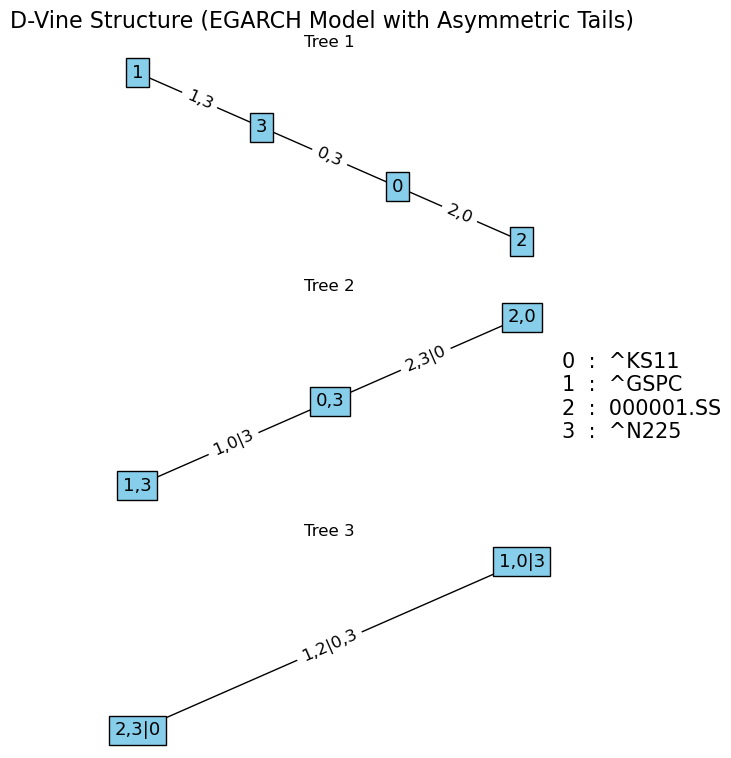

<Figure size 640x480 with 0 Axes>


D-Vine Copula Structure:
Structure Matrix M:
[[ 3.  0.  3.  3.]
 [ 0.  3.  0. nan]
 [ 2.  2. nan nan]
 [ 1. nan nan nan]]

Copula Families C:
[[ 4.  4. 15. nan]
 [10.  1. nan nan]
 [10. nan nan nan]
 [nan nan nan nan]]

Parameters P:
[[1.1233215774860084 1.255073758081272
  list([0.5479406087120097, 7.31481790178298]) nan]
 [0.7101984760720204 0.12440899715816975 nan nan]
 [0.24850407950934283 nan nan nan]
 [nan nan nan nan]]

Fitting D-Vine Copula for GARCH Model

Fitting GARCH-t-EVT-DVine Copula...
Number of observations: 1887
Assets: ['^KS11', '^GSPC', '000001.SS', '^N225']

Asymmetric Tail Fractions:
  ^KS11: Lower 10%, Upper 10%
  ^GSPC: Lower 10%, Upper 10%
  000001.SS: Lower 10%, Upper 10%
  ^N225: Lower 10%, Upper 10%
** Tree:  1
1,3  --->  Gumbel180 : parameters =  1.1311043030621097
2,0  --->  Gumbel180 : parameters =  1.2600272019280536
0,3  --->  Gumbel180 : parameters =  1.5789528385392058
** Tree:  2
1,0|3  --->  Frank : parameters =  0.7201366881093851
2,3|0  --->  Gaus

<Figure size 1200x800 with 0 Axes>

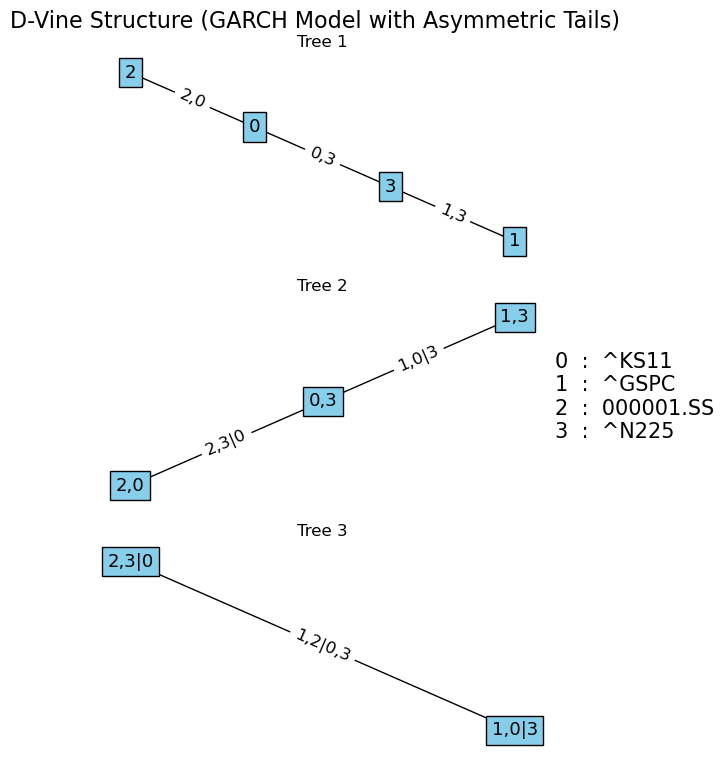

<Figure size 640x480 with 0 Axes>


D-Vine Copula Structure:
Structure Matrix M:
[[ 3.  0.  3.  3.]
 [ 0.  3.  0. nan]
 [ 2.  2. nan nan]
 [ 1. nan nan nan]]

Copula Families C:
[[ 4.  4.  4. nan]
 [10.  1. nan nan]
 [10. nan nan nan]
 [nan nan nan nan]]

Parameters P:
[[1.1311043030621097 1.2600272019280536 1.5789528385392058 nan]
 [0.7201366881093851 0.1243206913985665 nan nan]
 [0.22529808931457276 nan nan nan]
 [nan nan nan nan]]

Fitting C-Vine Copula for GJR-GARCH Model

Fitting GJR-GARCH-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['^KS11', '^GSPC', '000001.SS', '^N225']

Asymmetric Tail Fractions:
  ^KS11: Lower 10%, Upper 10%
  ^GSPC: Lower 10%, Upper 10%
  000001.SS: Lower 10%, Upper 10%
  ^N225: Lower 10%, Upper 10%
** Tree:  1
1,0  --->  Gumbel180 : parameters =  1.130667485841
2,0  --->  Gumbel180 : parameters =  1.2565040307126452
0,3  --->  Student : parameters =  [0.5469374230392327, 7.531116660979023]
** Tree:  2
1,3|0  --->  Gumbel180 : parameters =  1.0531451669679173
2,3|0  --->  Gauss

<Figure size 1200x800 with 0 Axes>

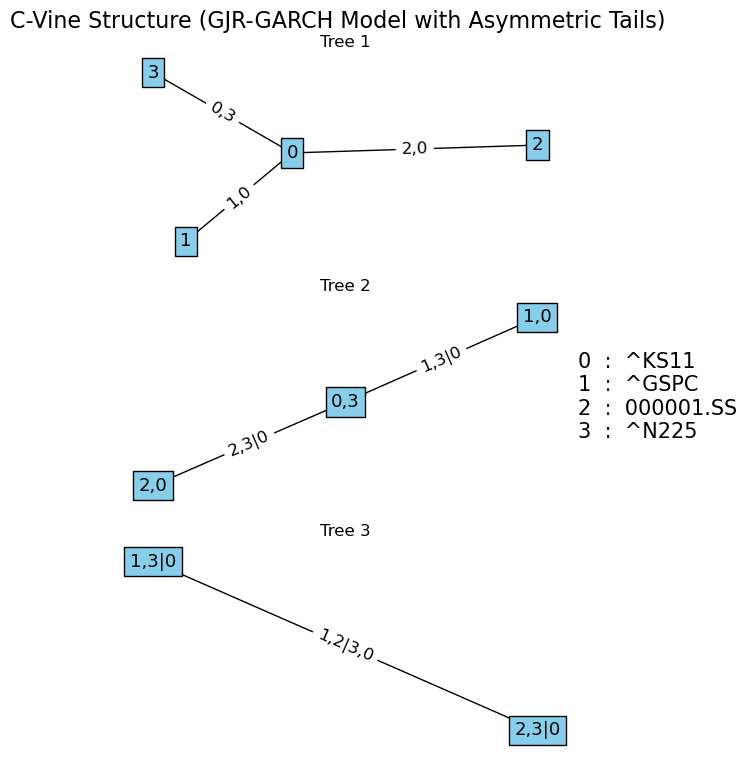

<Figure size 640x480 with 0 Axes>


C-Vine Copula Structure:
Structure Matrix M:
[[ 0.  0.  3.  3.]
 [ 3.  3.  0. nan]
 [ 2.  2. nan nan]
 [ 1. nan nan nan]]

Copula Families C:
[[ 4.  4. 15. nan]
 [ 4.  1. nan nan]
 [10. nan nan nan]
 [nan nan nan nan]]

Parameters P:
[[1.130667485841 1.2565040307126452
  list([0.5469374230392327, 7.531116660979023]) nan]
 [1.0531451669679173 0.12248320127707187 nan nan]
 [0.24775558307139425 nan nan nan]
 [nan nan nan nan]]


In [20]:
from vinecopulas.marginals import *
from vinecopulas.bivariate import *
from vinecopulas.vinecopula import *
def fit_vine_copula_by_model(residuals_dict, model_type='EGARCH', 
                            tail_fractions=None,  # 변경: 자산별 딕셔너리
                            vine_type='C', cops=None):
    
    # 기본값 설정
    if tail_fractions is None:
        tail_fractions = {asset: {'lower': 0.1, 'upper': 0.1} 
                         for asset in residuals_dict.keys()}
    
    if cops is None:
        cops = list(range(1, 16))
    
    print(f"\n{'='*60}")
    print(f"Fitting {vine_type}-Vine Copula for {model_type} Model")
    print(f"{'='*60}")
    
    # Create EVT models and transform to uniform
    evt_models = {}
    uniform_data_dict = {}
    
    for asset_name, residuals in residuals_dict.items():
        if residuals is None:
            continue
            
        # Handle input data
        data = np.array(residuals)
        if data.ndim > 1:
            data = data[:, 0]
        
        # 자산별 꼬리 비율 가져오기
        asset_tail_fractions = tail_fractions.get(asset_name, {'lower': 0.1, 'upper': 0.1})
        
        # Create EVT model with asset-specific tail fractions
        evt_obj = ParetoTailsEVT(
            data, 
            tail_fraction_up=asset_tail_fractions['upper'],
            tail_fraction_down=asset_tail_fractions['lower']
        )
        evt_models[asset_name] = evt_obj
        
        # Transform to uniform
        uniform_data = evt_obj.cdf(data)
        uniform_data_dict[asset_name] = uniform_data
    
    # Create DataFrame
    uniform_evt = pd.DataFrame(uniform_data_dict)
    
    # Convert to numpy array for vinecopulas
    u_data = uniform_evt.values
    
    # Fit vine copula
    print(f"\nFitting {model_type}-t-EVT-{vine_type}Vine Copula...")
    print(f"Number of observations: {len(u_data)}")
    print(f"Assets: {list(uniform_evt.columns)}")
    
    # Print tail fractions used
    print(f"\nAsymmetric Tail Fractions:")
    for asset, fractions in tail_fractions.items():
        print(f"  {asset}: Lower {fractions['lower']*100:.0f}%, Upper {fractions['upper']*100:.0f}%")
    
    M, P, C = fit_vinecop(u_data, cops, vine=vine_type)
    
    # Visualize vine structure
    plt.figure(figsize=(12, 8))
    plotvine(M, variables=list(uniform_evt.columns), 
            plottitle=f'{vine_type}-Vine Structure ({model_type} Model with Asymmetric Tails)')
    plt.tight_layout()
    plt.show()
    
    # Print copula information
    print(f"\n{vine_type}-Vine Copula Structure:")
    print(f"Structure Matrix M:\n{M}")
    print(f"\nCopula Families C:\n{C}")
    print(f"\nParameters P:\n{P}")
    
    return M, P, C, uniform_evt, evt_models


# 2. EGARCH 모델에 대한 C-Vine
M_egarch, P_egarch, C_egarch, uniform_egarch, evt_models_egarch = fit_vine_copula_by_model(
    egarch_residuals, 
    model_type='EGARCH',
    tail_fractions=TAIL_FRACTIONS,
    vine_type='D'
)

# 3. GARCH 모델에 대한 C-Vine
M_garch, P_garch, C_garch, uniform_garch, evt_models_garch = fit_vine_copula_by_model(
    garch_residuals, 
    model_type='GARCH',
    tail_fractions=TAIL_FRACTIONS,
    vine_type='D'
)

# 4. GJR-GARCH 모델에 대한 C-Vine
M_gjr, P_gjr, C_gjr, uniform_gjr, evt_models_gjr = fit_vine_copula_by_model(
    gjr_residuals, 
    model_type='GJR-GARCH',
    tail_fractions=TAIL_FRACTIONS,
    vine_type='C'
)



Fitting D-Vine Copula for EGARCH Model

Fitting EGARCH-t-EVT-DVine Copula...
Number of observations: 1887
Assets: ['^KS11', '^GSPC', '000001.SS', '^N225']

Asymmetric Tail Fractions:
  ^KS11: Lower 10%, Upper 10%
  ^GSPC: Lower 10%, Upper 10%
  000001.SS: Lower 10%, Upper 10%
  ^N225: Lower 10%, Upper 10%
** Tree:  1
1,3  --->  Gumbel180 : parameters =  1.1233215774860084
2,0  --->  Gumbel180 : parameters =  1.255073758081272
0,3  --->  Student : parameters =  [0.5479406087120097, 7.31481790178298]
** Tree:  2
1,0|3  --->  Frank : parameters =  0.7101984760720204
2,3|0  --->  Gaussian : parameters =  0.12440899715816975
** Tree:  3
1,2|0,3  --->  Frank : parameters =  0.24850407950934283


<Figure size 1200x800 with 0 Axes>

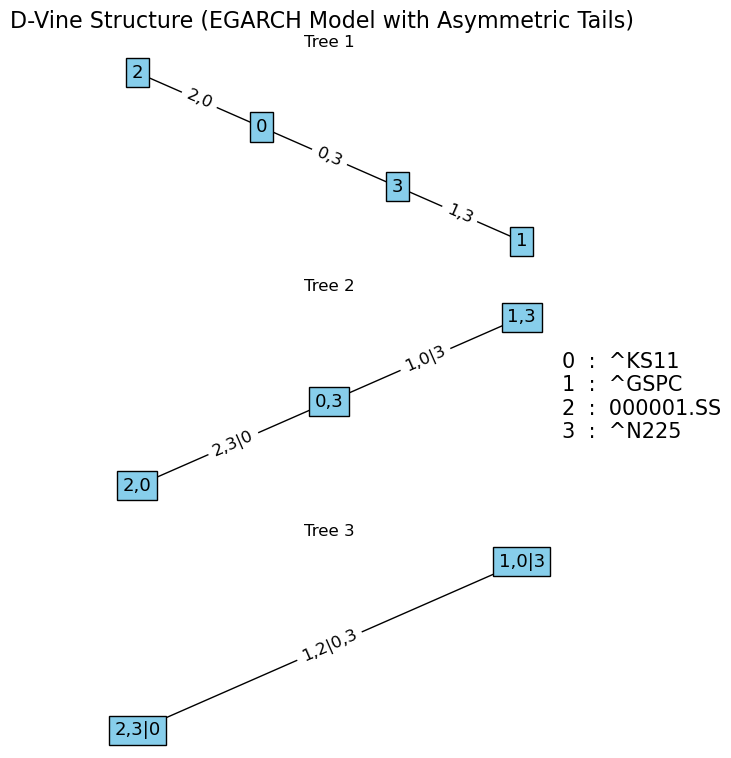

<Figure size 640x480 with 0 Axes>


D-Vine Copula Structure:
Structure Matrix M:
[[ 3.  0.  3.  3.]
 [ 0.  3.  0. nan]
 [ 2.  2. nan nan]
 [ 1. nan nan nan]]

Copula Families C:
[[ 4.  4. 15. nan]
 [10.  1. nan nan]
 [10. nan nan nan]
 [nan nan nan nan]]

Parameters P:
[[1.1233215774860084 1.255073758081272
  list([0.5479406087120097, 7.31481790178298]) nan]
 [0.7101984760720204 0.12440899715816975 nan nan]
 [0.24850407950934283 nan nan nan]
 [nan nan nan nan]]


In [89]:
# D-Vine fitting (모든 인접 쌍을 보여줌)
M_d_egarch, P_d_egarch, C_d_egarch, _, _ = fit_vine_copula_by_model(
    egarch_residuals, 
    model_type='EGARCH',
    tail_fractions=TAIL_FRACTIONS,
    vine_type='D'  # D-vine으로 변경
)


Fitting C-Vine Copula for EGARCH Model
Center Asset: ^GSPC
Asset order: ['^GSPC', '^KS11', '000001.SS', '^N225']

Fitting EGARCH-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['^GSPC', '^KS11', '000001.SS', '^N225']
** Tree:  1
0,1  --->  Gumbel180 : parameters =  1.1333728958414633
2,1  --->  Gumbel180 : parameters =  1.255073758081272
1,3  --->  Student : parameters =  [0.5479406087120097, 7.31481790178298]
** Tree:  2
0,3|1  --->  Gumbel180 : parameters =  1.0535639362427538
2,3|1  --->  Gaussian : parameters =  0.12440899715816975
** Tree:  3
0,2|3,1  --->  Frank : parameters =  0.2647728350444306


<Figure size 1200x800 with 0 Axes>

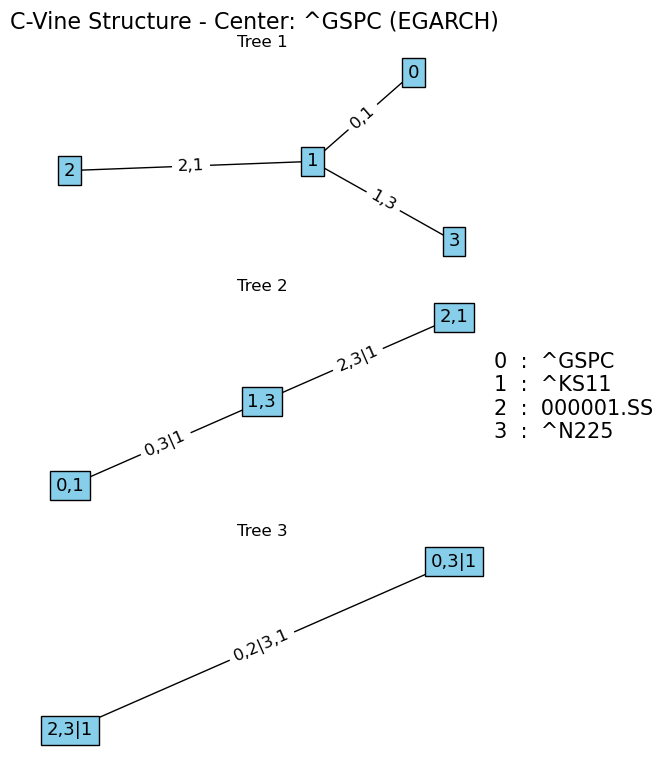

<Figure size 640x480 with 0 Axes>


Fitting C-Vine Copula for EGARCH Model
Center Asset: ^N225
Asset order: ['^N225', '^KS11', '^GSPC', '000001.SS']

Fitting EGARCH-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['^N225', '^KS11', '^GSPC', '000001.SS']
** Tree:  1
2,1  --->  Gumbel180 : parameters =  1.1333728958414633
0,1  --->  Student : parameters =  [0.5479406087120097, 7.31481790178298]
1,3  --->  Gumbel180 : parameters =  1.255073758081272
** Tree:  2
2,0|1  --->  Gumbel180 : parameters =  1.0535639362427538
0,3|1  --->  Gaussian : parameters =  0.12440899715816975
** Tree:  3
2,3|0,1  --->  Frank : parameters =  0.2647728350444306


<Figure size 1200x800 with 0 Axes>

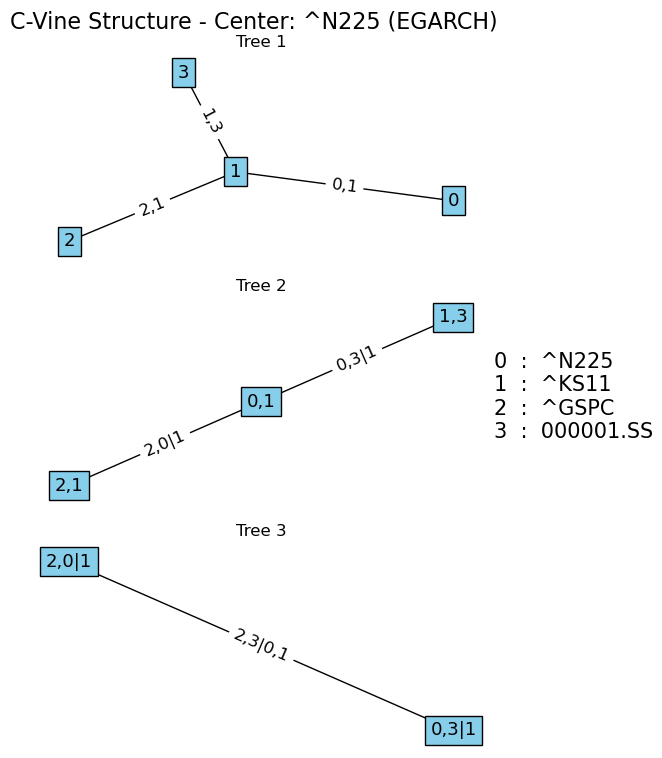

<Figure size 640x480 with 0 Axes>


Fitting C-Vine Copula for EGARCH Model
Center Asset: 000001.SS
Asset order: ['000001.SS', '^KS11', '^GSPC', '^N225']

Fitting EGARCH-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['000001.SS', '^KS11', '^GSPC', '^N225']
** Tree:  1
0,1  --->  Gumbel180 : parameters =  1.255073758081272
2,1  --->  Gumbel180 : parameters =  1.1333728958414633
1,3  --->  Student : parameters =  [0.5479406087120097, 7.31481790178298]
** Tree:  2
0,3|1  --->  Gaussian : parameters =  0.12440899715816975
2,3|1  --->  Gumbel180 : parameters =  1.0535639362427538
** Tree:  3
0,2|3,1  --->  Frank : parameters =  0.2647728350444306


<Figure size 1200x800 with 0 Axes>

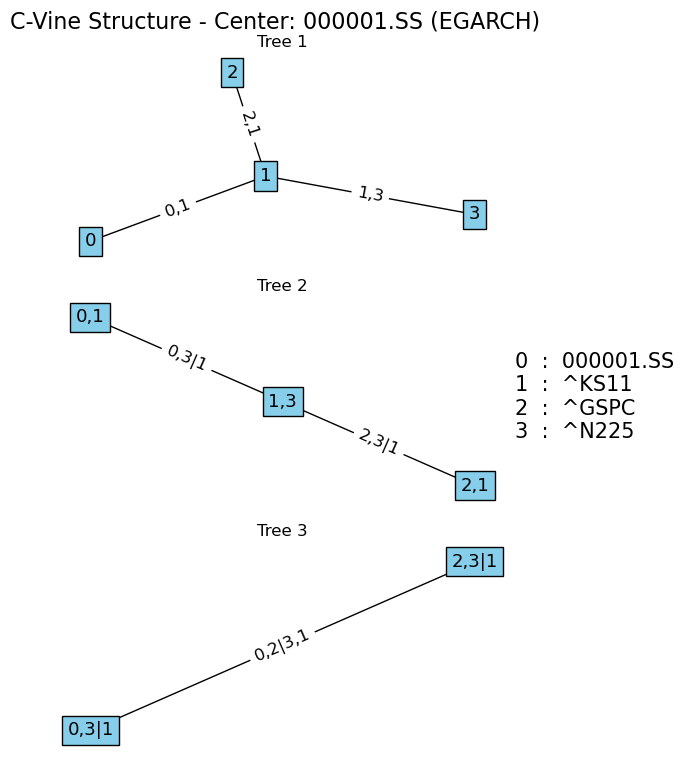

<Figure size 640x480 with 0 Axes>

In [17]:
def fit_vine_copula_with_center(residuals_dict, model_type='EGARCH', 
                                center_asset='^GSPC',  # 중심 자산 지정
                                tail_fractions=None, 
                                vine_type='C', cops=None):
    
    # 기본값 설정
    if tail_fractions is None:
        tail_fractions = {asset: {'lower': 0.1, 'upper': 0.1} 
                         for asset in residuals_dict.keys()}
    
    if cops is None:
        cops = list(range(1, 16))
    
    print(f"\n{'='*60}")
    print(f"Fitting {vine_type}-Vine Copula for {model_type} Model")
    print(f"Center Asset: {center_asset}")
    print(f"{'='*60}")
    
    # Create EVT models and transform to uniform
    evt_models = {}
    uniform_data_dict = {}
    
    # 자산 순서 재배열 - center_asset을 첫 번째로
    asset_names = list(residuals_dict.keys())
    if center_asset in asset_names:
        asset_names.remove(center_asset)
        asset_names = [center_asset] + asset_names  # center를 맨 앞으로
    
    print(f"Asset order: {asset_names}")
    
    for asset_name in asset_names:  # 재배열된 순서로 처리
        residuals = residuals_dict[asset_name]
        if residuals is None:
            continue
            
        # Handle input data
        data = np.array(residuals)
        if data.ndim > 1:
            data = data[:, 0]
        
        # 자산별 꼬리 비율 가져오기
        asset_tail_fractions = tail_fractions.get(asset_name, {'lower': 0.1, 'upper': 0.1})
        
        # Create EVT model
        evt_obj = ParetoTailsEVT(
            data, 
            tail_fraction_up=asset_tail_fractions['upper'],
            tail_fraction_down=asset_tail_fractions['lower']
        )
        evt_models[asset_name] = evt_obj
        
        # Transform to uniform
        uniform_data = evt_obj.cdf(data)
        uniform_data_dict[asset_name] = uniform_data
    
    # Create DataFrame with reordered columns
    uniform_evt = pd.DataFrame(uniform_data_dict)[asset_names]
    
    # Convert to numpy array for vinecopulas
    u_data = uniform_evt.values
    
    # Fit vine copula
    print(f"\nFitting {model_type}-t-EVT-{vine_type}Vine Copula...")
    print(f"Number of observations: {len(u_data)}")
    print(f"Assets: {list(uniform_evt.columns)}")
    
    M, P, C = fit_vinecop(u_data, cops, vine=vine_type)
    
    # Visualize vine structure
    plt.figure(figsize=(12, 8))
    plotvine(M, variables=list(uniform_evt.columns), 
            plottitle=f'{vine_type}-Vine Structure - Center: {center_asset} ({model_type})')
    plt.tight_layout()
    plt.show()
    
    return M, P, C, uniform_evt, evt_models

# 예시: S&P 500을 중심으로
M_sp500, P_sp500, C_sp500, uniform_sp500, evt_sp500 = fit_vine_copula_with_center(
    egarch_residuals, 
    model_type='EGARCH',
    center_asset='^GSPC',  # S&P 500을 중심으로
    tail_fractions=TAIL_FRACTIONS,
    vine_type='C'
)

# 예시: Nikkei를 중심으로
M_nikkei, P_nikkei, C_nikkei, uniform_nikkei, evt_nikkei = fit_vine_copula_with_center(
    egarch_residuals, 
    model_type='EGARCH',
    center_asset='^N225',  # Nikkei를 중심으로
    tail_fractions=TAIL_FRACTIONS,
    vine_type='C'
)

# 예시: SSE를 중심으로
M_sse, P_sse, C_sse, uniform_sse, evt_sse = fit_vine_copula_with_center(
    egarch_residuals, 
    model_type='EGARCH',
    center_asset='000001.SS',  # SSE를 중심으로
    tail_fractions=TAIL_FRACTIONS,
    vine_type='C'
)


Fitting C-Vine Copula for GARCH Model
Center Asset: ^GSPC
Asset order: ['^GSPC', '^KS11', '000001.SS', '^N225']

Fitting GARCH-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['^GSPC', '^KS11', '000001.SS', '^N225']
** Tree:  1
0,1  --->  Gumbel180 : parameters =  1.1344407474533673
2,1  --->  Gumbel180 : parameters =  1.2600272019280536
1,3  --->  Gumbel180 : parameters =  1.5789528385392058
** Tree:  2
0,3|1  --->  Gumbel180 : parameters =  1.0576209486736339
2,3|1  --->  Gaussian : parameters =  0.1243206913985665
** Tree:  3
0,2|3,1  --->  Frank : parameters =  0.23511604289101778


<Figure size 1200x800 with 0 Axes>

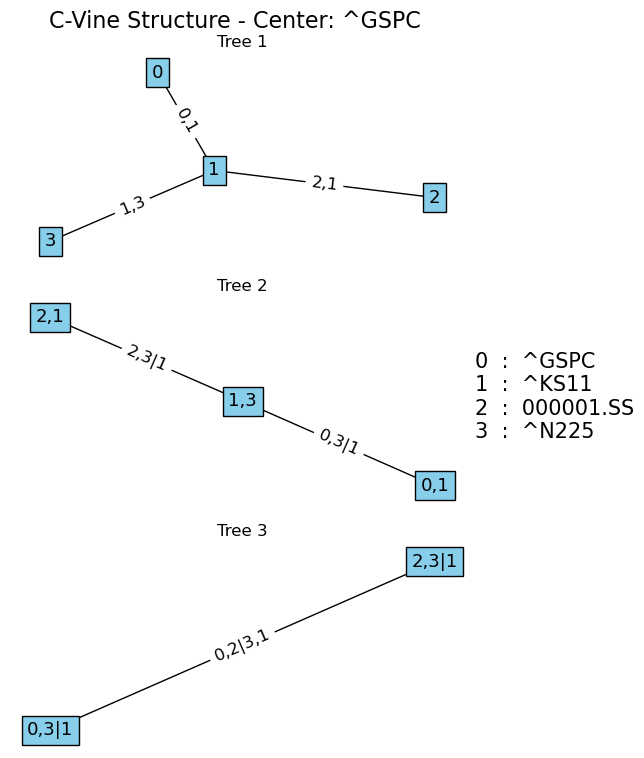

<Figure size 640x480 with 0 Axes>


Fitting C-Vine Copula for GARCH Model
Center Asset: ^N225
Asset order: ['^N225', '^KS11', '^GSPC', '000001.SS']

Fitting GARCH-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['^N225', '^KS11', '^GSPC', '000001.SS']
** Tree:  1
2,1  --->  Gumbel180 : parameters =  1.1344407474533673
0,1  --->  Gumbel180 : parameters =  1.5789528385392058
1,3  --->  Gumbel180 : parameters =  1.2600272019280536
** Tree:  2
2,0|1  --->  Gumbel180 : parameters =  1.0576209486736339
0,3|1  --->  Gaussian : parameters =  0.1243206913985665
** Tree:  3
2,3|0,1  --->  Frank : parameters =  0.23511604289101778


<Figure size 1200x800 with 0 Axes>

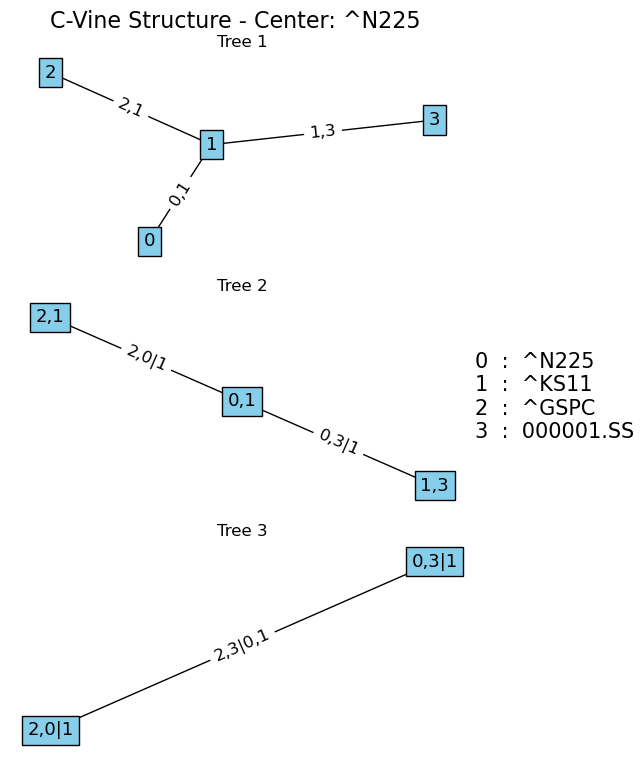

<Figure size 640x480 with 0 Axes>


Fitting C-Vine Copula for GARCH Model
Center Asset: 000001.SS
Asset order: ['000001.SS', '^KS11', '^GSPC', '^N225']

Fitting GARCH-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['000001.SS', '^KS11', '^GSPC', '^N225']
** Tree:  1
0,1  --->  Gumbel180 : parameters =  1.2600272019280536
2,1  --->  Gumbel180 : parameters =  1.1344407474533673
1,3  --->  Gumbel180 : parameters =  1.5789528385392058
** Tree:  2
0,3|1  --->  Gaussian : parameters =  0.1243206913985665
2,3|1  --->  Gumbel180 : parameters =  1.0576209486736339
** Tree:  3
0,2|3,1  --->  Frank : parameters =  0.23511604289101778


<Figure size 1200x800 with 0 Axes>

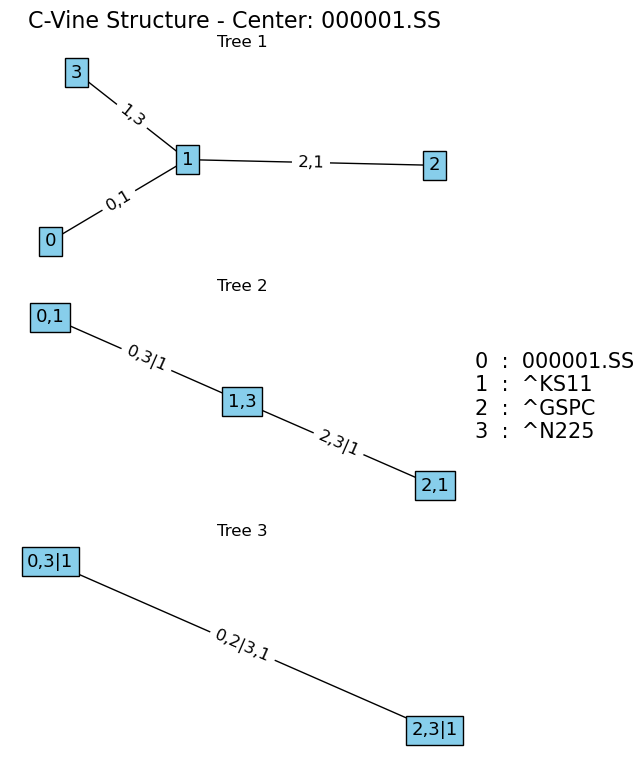

<Figure size 640x480 with 0 Axes>

In [82]:
# 예시: S&P 500을 중심으로
M_sp500, P_sp500, C_sp500, uniform_sp500, evt_sp500 = fit_vine_copula_with_center(
    garch_residuals, 
    model_type='GARCH',
    center_asset='^GSPC',  # S&P 500을 중심으로
    tail_fractions=TAIL_FRACTIONS,
    vine_type='C'
)

# 예시: Nikkei를 중심으로
M_nikkei, P_nikkei, C_nikkei, uniform_nikkei, evt_nikkei = fit_vine_copula_with_center(
    garch_residuals, 
    model_type='GARCH',
    center_asset='^N225',  # Nikkei를 중심으로
    tail_fractions=TAIL_FRACTIONS,
    vine_type='C'
)

# 예시: SSE를 중심으로
M_sse, P_sse, C_sse, uniform_sse, evt_sse = fit_vine_copula_with_center(
    garch_residuals, 
    model_type='GARCH',
    center_asset='000001.SS',  # SSE를 중심으로
    tail_fractions=TAIL_FRACTIONS,
    vine_type='C'
)


Fitting C-Vine Copula for GJR-GARCH Model
Center Asset: ^GSPC
Asset order: ['^GSPC', '^KS11', '000001.SS', '^N225']

Fitting GJR-GARCH-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['^GSPC', '^KS11', '000001.SS', '^N225']
** Tree:  1
0,1  --->  Gumbel180 : parameters =  1.130667485841
2,1  --->  Gumbel180 : parameters =  1.2565040307126452
1,3  --->  Student : parameters =  [0.5469374230392327, 7.531116660979023]
** Tree:  2
0,3|1  --->  Gumbel180 : parameters =  1.0531451669679173
2,3|1  --->  Gaussian : parameters =  0.12248320127707187
** Tree:  3
0,2|3,1  --->  Frank : parameters =  0.24775558307139425


<Figure size 1200x800 with 0 Axes>

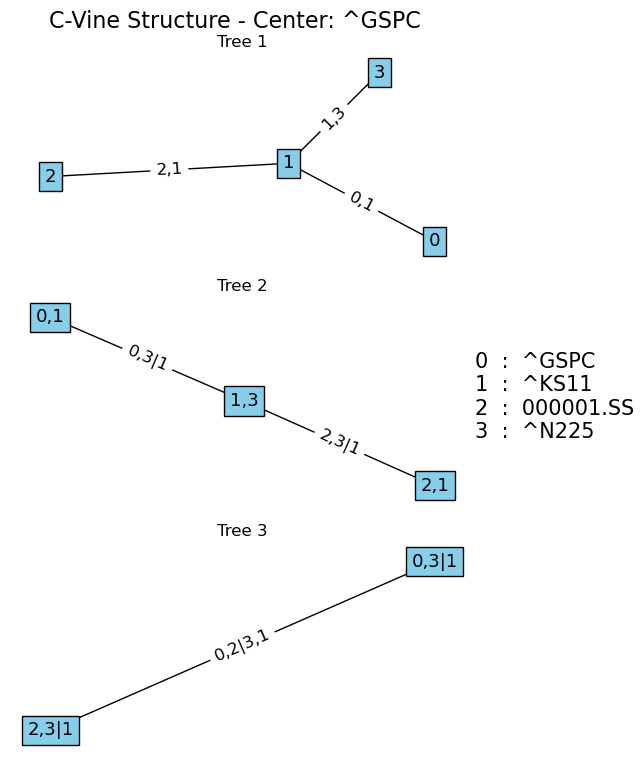

<Figure size 640x480 with 0 Axes>


Fitting C-Vine Copula for GJR-GARCH Model
Center Asset: ^N225
Asset order: ['^N225', '^KS11', '^GSPC', '000001.SS']

Fitting GJR-GARCH-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['^N225', '^KS11', '^GSPC', '000001.SS']
** Tree:  1
2,1  --->  Gumbel180 : parameters =  1.130667485841
0,1  --->  Student : parameters =  [0.5469374230392327, 7.531116660979023]
1,3  --->  Gumbel180 : parameters =  1.2565040307126452
** Tree:  2
2,0|1  --->  Gumbel180 : parameters =  1.0531451669679173
0,3|1  --->  Gaussian : parameters =  0.12248320127707187
** Tree:  3
2,3|0,1  --->  Frank : parameters =  0.24775558307139425


<Figure size 1200x800 with 0 Axes>

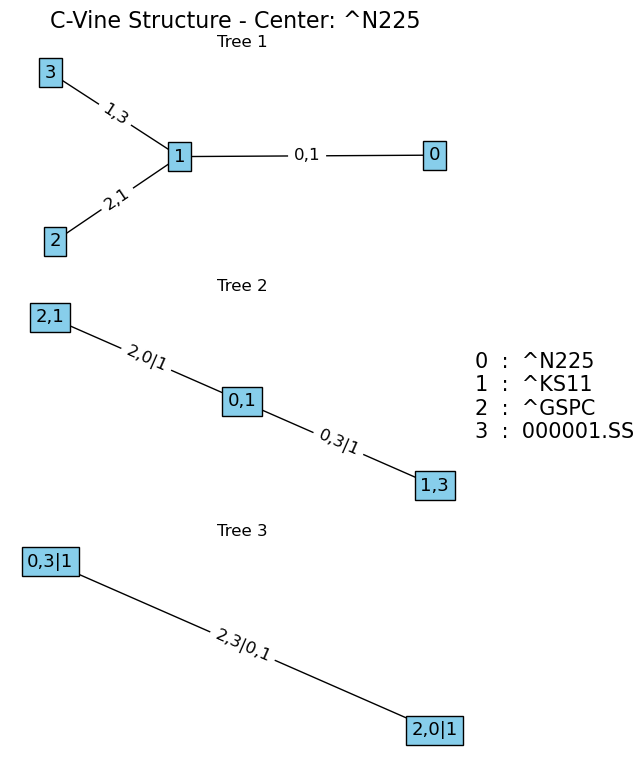

<Figure size 640x480 with 0 Axes>


Fitting C-Vine Copula for GJR-GARCH Model
Center Asset: 000001.SS
Asset order: ['000001.SS', '^KS11', '^GSPC', '^N225']

Fitting GJR-GARCH-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['000001.SS', '^KS11', '^GSPC', '^N225']
** Tree:  1
0,1  --->  Gumbel180 : parameters =  1.2565040307126452
2,1  --->  Gumbel180 : parameters =  1.130667485841
1,3  --->  Student : parameters =  [0.5469374230392327, 7.531116660979023]
** Tree:  2
0,3|1  --->  Gaussian : parameters =  0.12248320127707187
2,3|1  --->  Gumbel180 : parameters =  1.0531451669679173
** Tree:  3
0,2|3,1  --->  Frank : parameters =  0.24775558307139425


<Figure size 1200x800 with 0 Axes>

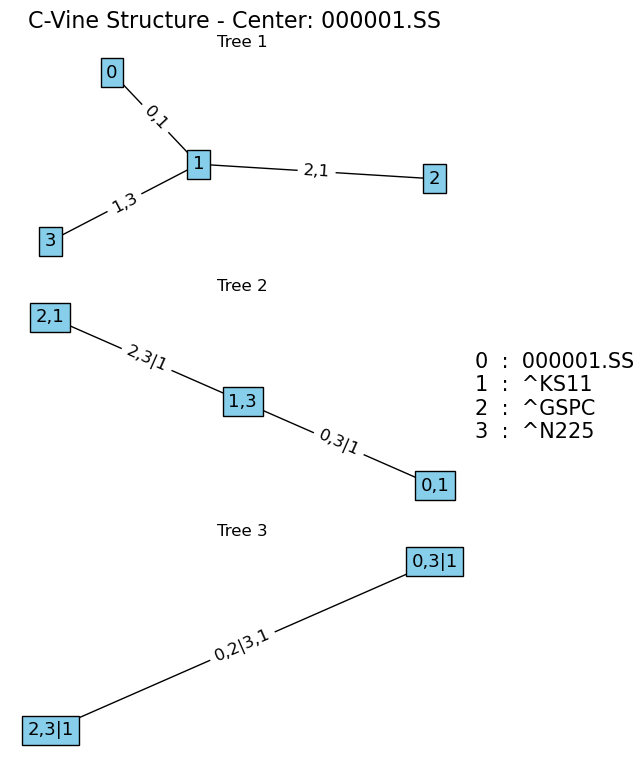

<Figure size 640x480 with 0 Axes>

In [83]:
# 예시: S&P 500을 중심으로
M_sp500, P_sp500, C_sp500, uniform_sp500, evt_sp500 = fit_vine_copula_with_center(
    gjr_residuals, 
    model_type='GJR-GARCH',
    center_asset='^GSPC',  # S&P 500을 중심으로
    tail_fractions=TAIL_FRACTIONS,
    vine_type='C'
)

# 예시: Nikkei를 중심으로
M_nikkei, P_nikkei, C_nikkei, uniform_nikkei, evt_nikkei = fit_vine_copula_with_center(
    gjr_residuals, 
    model_type='GJR-GARCH',
    center_asset='^N225',  # Nikkei를 중심으로
    tail_fractions=TAIL_FRACTIONS,
    vine_type='C'
)

# 예시: SSE를 중심으로
M_sse, P_sse, C_sse, uniform_sse, evt_sse = fit_vine_copula_with_center(
    gjr_residuals, 
    model_type='GJR-GARCH',
    center_asset='000001.SS',  # SSE를 중심으로
    tail_fractions=TAIL_FRACTIONS,
    vine_type='C'
)

In [9]:
def kupiec_test(violations, n_total, var_level):
   """
   Kupiec's Proportion of Failures (POF) test
   """
   n_violations = np.sum(violations)
   p = 1 - var_level  # Expected violation rate
   
   if n_violations == 0:
       # Handle zero violations
       LR = -2 * n_total * np.log(1 - p)
   elif n_violations == n_total:
       # Handle all violations
       LR = -2 * n_total * np.log(p)
   else:
       # Normal case
       p_hat = n_violations / n_total  # Observed violation rate
       LR = -2 * (np.log((1 - p)**n_total * p**n_violations) - 
                  np.log((1 - p_hat)**(n_total - n_violations) * p_hat**n_violations))
   
   p_value = 1 - chi2.cdf(LR, 1)
   
   return {
       'test': 'Kupiec POF',
       'statistic': LR,
       'p_value': p_value,
       'violations': n_violations,
       'violation_rate': n_violations / n_total,
       'expected_rate': p
   }

def christoffersen_test(violations, var_level):
   """
   Christoffersen's Conditional Coverage test (combining independence and coverage)
   """
   violations = np.array(violations).astype(int)
   n_total = len(violations)
   n_violations = np.sum(violations)
   p = 1 - var_level
   
   # Unconditional coverage test (same as Kupiec)
   uc_test = kupiec_test(violations, n_total, var_level)
   
   # Independence test
   # Count transitions
   n_00 = 0  # No violation followed by no violation
   n_01 = 0  # No violation followed by violation
   n_10 = 0  # Violation followed by no violation
   n_11 = 0  # Violation followed by violation
   
   for i in range(len(violations) - 1):
       if violations[i] == 0 and violations[i+1] == 0:
           n_00 += 1
       elif violations[i] == 0 and violations[i+1] == 1:
           n_01 += 1
       elif violations[i] == 1 and violations[i+1] == 0:
           n_10 += 1
       else:  # violations[i] == 1 and violations[i+1] == 1
           n_11 += 1
   
   # Transition probabilities
   if (n_00 + n_01) > 0:
       p_01 = n_01 / (n_00 + n_01)
   else:
       p_01 = 0
       
   if (n_10 + n_11) > 0:
       p_11 = n_11 / (n_10 + n_11)
   else:
       p_11 = 0
   
   # Overall violation probability
   p_hat = (n_01 + n_11) / (n_00 + n_01 + n_10 + n_11)
   
   # Independence LR statistic
   if p_01 > 0 and p_11 > 0 and p_hat > 0 and p_hat < 1:
       LR_ind = -2 * (np.log((1 - p_hat)**(n_00 + n_10) * p_hat**(n_01 + n_11)) - 
                      np.log((1 - p_01)**n_00 * p_01**n_01 * (1 - p_11)**n_10 * p_11**n_11))
   else:
       LR_ind = 0
   
   # Combined conditional coverage test
   LR_cc = uc_test['statistic'] + LR_ind
   
   p_value_ind = 1 - chi2.cdf(LR_ind, 1)
   p_value_cc = 1 - chi2.cdf(LR_cc, 2)
   
   return {
       'test': 'Christoffersen CC',
       'uc_statistic': uc_test['statistic'],
       'ind_statistic': LR_ind,
       'cc_statistic': LR_cc,
       'uc_p_value': uc_test['p_value'],
       'ind_p_value': p_value_ind,
       'cc_p_value': p_value_cc,
       'violations': n_violations,
       'violation_rate': n_violations / n_total,
       'expected_rate': p,
       'transition_probs': {'p_01': p_01, 'p_11': p_11}
   }

In [46]:
def var_backtesting_periodic_reestimation(train_returns, test_returns, model_type='EGARCH', 
                                         lookback_window=250, reestimation_freq=5,
                                         n_sim=1000, var_levels=[0.90, 0.95, 0.99], 
                                         tail_fractions=None, vine_type='C'):  # 변경
    
    # 기본값 설정
    if tail_fractions is None:
        tail_fractions = {asset: {'lower': 0.1, 'upper': 0.1} 
                         for asset in train_returns.keys()}
    
    print(f"\n{'='*60}")
    print(f"Periodic Reestimation VaR Backtesting for {model_type} Model")
    print(f"Lookback window: {lookback_window} days")
    print(f"Reestimation frequency: every {reestimation_freq} days")
    print(f"Using asymmetric tail fractions")  # 추가
    print(f"{'='*60}")
    
    test_dates = test_returns[list(test_returns.keys())[0]].index
    n_test = len(test_dates)
    
    var_results = {level: {'VaR': [], 'Returns': [], 'Violations': []} 
                  for level in var_levels}
    portfolio_returns = []
    
    n_assets = len(test_returns)
    weights = np.ones(n_assets) / n_assets
    
    current_var_values = {level: None for level in var_levels}
    
    for day_idx in range(n_test):
        current_date = test_dates[day_idx]
        
        # Reestimate model only at specified frequency
        if day_idx % reestimation_freq == 0:
            print(f"Reestimating model at day {day_idx + 1}/{n_test}")
            
            # Prepare rolling window data
            rolling_window_data = {}
            
            for asset in train_returns.keys():
                if day_idx == 0:
                    rolling_window_data[asset] = train_returns[asset].iloc[-lookback_window:]
                else:
                    all_historical = pd.concat([train_returns[asset], test_returns[asset].iloc[:day_idx]])
                    rolling_window_data[asset] = all_historical.iloc[-lookback_window:]
            
            try:
                # Fit models and calculate VaR
                models, residuals = fit_garch_models(rolling_window_data, model_type=model_type, dist='t')
                
                # EVT and Copula fitting with asset-specific tail fractions
                evt_models = {}
                uniform_data_dict = {}
                
                for asset, resid in residuals.items():
                    if resid is None:
                        continue
                    
                    data = np.array(resid)
                    if data.ndim > 1:
                        data = data[:, 0]
                    
                    # 자산별 꼬리 비율 적용
                    asset_tail_fractions = tail_fractions.get(asset, {'lower': 0.1, 'upper': 0.1})
                    
                    evt_obj = ParetoTailsEVT(
                        data, 
                        tail_fraction_up=asset_tail_fractions['upper'],
                        tail_fraction_down=asset_tail_fractions['lower']
                    )
                    evt_models[asset] = evt_obj
                    
                    uniform_data = evt_obj.cdf(data)
                    uniform_data_dict[asset] = uniform_data
                
                uniform_evt = pd.DataFrame(uniform_data_dict)
                u_data = uniform_evt.values
                
                M, P, C = fit_vinecop(u_data, list(range(1, 16)), vine=vine_type)
                u_sim = sample_vinecop(M, P, C, n_sim)
                
                simulated_residuals = np.zeros((n_sim, n_assets))
                for i, asset in enumerate(uniform_evt.columns):
                    simulated_residuals[:, i] = evt_models[asset].icdf(u_sim[:, i])
                
                last_volatilities = {}
                for asset in models.keys():
                    if models[asset] is not None:
                        last_volatilities[asset] = models[asset].conditional_volatility.iloc[-1]
                
                simulated_returns = np.zeros((n_sim, n_assets))
                for i, asset in enumerate(uniform_evt.columns):
                    mean = models[asset].params['mu'] if 'mu' in models[asset].params else 0
                    vol = last_volatilities[asset]
                    simulated_returns[:, i] = mean + vol * simulated_residuals[:, i]
                
                portfolio_sim_returns = simulated_returns @ weights
                
                # Update VaR values
                for level in var_levels:
                    current_var_values[level] = np.percentile(portfolio_sim_returns, (1 - level) * 100)
                
            except Exception as e:
                print(f"Error on {current_date}: {e}")
                # Use historical VaR as fallback
                for level in var_levels:
                    hist_portfolio_returns = []
                    for idx in range(len(rolling_window_data[list(rolling_window_data.keys())[0]])):
                        daily_ret = sum(rolling_window_data[asset].iloc[idx] * weights[i] 
                                      for i, asset in enumerate(rolling_window_data.keys()))
                        hist_portfolio_returns.append(daily_ret)
                    
                    current_var_values[level] = np.percentile(hist_portfolio_returns, (1 - level) * 100)
        
        # Use current VaR values
        for level in var_levels:
            var_results[level]['VaR'].append(current_var_values[level])
        
        # Calculate actual portfolio return
        daily_returns = [test_returns[asset].loc[current_date] for asset in test_returns.keys()]
        portfolio_return = np.array(daily_returns) @ weights
        portfolio_returns.append(portfolio_return)
        
        for level in var_levels:
            var_results[level]['Returns'].append(portfolio_return)
    
    # Testing and results
    test_results = {}
    
    for level in var_levels:
        var_array = np.array(var_results[level]['VaR'])
        returns_array = np.array(var_results[level]['Returns'])
        violations = returns_array < var_array
        var_results[level]['Violations'] = violations
        
        kupiec_result = kupiec_test(violations, len(violations), level)
        christoffersen_result = christoffersen_test(violations, level)
        
        test_results[level] = {
            'kupiec': kupiec_result,
            'christoffersen': christoffersen_result
        }
        
        print(f"\n{level*100}% VaR Results:")
        print(f"Total observations: {len(violations)}")
        print(f"Violations: {kupiec_result['violations']}")
        print(f"Violation rate: {kupiec_result['violation_rate']:.4f}")
        print(f"Expected rate: {kupiec_result['expected_rate']:.4f}")
        print(f"\nKupiec Test:")
        print(f"  LR statistic: {kupiec_result['statistic']:.4f}")
        print(f"  p-value: {kupiec_result['p_value']:.4f}")
        print(f"\nChristoffersen Test:")
        print(f"  UC statistic: {christoffersen_result['uc_statistic']:.4f} (p-value: {christoffersen_result['uc_p_value']:.4f})")
        print(f"  Independence statistic: {christoffersen_result['ind_statistic']:.4f} (p-value: {christoffersen_result['ind_p_value']:.4f})")
        print(f"  CC statistic: {christoffersen_result['cc_statistic']:.4f} (p-value: {christoffersen_result['cc_p_value']:.4f})")
    
    # 사용된 꼬리 비율 출력
    print(f"\nAsymmetric Tail Fractions Used:")
    for asset, fractions in tail_fractions.items():
        print(f"  {asset}: Lower {fractions['lower']*100:.0f}%, Upper {fractions['upper']*100:.0f}%")
    
    backtest_results = {
        'model_type': model_type,
        'var_results': var_results,
        'test_results': test_results,
        'portfolio_returns': portfolio_returns,
        'test_dates': test_dates,
        'lookback_window': lookback_window,
        'reestimation_freq': reestimation_freq,
        'n_sim': n_sim,
        'tail_fractions': tail_fractions  # 추가
    }
    
    return backtest_results

    


In [47]:
egarch_backtest = var_backtesting_periodic_reestimation(
    train_returns, test_returns, 
    model_type='EGARCH',reestimation_freq=1, n_sim=5000,
    tail_fractions=TAIL_FRACTIONS,
)



Periodic Reestimation VaR Backtesting for EGARCH Model
Lookback window: 250 days
Reestimation frequency: every 1 days
Using asymmetric tail fractions
Reestimating model at day 1/484

^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -355.947
Distribution:      Standardized Student's t   AIC:                           723.894
Method:                  Maximum Likelihood   BIC:                           745.023
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:39:55   Df Model:                            1
                       

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -488.674
Distribution:      Standardized Student's t   AIC:                           989.349
Method:                  Maximum Likelihood   BIC:                           1010.48
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:39:56   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -418.388
Distribution:      Standardized Student's t   AIC:                           848.777
Method:                  Maximum Likelihood   BIC:                           869.906
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:40:00   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -384.189
Distribution:      Standardized Student's t   AIC:                           780.377
Method:                  Maximum Likelihood   BIC:                           801.506
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:40:08   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -388.296
Distribution:      Standardized Student's t   AIC:                           788.592
Method:                  Maximum Likelihood   BIC:                           809.720
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:40:13   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -390.372
Distribution:      Standardized Student's t   AIC:                           792.744
Method:                  Maximum Likelihood   BIC:                           813.872
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:40:22   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -397.309
Distribution:      Standardized Student's t   AIC:                           806.617
Method:                  Maximum Likelihood   BIC:                           827.746
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:40:28   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -424.065
Distribution:      Standardized Student's t   AIC:                           860.130
Method:                  Maximum Likelihood   BIC:                           881.259
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:40:34   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -358.272
Distribution:      Standardized Student's t   AIC:                           728.544
Method:                  Maximum Likelihood   BIC:                           749.673
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:40:41   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -396.077
Distribution:      Standardized Student's t   AIC:                           804.154
Method:                  Maximum Likelihood   BIC:                           825.283
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:40:41   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -395.654
Distribution:      Standardized Student's t   AIC:                           803.309
Method:                  Maximum Likelihood   BIC:                           824.438
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:40:48   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1117.06
Distribution:      Standardized Student's t   AIC:                           2246.11
Method:                  Maximum Likelihood   BIC:                           2267.24
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:40:55   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -355.746
Distribution:      Standardized Student's t   AIC:                           723.492
Method:                  Maximum Likelihood   BIC:                           744.621
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:41:01   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2732.02
Distribution:      Standardized Student's t   AIC:                           5476.04
Method:                  Maximum Likelihood   BIC:                           5497.17
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:41:08   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
Error fitting ^KS11: Singular matrix

^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -447.819
Distribution:      Standardized Student's t   AIC:                           907.639
Method:                  Maximum Likelihood   BIC:                           928.767
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:41:14   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf.

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1527.04
Distribution:      Standardized Student's t   AIC:                           3066.09
Method:                  Maximum Likelihood   BIC:                           3087.22
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:41:18   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -485.930
Distribution:      Standardized Student's t   AIC:                           983.860
Method:                  Maximum Likelihood   BIC:                           1004.99
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:41:19   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -361.457
Distribution:      Standardized Student's t   AIC:                           734.913
Method:                  Maximum Likelihood   BIC:                           756.042
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:41:26   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -429.943
Distribution:      Standardized Student's t   AIC:                           871.886
Method:                  Maximum Likelihood   BIC:                           893.015
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:41:26   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -358.488
Distribution:      Standardized Student's t   AIC:                           728.975
Method:                  Maximum Likelihood   BIC:                           750.104
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:41:32   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -365.870
Distribution:      Standardized Student's t   AIC:                           743.739
Method:                  Maximum Likelihood   BIC:                           764.868
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:41:50   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -407.122
Distribution:      Standardized Student's t   AIC:                           826.243
Method:                  Maximum Likelihood   BIC:                           847.372
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:41:57   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -441.770
Distribution:      Standardized Student's t   AIC:                           895.540
Method:                  Maximum Likelihood   BIC:                           916.669
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:42:08   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
Error fitting ^GSPC: Singular matrix

000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -353.760
Distribution:      Standardized Student's t   AIC:                           719.520
Method:                  Maximum Likelihood   BIC:                           740.648
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:42:14   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -406.904
Distribution:      Standardized Student's t   AIC:                           825.808
Method:                  Maximum Likelihood   BIC:                           846.937
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:42:15   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1575.54
Distribution:      Standardized Student's t   AIC:                           3163.09
Method:                  Maximum Likelihood   BIC:                           3184.22
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:42:21   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1590.40
Distribution:      Standardized Student's t   AIC:                           3192.79
Method:                  Maximum Likelihood   BIC:                           3213.92
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:42:39   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -434.650
Distribution:      Standardized Student's t   AIC:                           881.299
Method:                  Maximum Likelihood   BIC:                           902.428
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:42:46   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2745.69
Distribution:      Standardized Student's t   AIC:                           5503.38
Method:                  Maximum Likelihood   BIC:                           5524.51
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:42:46   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -406.921
Distribution:      Standardized Student's t   AIC:                           825.841
Method:                  Maximum Likelihood   BIC:                           846.970
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:43:00   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -441.573
Distribution:      Standardized Student's t   AIC:                           895.147
Method:                  Maximum Likelihood   BIC:                           916.275
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:43:05   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -406.836
Distribution:      Standardized Student's t   AIC:                           825.671
Method:                  Maximum Likelihood   BIC:                           846.800
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:43:12   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -577.040
Distribution:      Standardized Student's t   AIC:                           1166.08
Method:                  Maximum Likelihood   BIC:                           1187.21
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:43:19   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -436.228
Distribution:      Standardized Student's t   AIC:                           884.456
Method:                  Maximum Likelihood   BIC:                           905.585
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:43:25   Df Model:                            1
                                Mean Model                               
                  coef    std err          t      P>|t|  95.0% Conf. Int.
----------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -411.062
Distribution:      Standardized Student's t   AIC:                           834.124
Method:                  Maximum Likelihood   BIC:                           855.253
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:43:25   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1979.24
Distribution:      Standardized Student's t   AIC:                           3970.48
Method:                  Maximum Likelihood   BIC:                           3991.61
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:43:31   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -500.982
Distribution:      Standardized Student's t   AIC:                           1013.96
Method:                  Maximum Likelihood   BIC:                           1035.09
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:43:39   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -527.087
Distribution:      Standardized Student's t   AIC:                           1066.17
Method:                  Maximum Likelihood   BIC:                           1087.30
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:43:57   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -415.352
Distribution:      Standardized Student's t   AIC:                           842.704
Method:                  Maximum Likelihood   BIC:                           863.833
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:44:07   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1573.74
Distribution:      Standardized Student's t   AIC:                           3159.48
Method:                  Maximum Likelihood   BIC:                           3180.61
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:44:14   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2901.67
Distribution:      Standardized Student's t   AIC:                           5815.35
Method:                  Maximum Likelihood   BIC:                           5836.48
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:44:39   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1299.44
Distribution:      Standardized Student's t   AIC:                           2610.89
Method:                  Maximum Likelihood   BIC:                           2632.01
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:44:51   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -456.120
Distribution:      Standardized Student's t   AIC:                           924.240
Method:                  Maximum Likelihood   BIC:                           945.368
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:44:56   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -439.422
Distribution:      Standardized Student's t   AIC:                           890.843
Method:                  Maximum Likelihood   BIC:                           911.972
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:45:08   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -424.167
Distribution:      Standardized Student's t   AIC:                           860.334
Method:                  Maximum Likelihood   BIC:                           881.463
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:45:14   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2891.62
Distribution:      Standardized Student's t   AIC:                           5795.25
Method:                  Maximum Likelihood   BIC:                           5816.38
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:45:26   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -434.270
Distribution:      Standardized Student's t   AIC:                           880.540
Method:                  Maximum Likelihood   BIC:                           901.669
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:45:31   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -449.304
Distribution:      Standardized Student's t   AIC:                           910.609
Method:                  Maximum Likelihood   BIC:                           931.737
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:45:41   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1445.30
Distribution:      Standardized Student's t   AIC:                           2902.60
Method:                  Maximum Likelihood   BIC:                           2923.73
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:45:47   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1394.27
Distribution:      Standardized Student's t   AIC:                           2800.55
Method:                  Maximum Likelihood   BIC:                           2821.67
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:45:52   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -454.253
Distribution:      Standardized Student's t   AIC:                           920.506
Method:                  Maximum Likelihood   BIC:                           941.635
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:46:03   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -433.552
Distribution:      Standardized Student's t   AIC:                           879.103
Method:                  Maximum Likelihood   BIC:                           900.232
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:46:08   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2065.76
Distribution:      Standardized Student's t   AIC:                           4143.52
Method:                  Maximum Likelihood   BIC:                           4164.65
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:46:14   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -525.496
Distribution:      Standardized Student's t   AIC:                           1062.99
Method:                  Maximum Likelihood   BIC:                           1084.12
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:46:19   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -351.797
Distribution:      Standardized Student's t   AIC:                           715.593
Method:                  Maximum Likelihood   BIC:                           736.722
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:46:30   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -416.190
Distribution:      Standardized Student's t   AIC:                           844.380
Method:                  Maximum Likelihood   BIC:                           865.508
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:46:31   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -423.946
Distribution:      Standardized Student's t   AIC:                           859.891
Method:                  Maximum Likelihood   BIC:                           881.020
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:46:36   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1616.02
Distribution:      Standardized Student's t   AIC:                           3244.05
Method:                  Maximum Likelihood   BIC:                           3265.17
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:46:40   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -417.568
Distribution:      Standardized Student's t   AIC:                           847.136
Method:                  Maximum Likelihood   BIC:                           868.264
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:46:40   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -418.280
Distribution:      Standardized Student's t   AIC:                           848.560
Method:                  Maximum Likelihood   BIC:                           869.689
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:46:46   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -438.968
Distribution:      Standardized Student's t   AIC:                           889.935
Method:                  Maximum Likelihood   BIC:                           911.064
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:47:06   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -458.127
Distribution:      Standardized Student's t   AIC:                           928.254
Method:                  Maximum Likelihood   BIC:                           949.383
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:47:16   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -437.016
Distribution:      Standardized Student's t   AIC:                           886.032
Method:                  Maximum Likelihood   BIC:                           907.160
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:47:46   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -433.646
Distribution:      Standardized Student's t   AIC:                           879.292
Method:                  Maximum Likelihood   BIC:                           900.420
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:47:52   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -433.717
Distribution:      Standardized Student's t   AIC:                           879.434
Method:                  Maximum Likelihood   BIC:                           900.563
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:47:58   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -432.714
Distribution:      Standardized Student's t   AIC:                           877.428
Method:                  Maximum Likelihood   BIC:                           898.557
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:03   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -352.466
Distribution:      Standardized Student's t   AIC:                           716.933
Method:                  Maximum Likelihood   BIC:                           738.062
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:04   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -443.760
Distribution:      Standardized Student's t   AIC:                           899.519
Method:                  Maximum Likelihood   BIC:                           920.648
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:09   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -345.452
Distribution:      Standardized Student's t   AIC:                           702.905
Method:                  Maximum Likelihood   BIC:                           724.034
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:10   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2030.73
Distribution:      Standardized Student's t   AIC:                           4073.47
Method:                  Maximum Likelihood   BIC:                           4094.60
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:15   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2082.05
Distribution:      Standardized Student's t   AIC:                           4176.10
Method:                  Maximum Likelihood   BIC:                           4197.23
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:20   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -452.321
Distribution:      Standardized Student's t   AIC:                           916.642
Method:                  Maximum Likelihood   BIC:                           937.771
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:26   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -431.555
Distribution:      Standardized Student's t   AIC:                           875.111
Method:                  Maximum Likelihood   BIC:                           896.240
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:34   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -349.060
Distribution:      Standardized Student's t   AIC:                           710.121
Method:                  Maximum Likelihood   BIC:                           731.249
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:39   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -481.857
Distribution:      Standardized Student's t   AIC:                           975.714
Method:                  Maximum Likelihood   BIC:                           996.843
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:44   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -434.411
Distribution:      Standardized Student's t   AIC:                           880.822
Method:                  Maximum Likelihood   BIC:                           901.951
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:50   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -356.117
Distribution:      Standardized Student's t   AIC:                           724.235
Method:                  Maximum Likelihood   BIC:                           745.364
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:48:50   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -351.040
Distribution:      Standardized Student's t   AIC:                           714.080
Method:                  Maximum Likelihood   BIC:                           735.209
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:01   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -435.847
Distribution:      Standardized Student's t   AIC:                           883.693
Method:                  Maximum Likelihood   BIC:                           904.822
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:06   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -643.485
Distribution:      Standardized Student's t   AIC:                           1298.97
Method:                  Maximum Likelihood   BIC:                           1320.10
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:10   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -344.554
Distribution:      Standardized Student's t   AIC:                           701.107
Method:                  Maximum Likelihood   BIC:                           722.236
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:11   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -445.600
Distribution:      Standardized Student's t   AIC:                           903.200
Method:                  Maximum Likelihood   BIC:                           924.329
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:16   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1024.59
Distribution:      Standardized Student's t   AIC:                           2061.17
Method:                  Maximum Likelihood   BIC:                           2082.30
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:16   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -439.142
Distribution:      Standardized Student's t   AIC:                           890.285
Method:                  Maximum Likelihood   BIC:                           911.414
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:23   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -435.967
Distribution:      Standardized Student's t   AIC:                           883.935
Method:                  Maximum Likelihood   BIC:                           905.063
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:29   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -343.591
Distribution:      Standardized Student's t   AIC:                           699.182
Method:                  Maximum Likelihood   BIC:                           720.311
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:29   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -436.476
Distribution:      Standardized Student's t   AIC:                           884.953
Method:                  Maximum Likelihood   BIC:                           906.081
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:35   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -345.315
Distribution:      Standardized Student's t   AIC:                           702.629
Method:                  Maximum Likelihood   BIC:                           723.758
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:35   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -436.220
Distribution:      Standardized Student's t   AIC:                           884.441
Method:                  Maximum Likelihood   BIC:                           905.569
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:49:58   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -342.565
Distribution:      Standardized Student's t   AIC:                           697.131
Method:                  Maximum Likelihood   BIC:                           718.259
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:50:09   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -341.798
Distribution:      Standardized Student's t   AIC:                           695.597
Method:                  Maximum Likelihood   BIC:                           716.726
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:50:15   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -356.841
Distribution:      Standardized Student's t   AIC:                           725.683
Method:                  Maximum Likelihood   BIC:                           746.812
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:50:21   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -339.976
Distribution:      Standardized Student's t   AIC:                           691.952
Method:                  Maximum Likelihood   BIC:                           713.081
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:50:26   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -347.641
Distribution:      Standardized Student's t   AIC:                           707.282
Method:                  Maximum Likelihood   BIC:                           728.411
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:50:40   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -337.296
Distribution:      Standardized Student's t   AIC:                           686.593
Method:                  Maximum Likelihood   BIC:                           707.721
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:50:46   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -435.106
Distribution:      Standardized Student's t   AIC:                           882.212
Method:                  Maximum Likelihood   BIC:                           903.341
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:51:11   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -333.405
Distribution:      Standardized Student's t   AIC:                           678.810
Method:                  Maximum Likelihood   BIC:                           699.939
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:51:29   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1732.62
Distribution:      Standardized Student's t   AIC:                           3477.25
Method:                  Maximum Likelihood   BIC:                           3498.38
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:51:33   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -347.916
Distribution:      Standardized Student's t   AIC:                           707.832
Method:                  Maximum Likelihood   BIC:                           728.960
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:51:33   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -349.001
Distribution:      Standardized Student's t   AIC:                           710.001
Method:                  Maximum Likelihood   BIC:                           731.130
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:51:45   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -334.511
Distribution:      Standardized Student's t   AIC:                           681.023
Method:                  Maximum Likelihood   BIC:                           702.152
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:51:50   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1037.67
Distribution:      Standardized Student's t   AIC:                           2087.35
Method:                  Maximum Likelihood   BIC:                           2108.48
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:51:56   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
----------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1589.74
Distribution:      Standardized Student's t   AIC:                           3191.49
Method:                  Maximum Likelihood   BIC:                           3212.61
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:52:11   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -330.138
Distribution:      Standardized Student's t   AIC:                           672.276
Method:                  Maximum Likelihood   BIC:                           693.404
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:52:11   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
Error fitting ^GSPC: Singular matrix

000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2588.10
Distribution:      Standardized Student's t   AIC:                           5188.19
Method:                  Maximum Likelihood   BIC:                           5209.32
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:52:36   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|   

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -435.781
Distribution:      Standardized Student's t   AIC:                           883.563
Method:                  Maximum Likelihood   BIC:                           904.692
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:52:42   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1509.82
Distribution:      Standardized Student's t   AIC:                           3031.63
Method:                  Maximum Likelihood   BIC:                           3052.76
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:52:43   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -436.429
Distribution:      Standardized Student's t   AIC:                           884.857
Method:                  Maximum Likelihood   BIC:                           905.986
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:52:51   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2626.64
Distribution:      Standardized Student's t   AIC:                           5265.28
Method:                  Maximum Likelihood   BIC:                           5286.41
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:53:05   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -349.532
Distribution:      Standardized Student's t   AIC:                           711.064
Method:                  Maximum Likelihood   BIC:                           732.192
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:53:25   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -323.538
Distribution:      Standardized Student's t   AIC:                           659.076
Method:                  Maximum Likelihood   BIC:                           680.205
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:53:51   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -594.792
Distribution:      Standardized Student's t   AIC:                           1201.58
Method:                  Maximum Likelihood   BIC:                           1222.71
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:53:57   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -334.345
Distribution:      Standardized Student's t   AIC:                           680.691
Method:                  Maximum Likelihood   BIC:                           701.819
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:53:57   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -324.207
Distribution:      Standardized Student's t   AIC:                           660.414
Method:                  Maximum Likelihood   BIC:                           681.543
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:54:03   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -443.918
Distribution:      Standardized Student's t   AIC:                           899.836
Method:                  Maximum Likelihood   BIC:                           920.965
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:54:09   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -434.979
Distribution:      Standardized Student's t   AIC:                           881.958
Method:                  Maximum Likelihood   BIC:                           903.086
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:54:14   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -413.860
Distribution:      Standardized Student's t   AIC:                           839.721
Method:                  Maximum Likelihood   BIC:                           860.850
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:54:21   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1774.44
Distribution:      Standardized Student's t   AIC:                           3560.87
Method:                  Maximum Likelihood   BIC:                           3582.00
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:54:27   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1583.84
Distribution:      Standardized Student's t   AIC:                           3179.68
Method:                  Maximum Likelihood   BIC:                           3200.81
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:54:34   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -321.381
Distribution:      Standardized Student's t   AIC:                           654.763
Method:                  Maximum Likelihood   BIC:                           675.892
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:54:35   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -331.940
Distribution:      Standardized Student's t   AIC:                           675.881
Method:                  Maximum Likelihood   BIC:                           697.009
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:54:41   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -466.450
Distribution:      Standardized Student's t   AIC:                           944.899
Method:                  Maximum Likelihood   BIC:                           966.028
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:54:47   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -329.049
Distribution:      Standardized Student's t   AIC:                           670.099
Method:                  Maximum Likelihood   BIC:                           691.227
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:54:53   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1582.52
Distribution:      Standardized Student's t   AIC:                           3177.05
Method:                  Maximum Likelihood   BIC:                           3198.17
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:06   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -315.386
Distribution:      Standardized Student's t   AIC:                           642.772
Method:                  Maximum Likelihood   BIC:                           663.901
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:13   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
Error fitting ^GSPC: Singular matrix

000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -316.049
Distribution:      Standardized Student's t   AIC:                           644.097
Method:                  Maximum Likelihood   BIC:                           665.226
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:23   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% C

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -410.049
Distribution:      Standardized Student's t   AIC:                           832.097
Method:                  Maximum Likelihood   BIC:                           853.226
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:27   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -408.480
Distribution:      Standardized Student's t   AIC:                           828.961
Method:                  Maximum Likelihood   BIC:                           850.089
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:34   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -323.463
Distribution:      Standardized Student's t   AIC:                           658.927
Method:                  Maximum Likelihood   BIC:                           680.055
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:35   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
Error fitting ^GSPC: Singular matrix

000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -311.898
Distribution:      Standardized Student's t   AIC:                           635.796
Method:                  Maximum Likelihood   BIC:                           656.925
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:42   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|   

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -414.995
Distribution:      Standardized Student's t   AIC:                           841.990
Method:                  Maximum Likelihood   BIC:                           863.119
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:46   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -327.950
Distribution:      Standardized Student's t   AIC:                           667.901
Method:                  Maximum Likelihood   BIC:                           689.030
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:47   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -413.818
Distribution:      Standardized Student's t   AIC:                           839.636
Method:                  Maximum Likelihood   BIC:                           860.765
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:52   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -332.450
Distribution:      Standardized Student's t   AIC:                           676.901
Method:                  Maximum Likelihood   BIC:                           698.030
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:55:52   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -404.510
Distribution:      Standardized Student's t   AIC:                           821.021
Method:                  Maximum Likelihood   BIC:                           842.150
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:06   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -311.085
Distribution:      Standardized Student's t   AIC:                           634.170
Method:                  Maximum Likelihood   BIC:                           655.299
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:06   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -404.513
Distribution:      Standardized Student's t   AIC:                           821.027
Method:                  Maximum Likelihood   BIC:                           842.155
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:13   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
Error fitting 000001.SS: Singular matrix

^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -367.461
Distribution:      Standardized Student's t   AIC:                           746.922
Method:                  Maximum Likelihood   BIC:                           768.050
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:27   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|  

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -400.755
Distribution:      Standardized Student's t   AIC:                           813.511
Method:                  Maximum Likelihood   BIC:                           834.640
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:31   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -531.092
Distribution:      Standardized Student's t   AIC:                           1074.18
Method:                  Maximum Likelihood   BIC:                           1095.31
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:32   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -408.298
Distribution:      Standardized Student's t   AIC:                           828.595
Method:                  Maximum Likelihood   BIC:                           849.724
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:39   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -319.865
Distribution:      Standardized Student's t   AIC:                           651.729
Method:                  Maximum Likelihood   BIC:                           672.858
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:40   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -399.382
Distribution:      Standardized Student's t   AIC:                           810.763
Method:                  Maximum Likelihood   BIC:                           831.892
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:46   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -307.103
Distribution:      Standardized Student's t   AIC:                           626.206
Method:                  Maximum Likelihood   BIC:                           647.335
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:46   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -312.837
Distribution:      Standardized Student's t   AIC:                           637.673
Method:                  Maximum Likelihood   BIC:                           658.802
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:56:55   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -309.696
Distribution:      Standardized Student's t   AIC:                           631.392
Method:                  Maximum Likelihood   BIC:                           652.521
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:57:02   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -303.202
Distribution:      Standardized Student's t   AIC:                           618.404
Method:                  Maximum Likelihood   BIC:                           639.532
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:57:08   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -404.612
Distribution:      Standardized Student's t   AIC:                           821.223
Method:                  Maximum Likelihood   BIC:                           842.352
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:57:15   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -305.737
Distribution:      Standardized Student's t   AIC:                           623.474
Method:                  Maximum Likelihood   BIC:                           644.603
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:57:15   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -303.841
Distribution:      Standardized Student's t   AIC:                           619.683
Method:                  Maximum Likelihood   BIC:                           640.812
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:57:22   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -391.539
Distribution:      Standardized Student's t   AIC:                           795.078
Method:                  Maximum Likelihood   BIC:                           816.207
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:57:27   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -305.916
Distribution:      Standardized Student's t   AIC:                           623.831
Method:                  Maximum Likelihood   BIC:                           644.960
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:57:28   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -304.388
Distribution:      Standardized Student's t   AIC:                           620.777
Method:                  Maximum Likelihood   BIC:                           641.905
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:57:35   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2831.00
Distribution:      Standardized Student's t   AIC:                           5673.99
Method:                  Maximum Likelihood   BIC:                           5695.12
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:58:08   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -381.990
Distribution:      Standardized Student's t   AIC:                           775.981
Method:                  Maximum Likelihood   BIC:                           797.110
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:58:19   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -302.504
Distribution:      Standardized Student's t   AIC:                           617.008
Method:                  Maximum Likelihood   BIC:                           638.137
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:58:20   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -410.814
Distribution:      Standardized Student's t   AIC:                           833.627
Method:                  Maximum Likelihood   BIC:                           854.756
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:58:26   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -415.584
Distribution:      Standardized Student's t   AIC:                           843.168
Method:                  Maximum Likelihood   BIC:                           864.297
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:58:31   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1204.27
Distribution:      Standardized Student's t   AIC:                           2420.54
Method:                  Maximum Likelihood   BIC:                           2441.67
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:58:50   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -375.571
Distribution:      Standardized Student's t   AIC:                           763.141
Method:                  Maximum Likelihood   BIC:                           784.270
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:59:05   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -315.804
Distribution:      Standardized Student's t   AIC:                           643.608
Method:                  Maximum Likelihood   BIC:                           664.736
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:59:42   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -304.710
Distribution:      Standardized Student's t   AIC:                           621.421
Method:                  Maximum Likelihood   BIC:                           642.549
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:59:49   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -300.574
Distribution:      Standardized Student's t   AIC:                           613.148
Method:                  Maximum Likelihood   BIC:                           634.276
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              06:59:55   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -302.792
Distribution:      Standardized Student's t   AIC:                           617.584
Method:                  Maximum Likelihood   BIC:                           638.713
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:00:00   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -301.191
Distribution:      Standardized Student's t   AIC:                           614.381
Method:                  Maximum Likelihood   BIC:                           635.510
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:00:07   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -316.997
Distribution:      Standardized Student's t   AIC:                           645.995
Method:                  Maximum Likelihood   BIC:                           667.123
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:00:14   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


** Tree:  1
1,0  --->  Gumbel180 : parameters =  1.0650355338966064
2,0  --->  Frank : parameters =  2.2328672495317883
0,3  --->  Gumbel180 : parameters =  1.455437966460062
** Tree:  2
1,2|0  --->  Clayton90 : parameters =  -0.15946242825352056
2,3|0  --->  Clayton90 : parameters =  -0.11732716351176131
** Tree:  3
1,3|2,0  --->  Clayton90 : parameters =  -0.07700463266377643
Reestimating model at day 196/484

^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -340.768
Distribution:      Standardized Student's t   AIC:                           693.537
Method:                  Maximum Likelihood   BIC:                           714.665
                                              

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -306.349
Distribution:      Standardized Student's t   AIC:                           624.697
Method:                  Maximum Likelihood   BIC:                           645.826
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:00:31   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -294.644
Distribution:      Standardized Student's t   AIC:                           601.288
Method:                  Maximum Likelihood   BIC:                           622.417
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:00:41   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -323.836
Distribution:      Standardized Student's t   AIC:                           659.673
Method:                  Maximum Likelihood   BIC:                           680.802
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:01:10   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -319.978
Distribution:      Standardized Student's t   AIC:                           651.956
Method:                  Maximum Likelihood   BIC:                           673.084
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:01:22   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -290.386
Distribution:      Standardized Student's t   AIC:                           592.772
Method:                  Maximum Likelihood   BIC:                           613.901
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:01:30   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -292.552
Distribution:      Standardized Student's t   AIC:                           597.104
Method:                  Maximum Likelihood   BIC:                           618.232
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:01:36   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -356.764
Distribution:      Standardized Student's t   AIC:                           725.528
Method:                  Maximum Likelihood   BIC:                           746.657
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:01:48   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


** Tree:  1
1,0  --->  Gumbel180 : parameters =  1.0721503441444395
2,0  --->  Clayton270 : parameters =  -0.122543632482542
0,3  --->  Gumbel180 : parameters =  1.4314076118982504
** Tree:  2
1,2|0  --->  Frank : parameters =  0.18728811576910295
2,3|0  --->  Frank : parameters =  0.28224695146683254
** Tree:  3
1,3|2,0  --->  Clayton270 : parameters =  -0.039856197929249444
Reestimating model at day 209/484

^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -336.301
Distribution:      Standardized Student's t   AIC:                           684.602
Method:                  Maximum Likelihood   BIC:                           705.731
                                              No

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -381.080
Distribution:      Standardized Student's t   AIC:                           774.160
Method:                  Maximum Likelihood   BIC:                           795.289
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:02:04   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -378.938
Distribution:      Standardized Student's t   AIC:                           769.876
Method:                  Maximum Likelihood   BIC:                           791.004
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:02:12   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -374.675
Distribution:      Standardized Student's t   AIC:                           761.350
Method:                  Maximum Likelihood   BIC:                           782.479
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:02:18   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
Error fitting 000001.SS: Singular matrix

^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -359.530
Distribution:      Standardized Student's t   AIC:                           731.061
Method:                  Maximum Likelihood   BIC:                           752.189
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:02:19   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|  

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -355.854
Distribution:      Standardized Student's t   AIC:                           723.708
Method:                  Maximum Likelihood   BIC:                           744.837
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:02:24   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
Error fitting 000001.SS: Singular matrix

^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -360.500
Distribution:      Standardized Student's t   AIC:                           732.999
Method:                  Maximum Likelihood   BIC:                           754.128
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:02:25   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|  

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -352.664
Distribution:      Standardized Student's t   AIC:                           717.328
Method:                  Maximum Likelihood   BIC:                           738.457
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:02:45   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -287.528
Distribution:      Standardized Student's t   AIC:                           587.056
Method:                  Maximum Likelihood   BIC:                           608.185
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:02:50   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -360.475
Distribution:      Standardized Student's t   AIC:                           732.950
Method:                  Maximum Likelihood   BIC:                           754.078
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:02:56   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -291.726
Distribution:      Standardized Student's t   AIC:                           595.452
Method:                  Maximum Likelihood   BIC:                           616.581
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:02:56   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -335.142
Distribution:      Standardized Student's t   AIC:                           682.284
Method:                  Maximum Likelihood   BIC:                           703.413
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:02   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -352.080
Distribution:      Standardized Student's t   AIC:                           716.160
Method:                  Maximum Likelihood   BIC:                           737.289
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:02   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -299.723
Distribution:      Standardized Student's t   AIC:                           611.446
Method:                  Maximum Likelihood   BIC:                           632.575
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:08   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------------------------
mu        

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1037.23
Distribution:      Standardized Student's t   AIC:                           2086.46
Method:                  Maximum Likelihood   BIC:                           2107.59
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:13   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -337.492
Distribution:      Standardized Student's t   AIC:                           686.983
Method:                  Maximum Likelihood   BIC:                           708.112
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:18   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1882.33
Distribution:      Standardized Student's t   AIC:                           3776.66
Method:                  Maximum Likelihood   BIC:                           3797.79
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:24   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -576.675
Distribution:      Standardized Student's t   AIC:                           1165.35
Method:                  Maximum Likelihood   BIC:                           1186.48
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:31   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -355.859
Distribution:      Standardized Student's t   AIC:                           723.719
Method:                  Maximum Likelihood   BIC:                           744.848
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:31   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -297.837
Distribution:      Standardized Student's t   AIC:                           607.674
Method:                  Maximum Likelihood   BIC:                           628.803
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:31   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1289.88
Distribution:      Standardized Student's t   AIC:                           2591.75
Method:                  Maximum Likelihood   BIC:                           2612.88
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:36   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -337.680
Distribution:      Standardized Student's t   AIC:                           687.360
Method:                  Maximum Likelihood   BIC:                           708.489
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:42   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -323.980
Distribution:      Standardized Student's t   AIC:                           659.960
Method:                  Maximum Likelihood   BIC:                           681.089
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:43   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1899.66
Distribution:      Standardized Student's t   AIC:                           3811.32
Method:                  Maximum Likelihood   BIC:                           3832.45
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:48   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2144.07
Distribution:      Standardized Student's t   AIC:                           4300.13
Method:                  Maximum Likelihood   BIC:                           4321.26
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:54   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1524.02
Distribution:      Standardized Student's t   AIC:                           3060.04
Method:                  Maximum Likelihood   BIC:                           3081.17
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:54   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -290.412
Distribution:      Standardized Student's t   AIC:                           592.825
Method:                  Maximum Likelihood   BIC:                           613.953
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:03:54   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -384.924
Distribution:      Standardized Student's t   AIC:                           781.847
Method:                  Maximum Likelihood   BIC:                           802.976
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:00   Df Model:                            1
                                Mean Model                               
                  coef    std err          t      P>|t|  95.0% Conf. Int.
----------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -358.405
Distribution:      Standardized Student's t   AIC:                           728.809
Method:                  Maximum Likelihood   BIC:                           749.938
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:00   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -354.530
Distribution:      Standardized Student's t   AIC:                           721.061
Method:                  Maximum Likelihood   BIC:                           742.190
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:05   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -348.660
Distribution:      Standardized Student's t   AIC:                           709.319
Method:                  Maximum Likelihood   BIC:                           730.448
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:06   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -356.748
Distribution:      Standardized Student's t   AIC:                           725.496
Method:                  Maximum Likelihood   BIC:                           746.625
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:10   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -351.035
Distribution:      Standardized Student's t   AIC:                           714.071
Method:                  Maximum Likelihood   BIC:                           735.200
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:10   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -349.917
Distribution:      Standardized Student's t   AIC:                           711.834
Method:                  Maximum Likelihood   BIC:                           732.963
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:16   Df Model:                            1
                                Mean Model                               
                  coef    std err          t      P>|t|  95.0% Conf. Int.
----------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -4370.60
Distribution:      Standardized Student's t   AIC:                           8753.19
Method:                  Maximum Likelihood   BIC:                           8774.32
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:17   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -509.604
Distribution:      Standardized Student's t   AIC:                           1031.21
Method:                  Maximum Likelihood   BIC:                           1052.34
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:23   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -288.915
Distribution:      Standardized Student's t   AIC:                           589.830
Method:                  Maximum Likelihood   BIC:                           610.959
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:24   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -303.057
Distribution:      Standardized Student's t   AIC:                           618.114
Method:                  Maximum Likelihood   BIC:                           639.243
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:30   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -289.342
Distribution:      Standardized Student's t   AIC:                           590.685
Method:                  Maximum Likelihood   BIC:                           611.814
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:39   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -373.078
Distribution:      Standardized Student's t   AIC:                           758.156
Method:                  Maximum Likelihood   BIC:                           779.285
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:48   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -296.881
Distribution:      Standardized Student's t   AIC:                           605.762
Method:                  Maximum Likelihood   BIC:                           626.891
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:48   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -345.350
Distribution:      Standardized Student's t   AIC:                           702.700
Method:                  Maximum Likelihood   BIC:                           723.828
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:54   Df Model:                            1
                                   Mean Model                                  
                  coef    std err          t      P>|t|        95.0% Conf. Int.
----------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -726.220
Distribution:      Standardized Student's t   AIC:                           1464.44
Method:                  Maximum Likelihood   BIC:                           1485.57
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:04:54   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -343.706
Distribution:      Standardized Student's t   AIC:                           699.412
Method:                  Maximum Likelihood   BIC:                           720.541
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:05:06   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
Error fitting 000001.SS: Singular matrix

^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -365.295
Distribution:      Standardized Student's t   AIC:                           742.590
Method:                  Maximum Likelihood   BIC:                           763.719
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:05:07   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|  

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -345.053
Distribution:      Standardized Student's t   AIC:                           702.106
Method:                  Maximum Likelihood   BIC:                           723.234
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:05:16   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1457.66
Distribution:      Standardized Student's t   AIC:                           2927.31
Method:                  Maximum Likelihood   BIC:                           2948.44
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:05:17   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -361.176
Distribution:      Standardized Student's t   AIC:                           734.351
Method:                  Maximum Likelihood   BIC:                           755.480
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:05:24   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -4916.08
Distribution:      Standardized Student's t   AIC:                           9844.16
Method:                  Maximum Likelihood   BIC:                           9865.29
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:05:31   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
-----------------------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -339.817
Distribution:      Standardized Student's t   AIC:                           691.634
Method:                  Maximum Likelihood   BIC:                           712.762
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:06:33   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -336.521
Distribution:      Standardized Student's t   AIC:                           685.042
Method:                  Maximum Likelihood   BIC:                           706.171
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:06:44   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1024.84
Distribution:      Standardized Student's t   AIC:                           2061.68
Method:                  Maximum Likelihood   BIC:                           2082.81
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:07:11   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -273.829
Distribution:      Standardized Student's t   AIC:                           559.658
Method:                  Maximum Likelihood   BIC:                           580.786
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:07:32   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
--------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1509.84
Distribution:      Standardized Student's t   AIC:                           3031.68
Method:                  Maximum Likelihood   BIC:                           3052.81
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:07:40   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -676.656
Distribution:      Standardized Student's t   AIC:                           1365.31
Method:                  Maximum Likelihood   BIC:                           1386.44
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:08:03   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -291.589
Distribution:      Standardized Student's t   AIC:                           595.179
Method:                  Maximum Likelihood   BIC:                           616.308
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:08:03   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -460.962
Distribution:      Standardized Student's t   AIC:                           933.924
Method:                  Maximum Likelihood   BIC:                           955.052
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:08:16   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -316.534
Distribution:      Standardized Student's t   AIC:                           645.068
Method:                  Maximum Likelihood   BIC:                           666.196
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:08:56   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -313.299
Distribution:      Standardized Student's t   AIC:                           638.599
Method:                  Maximum Likelihood   BIC:                           659.728
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:09:09   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -309.914
Distribution:      Standardized Student's t   AIC:                           631.828
Method:                  Maximum Likelihood   BIC:                           652.957
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:09:15   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -306.285
Distribution:      Standardized Student's t   AIC:                           624.570
Method:                  Maximum Likelihood   BIC:                           645.699
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:09:20   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -304.431
Distribution:      Standardized Student's t   AIC:                           620.862
Method:                  Maximum Likelihood   BIC:                           641.991
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:09:26   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -3821.68
Distribution:      Standardized Student's t   AIC:                           7655.35
Method:                  Maximum Likelihood   BIC:                           7676.48
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:09:33   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -266.792
Distribution:      Standardized Student's t   AIC:                           545.584
Method:                  Maximum Likelihood   BIC:                           566.713
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:09:44   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1316.25
Distribution:      Standardized Student's t   AIC:                           2644.50
Method:                  Maximum Likelihood   BIC:                           2665.63
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:09:48   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1247.36
Distribution:      Standardized Student's t   AIC:                           2506.71
Method:                  Maximum Likelihood   BIC:                           2527.84
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:09:53   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -305.167
Distribution:      Standardized Student's t   AIC:                           622.335
Method:                  Maximum Likelihood   BIC:                           643.463
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:09:59   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -394.837
Distribution:      Standardized Student's t   AIC:                           801.673
Method:                  Maximum Likelihood   BIC:                           822.802
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:10:04   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -301.229
Distribution:      Standardized Student's t   AIC:                           614.457
Method:                  Maximum Likelihood   BIC:                           635.586
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:10:09   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -321.925
Distribution:      Standardized Student's t   AIC:                           655.851
Method:                  Maximum Likelihood   BIC:                           676.980
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:10:25   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -418.000
Distribution:      Standardized Student's t   AIC:                           847.999
Method:                  Maximum Likelihood   BIC:                           869.128
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:10:31   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
Error fitting ^GSPC: Singular matrix

000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -278.930
Distribution:      Standardized Student's t   AIC:                           569.861
Method:                  Maximum Likelihood   BIC:                           590.990
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:10:36   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -383.696
Distribution:      Standardized Student's t   AIC:                           779.392
Method:                  Maximum Likelihood   BIC:                           800.521
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:10:42   Df Model:                            1
                                Mean Model                               
                  coef    std err          t      P>|t|  95.0% Conf. Int.
----------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -4000.65
Distribution:      Standardized Student's t   AIC:                           8013.31
Method:                  Maximum Likelihood   BIC:                           8034.44
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:11:09   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -293.072
Distribution:      Standardized Student's t   AIC:                           598.143
Method:                  Maximum Likelihood   BIC:                           619.272
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:11:14   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -292.418
Distribution:      Standardized Student's t   AIC:                           596.837
Method:                  Maximum Likelihood   BIC:                           617.966
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:11:35   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -347.953
Distribution:      Standardized Student's t   AIC:                           707.907
Method:                  Maximum Likelihood   BIC:                           729.035
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:13:23   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1704.31
Distribution:      Standardized Student's t   AIC:                           3420.62
Method:                  Maximum Likelihood   BIC:                           3441.75
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:13:34   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -267.855
Distribution:      Standardized Student's t   AIC:                           547.711
Method:                  Maximum Likelihood   BIC:                           568.840
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:14:05   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -284.936
Distribution:      Standardized Student's t   AIC:                           581.873
Method:                  Maximum Likelihood   BIC:                           603.002
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:14:15   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1701.97
Distribution:      Standardized Student's t   AIC:                           3415.95
Method:                  Maximum Likelihood   BIC:                           3437.08
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:14:26   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -267.850
Distribution:      Standardized Student's t   AIC:                           547.700
Method:                  Maximum Likelihood   BIC:                           568.829
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:14:31   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -974.900
Distribution:      Standardized Student's t   AIC:                           1961.80
Method:                  Maximum Likelihood   BIC:                           1982.93
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:14:50   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -327.489
Distribution:      Standardized Student's t   AIC:                           666.978
Method:                  Maximum Likelihood   BIC:                           688.107
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:14:56   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -359.310
Distribution:      Standardized Student's t   AIC:                           730.619
Method:                  Maximum Likelihood   BIC:                           751.748
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:14:56   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -329.472
Distribution:      Standardized Student's t   AIC:                           670.944
Method:                  Maximum Likelihood   BIC:                           692.072
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:15:02   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1280.20
Distribution:      Standardized Student's t   AIC:                           2572.40
Method:                  Maximum Likelihood   BIC:                           2593.53
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:15:02   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -333.257
Distribution:      Standardized Student's t   AIC:                           678.515
Method:                  Maximum Likelihood   BIC:                           699.644
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:15:08   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1623.35
Distribution:      Standardized Student's t   AIC:                           3258.70
Method:                  Maximum Likelihood   BIC:                           3279.82
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:15:08   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -275.511
Distribution:      Standardized Student's t   AIC:                           563.022
Method:                  Maximum Likelihood   BIC:                           584.151
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:15:13   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1433.73
Distribution:      Standardized Student's t   AIC:                           2879.45
Method:                  Maximum Likelihood   BIC:                           2900.58
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:15:19   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -303.786
Distribution:      Standardized Student's t   AIC:                           619.571
Method:                  Maximum Likelihood   BIC:                           640.700
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:15:35   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -333.001
Distribution:      Standardized Student's t   AIC:                           678.002
Method:                  Maximum Likelihood   BIC:                           699.131
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:15:40   Df Model:                            1
                                   Mean Model                                  
                  coef    std err          t      P>|t|        95.0% Conf. Int.
----------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -363.733
Distribution:      Standardized Student's t   AIC:                           739.465
Method:                  Maximum Likelihood   BIC:                           760.594
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:15:45   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -514.574
Distribution:      Standardized Student's t   AIC:                           1041.15
Method:                  Maximum Likelihood   BIC:                           1062.28
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:15:51   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -357.474
Distribution:      Standardized Student's t   AIC:                           726.949
Method:                  Maximum Likelihood   BIC:                           748.077
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:01   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -358.599
Distribution:      Standardized Student's t   AIC:                           729.197
Method:                  Maximum Likelihood   BIC:                           750.326
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:06   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -298.556
Distribution:      Standardized Student's t   AIC:                           609.112
Method:                  Maximum Likelihood   BIC:                           630.241
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:17   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -355.193
Distribution:      Standardized Student's t   AIC:                           722.387
Method:                  Maximum Likelihood   BIC:                           743.516
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:17   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -356.388
Distribution:      Standardized Student's t   AIC:                           724.775
Method:                  Maximum Likelihood   BIC:                           745.904
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:34   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -391.005
Distribution:      Standardized Student's t   AIC:                           794.010
Method:                  Maximum Likelihood   BIC:                           815.138
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:39   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -329.953
Distribution:      Standardized Student's t   AIC:                           671.905
Method:                  Maximum Likelihood   BIC:                           693.034
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:47   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1227.85
Distribution:      Standardized Student's t   AIC:                           2467.71
Method:                  Maximum Likelihood   BIC:                           2488.84
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:47   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -381.809
Distribution:      Standardized Student's t   AIC:                           775.618
Method:                  Maximum Likelihood   BIC:                           796.747
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:53   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -332.180
Distribution:      Standardized Student's t   AIC:                           676.359
Method:                  Maximum Likelihood   BIC:                           697.488
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:58   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -255.221
Distribution:      Standardized Student's t   AIC:                           522.441
Method:                  Maximum Likelihood   BIC:                           543.570
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:16:59   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -333.014
Distribution:      Standardized Student's t   AIC:                           678.028
Method:                  Maximum Likelihood   BIC:                           699.156
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:04   Df Model:                            1
                                   Mean Model                                  
                  coef    std err          t      P>|t|        95.0% Conf. Int.
----------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -382.699
Distribution:      Standardized Student's t   AIC:                           777.399
Method:                  Maximum Likelihood   BIC:                           798.527
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:11   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -372.413
Distribution:      Standardized Student's t   AIC:                           756.827
Method:                  Maximum Likelihood   BIC:                           777.956
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:16   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -360.452
Distribution:      Standardized Student's t   AIC:                           732.904
Method:                  Maximum Likelihood   BIC:                           754.033
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:17   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -357.371
Distribution:      Standardized Student's t   AIC:                           726.741
Method:                  Maximum Likelihood   BIC:                           747.870
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:23   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -393.307
Distribution:      Standardized Student's t   AIC:                           798.614
Method:                  Maximum Likelihood   BIC:                           819.743
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:28   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -380.620
Distribution:      Standardized Student's t   AIC:                           773.239
Method:                  Maximum Likelihood   BIC:                           794.368
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:28   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -295.368
Distribution:      Standardized Student's t   AIC:                           602.737
Method:                  Maximum Likelihood   BIC:                           623.865
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:33   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -381.098
Distribution:      Standardized Student's t   AIC:                           774.196
Method:                  Maximum Likelihood   BIC:                           795.325
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:34   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -380.833
Distribution:      Standardized Student's t   AIC:                           773.666
Method:                  Maximum Likelihood   BIC:                           794.795
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:39   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -875.960
Distribution:      Standardized Student's t   AIC:                           1763.92
Method:                  Maximum Likelihood   BIC:                           1785.05
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:44   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -358.897
Distribution:      Standardized Student's t   AIC:                           729.793
Method:                  Maximum Likelihood   BIC:                           750.922
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:44   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -352.978
Distribution:      Standardized Student's t   AIC:                           717.956
Method:                  Maximum Likelihood   BIC:                           739.085
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:49   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -370.407
Distribution:      Standardized Student's t   AIC:                           752.815
Method:                  Maximum Likelihood   BIC:                           773.944
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:17:50   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
Error fitting ^N225: Singular matrix
** Tree:  1
1,0  --->  Gumbel180 : parameters =  1.1812531039691498
0,2  --->  Frank : parameters =  1.8306365370772917
** Tree:  2
1,2|0  --->  Clayton90 : parameters =  -0.15129249948060947
Reestimating model at day 369/484

^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -335.911
Distribution:      Standardized Student's t   AIC:                           683.821
Method:                  Maximum Likelihood   BIC:                           704.950
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -359.566
Distribution:      Standardized Student's t   AIC:                           731.133
Method:                  Maximum Likelihood   BIC:                           752.261
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:18:04   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1477.93
Distribution:      Standardized Student's t   AIC:                           2967.87
Method:                  Maximum Likelihood   BIC:                           2989.00
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:18:15   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -257.091
Distribution:      Standardized Student's t   AIC:                           526.182
Method:                  Maximum Likelihood   BIC:                           547.311
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:18:26   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -329.349
Distribution:      Standardized Student's t   AIC:                           670.697
Method:                  Maximum Likelihood   BIC:                           691.826
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:18:32   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -329.856
Distribution:      Standardized Student's t   AIC:                           671.712
Method:                  Maximum Likelihood   BIC:                           692.841
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:18:43   Df Model:                            1
                                   Mean Model                                  
                  coef    std err          t      P>|t|        95.0% Conf. Int.
----------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -334.261
Distribution:      Standardized Student's t   AIC:                           680.522
Method:                  Maximum Likelihood   BIC:                           701.651
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:19:06   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -344.726
Distribution:      Standardized Student's t   AIC:                           701.451
Method:                  Maximum Likelihood   BIC:                           722.580
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:19:18   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -351.502
Distribution:      Standardized Student's t   AIC:                           715.004
Method:                  Maximum Likelihood   BIC:                           736.133
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:19:23   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -333.705
Distribution:      Standardized Student's t   AIC:                           679.411
Method:                  Maximum Likelihood   BIC:                           700.540
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:19:31   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -354.831
Distribution:      Standardized Student's t   AIC:                           721.662
Method:                  Maximum Likelihood   BIC:                           742.791
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:19:37   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -373.613
Distribution:      Standardized Student's t   AIC:                           759.226
Method:                  Maximum Likelihood   BIC:                           780.355
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:19:43   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -360.477
Distribution:      Standardized Student's t   AIC:                           732.955
Method:                  Maximum Likelihood   BIC:                           754.084
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:19:48   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -348.423
Distribution:      Standardized Student's t   AIC:                           708.846
Method:                  Maximum Likelihood   BIC:                           729.975
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:20:03   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -336.781
Distribution:      Standardized Student's t   AIC:                           685.562
Method:                  Maximum Likelihood   BIC:                           706.691
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:20:14   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -371.677
Distribution:      Standardized Student's t   AIC:                           755.354
Method:                  Maximum Likelihood   BIC:                           776.482
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:20:15   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -349.369
Distribution:      Standardized Student's t   AIC:                           710.737
Method:                  Maximum Likelihood   BIC:                           731.866
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:20:21   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -373.775
Distribution:      Standardized Student's t   AIC:                           759.550
Method:                  Maximum Likelihood   BIC:                           780.679
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:20:21   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1506.59
Distribution:      Standardized Student's t   AIC:                           3025.18
Method:                  Maximum Likelihood   BIC:                           3046.31
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:20:32   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -371.423
Distribution:      Standardized Student's t   AIC:                           754.846
Method:                  Maximum Likelihood   BIC:                           775.975
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:20:33   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -339.565
Distribution:      Standardized Student's t   AIC:                           691.131
Method:                  Maximum Likelihood   BIC:                           712.259
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:20:40   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -344.942
Distribution:      Standardized Student's t   AIC:                           701.884
Method:                  Maximum Likelihood   BIC:                           723.012
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:20:49   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -353.962
Distribution:      Standardized Student's t   AIC:                           719.923
Method:                  Maximum Likelihood   BIC:                           741.052
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:20:57   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -596.128
Distribution:      Standardized Student's t   AIC:                           1204.26
Method:                  Maximum Likelihood   BIC:                           1225.38
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:06   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1158.82
Distribution:      Standardized Student's t   AIC:                           2329.64
Method:                  Maximum Likelihood   BIC:                           2350.77
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:13   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -287.376
Distribution:      Standardized Student's t   AIC:                           586.752
Method:                  Maximum Likelihood   BIC:                           607.881
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:14   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -287.905
Distribution:      Standardized Student's t   AIC:                           587.811
Method:                  Maximum Likelihood   BIC:                           608.940
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:22   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -477.852
Distribution:      Standardized Student's t   AIC:                           967.704
Method:                  Maximum Likelihood   BIC:                           988.833
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:28   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -366.359
Distribution:      Standardized Student's t   AIC:                           744.717
Method:                  Maximum Likelihood   BIC:                           765.846
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:31   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -287.492
Distribution:      Standardized Student's t   AIC:                           586.984
Method:                  Maximum Likelihood   BIC:                           608.112
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:31   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -399.759
Distribution:      Standardized Student's t   AIC:                           811.518
Method:                  Maximum Likelihood   BIC:                           832.647
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:32   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -509.493
Distribution:      Standardized Student's t   AIC:                           1030.99
Method:                  Maximum Likelihood   BIC:                           1052.11
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:39   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -289.498
Distribution:      Standardized Student's t   AIC:                           590.995
Method:                  Maximum Likelihood   BIC:                           612.124
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:39   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -408.193
Distribution:      Standardized Student's t   AIC:                           828.386
Method:                  Maximum Likelihood   BIC:                           849.515
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:40   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -307.967
Distribution:      Standardized Student's t   AIC:                           627.933
Method:                  Maximum Likelihood   BIC:                           649.062
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:50   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -521.219
Distribution:      Standardized Student's t   AIC:                           1054.44
Method:                  Maximum Likelihood   BIC:                           1075.57
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:50   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -426.558
Distribution:      Standardized Student's t   AIC:                           865.116
Method:                  Maximum Likelihood   BIC:                           886.245
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:57   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -925.638
Distribution:      Standardized Student's t   AIC:                           1863.28
Method:                  Maximum Likelihood   BIC:                           1884.41
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:58   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -407.754
Distribution:      Standardized Student's t   AIC:                           827.508
Method:                  Maximum Likelihood   BIC:                           848.637
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:21:58   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -364.992
Distribution:      Standardized Student's t   AIC:                           741.984
Method:                  Maximum Likelihood   BIC:                           763.113
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:22:06   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1555.61
Distribution:      Standardized Student's t   AIC:                           3123.21
Method:                  Maximum Likelihood   BIC:                           3144.34
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:22:27   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -515.003
Distribution:      Standardized Student's t   AIC:                           1042.01
Method:                  Maximum Likelihood   BIC:                           1063.14
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:22:33   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



000001.SS EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -283.592
Distribution:      Standardized Student's t   AIC:                           579.183
Method:                  Maximum Likelihood   BIC:                           600.312
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:22:39   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
Error fitting ^KS11: Singular matrix

^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -271.930
Distribution:      Standardized Student's t   AIC:                           555.861
Method:                  Maximum Likelihood   BIC:                           576.990
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:22:44   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0%

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -367.061
Distribution:      Standardized Student's t   AIC:                           746.123
Method:                  Maximum Likelihood   BIC:                           767.252
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:22:58   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -399.409
Distribution:      Standardized Student's t   AIC:                           810.817
Method:                  Maximum Likelihood   BIC:                           831.946
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:23:16   Df Model:                            1
                                   Mean Model                                  
                  coef    std err          t      P>|t|        95.0% Conf. Int.
----------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -377.081
Distribution:      Standardized Student's t   AIC:                           766.162
Method:                  Maximum Likelihood   BIC:                           787.291
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:23:21   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -405.602
Distribution:      Standardized Student's t   AIC:                           823.205
Method:                  Maximum Likelihood   BIC:                           844.333
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:23:22   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -367.828
Distribution:      Standardized Student's t   AIC:                           747.656
Method:                  Maximum Likelihood   BIC:                           768.785
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:23:33   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -408.185
Distribution:      Standardized Student's t   AIC:                           828.371
Method:                  Maximum Likelihood   BIC:                           849.499
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:23:33   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -362.838
Distribution:      Standardized Student's t   AIC:                           737.677
Method:                  Maximum Likelihood   BIC:                           758.806
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:23:38   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1559.98
Distribution:      Standardized Student's t   AIC:                           3131.95
Method:                  Maximum Likelihood   BIC:                           3153.08
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:23:47   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -7489.37
Distribution:      Standardized Student's t   AIC:                           14990.7
Method:                  Maximum Likelihood   BIC:                           15011.9
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:23:47   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -376.491
Distribution:      Standardized Student's t   AIC:                           764.981
Method:                  Maximum Likelihood   BIC:                           786.110
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:23:55   Df Model:                            1
                                Mean Model                               
                  coef    std err          t      P>|t|  95.0% Conf. Int.
----------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -459.927
Distribution:      Standardized Student's t   AIC:                           931.853
Method:                  Maximum Likelihood   BIC:                           952.982
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:23:55   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -282.336
Distribution:      Standardized Student's t   AIC:                           576.673
Method:                  Maximum Likelihood   BIC:                           597.801
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:24:02   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -379.232
Distribution:      Standardized Student's t   AIC:                           770.464
Method:                  Maximum Likelihood   BIC:                           791.593
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:24:07   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1110.54
Distribution:      Standardized Student's t   AIC:                           2233.08
Method:                  Maximum Likelihood   BIC:                           2254.21
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:24:08   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
Error fitting ^N225: Singular matrix
** Tree:  1
1,0  --->  Gumbel180 : parameters =  1.1719789928994777
0,2  --->  Clayton0 : parameters =  0.36009762011636526
** Tree:  2
1,2|0  --->  Clayton90 : parameters =  -0.1349374174094597
Reestimating model at day 427/484


C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1697.10
Distribution:      Standardized Student's t   AIC:                           3406.19
Method:                  Maximum Likelihood   BIC:                           3427.32
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:24:22   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -413.110
Distribution:      Standardized Student's t   AIC:                           838.220
Method:                  Maximum Likelihood   BIC:                           859.348
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:24:22   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
Error fitting ^N225: Singular matrix
** Tree:  1
1,0  --->  Gumbel180 : parameters =  1.239558309823171
0,2  --->  Clayton0 : parameters =  0.37548000903028106
** Tree:  2
1,2|0  --->  Clayton270 : parameters =  -0.1268603460590504
Reestimating model at day 429/484

^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -371.794
Distribution:      Standardized Student's t   AIC:                           755.588
Method:                  Maximum Likelihood   BIC:                           776.717
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -416.568
Distribution:      Standardized Student's t   AIC:                           845.136
Method:                  Maximum Likelihood   BIC:                           866.264
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:24:36   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -379.668
Distribution:      Standardized Student's t   AIC:                           771.337
Method:                  Maximum Likelihood   BIC:                           792.465
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:24:50   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -437.653
Distribution:      Standardized Student's t   AIC:                           887.305
Method:                  Maximum Likelihood   BIC:                           908.434
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:24:51   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1541.17
Distribution:      Standardized Student's t   AIC:                           3094.33
Method:                  Maximum Likelihood   BIC:                           3115.46
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:24:57   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
Error fitting ^KS11: Singular matrix

^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -278.352
Distribution:      Standardized Student's t   AIC:                           568.704
Method:                  Maximum Likelihood   BIC:                           589.833
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:03   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% C

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -419.580
Distribution:      Standardized Student's t   AIC:                           851.159
Method:                  Maximum Likelihood   BIC:                           872.288
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:03   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
Error fitting ^N225: Singular matrix
** Tree:  1
1,0  --->  Frank : parameters =  1.4219469991029416
0,2  --->  Clayton0 : parameters =  0.2824301919554782
** Tree:  2
1,2|0  --->  Clayton270 : parameters =  -0.1581547903138192
Reestimating model at day 435/484


C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -392.292
Distribution:      Standardized Student's t   AIC:                           796.585
Method:                  Maximum Likelihood   BIC:                           817.714
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:13   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -377.417
Distribution:      Standardized Student's t   AIC:                           766.833
Method:                  Maximum Likelihood   BIC:                           787.962
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:19   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -367.731
Distribution:      Standardized Student's t   AIC:                           747.463
Method:                  Maximum Likelihood   BIC:                           768.592
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:27   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1249.26
Distribution:      Standardized Student's t   AIC:                           2510.53
Method:                  Maximum Likelihood   BIC:                           2531.66
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:27   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2735.31
Distribution:      Standardized Student's t   AIC:                           5482.62
Method:                  Maximum Likelihood   BIC:                           5503.74
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:33   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1454.10
Distribution:      Standardized Student's t   AIC:                           2920.20
Method:                  Maximum Likelihood   BIC:                           2941.33
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:40   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -410.746
Distribution:      Standardized Student's t   AIC:                           833.492
Method:                  Maximum Likelihood   BIC:                           854.621
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:41   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -376.012
Distribution:      Standardized Student's t   AIC:                           764.024
Method:                  Maximum Likelihood   BIC:                           785.153
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:47   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -421.391
Distribution:      Standardized Student's t   AIC:                           854.782
Method:                  Maximum Likelihood   BIC:                           875.911
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:48   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -362.696
Distribution:      Standardized Student's t   AIC:                           737.392
Method:                  Maximum Likelihood   BIC:                           758.520
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:25:55   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1546.38
Distribution:      Standardized Student's t   AIC:                           3104.76
Method:                  Maximum Likelihood   BIC:                           3125.89
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:26:25   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -472.211
Distribution:      Standardized Student's t   AIC:                           956.421
Method:                  Maximum Likelihood   BIC:                           977.550
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:26:32   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -366.500
Distribution:      Standardized Student's t   AIC:                           745.000
Method:                  Maximum Likelihood   BIC:                           766.129
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:26:37   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1543.25
Distribution:      Standardized Student's t   AIC:                           3098.49
Method:                  Maximum Likelihood   BIC:                           3119.62
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:26:43   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -374.349
Distribution:      Standardized Student's t   AIC:                           760.698
Method:                  Maximum Likelihood   BIC:                           781.827
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:26:52   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -511.458
Distribution:      Standardized Student's t   AIC:                           1034.92
Method:                  Maximum Likelihood   BIC:                           1056.05
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:26:53   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2328.49
Distribution:      Standardized Student's t   AIC:                           4668.99
Method:                  Maximum Likelihood   BIC:                           4690.11
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:26:58   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -414.108
Distribution:      Standardized Student's t   AIC:                           840.215
Method:                  Maximum Likelihood   BIC:                           861.344
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:26:59   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -551.684
Distribution:      Standardized Student's t   AIC:                           1115.37
Method:                  Maximum Likelihood   BIC:                           1136.50
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:27:06   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -422.225
Distribution:      Standardized Student's t   AIC:                           856.449
Method:                  Maximum Likelihood   BIC:                           877.578
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:27:06   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -413.944
Distribution:      Standardized Student's t   AIC:                           839.887
Method:                  Maximum Likelihood   BIC:                           861.016
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:27:14   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -416.746
Distribution:      Standardized Student's t   AIC:                           845.491
Method:                  Maximum Likelihood   BIC:                           866.620
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:27:22   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -371.920
Distribution:      Standardized Student's t   AIC:                           755.841
Method:                  Maximum Likelihood   BIC:                           776.969
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:27:35   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -373.817
Distribution:      Standardized Student's t   AIC:                           759.633
Method:                  Maximum Likelihood   BIC:                           780.762
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:27:42   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -424.734
Distribution:      Standardized Student's t   AIC:                           861.468
Method:                  Maximum Likelihood   BIC:                           882.597
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:27:48   Df Model:                            1
                                 Mean Model                                
                 coef    std err          t      P>|t|     95.0% Conf. Int.
------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -372.033
Distribution:      Standardized Student's t   AIC:                           756.067
Method:                  Maximum Likelihood   BIC:                           777.195
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:27:53   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -416.636
Distribution:      Standardized Student's t   AIC:                           845.271
Method:                  Maximum Likelihood   BIC:                           866.400
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:27:54   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -379.704
Distribution:      Standardized Student's t   AIC:                           771.407
Method:                  Maximum Likelihood   BIC:                           792.536
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:27:59   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -382.678
Distribution:      Standardized Student's t   AIC:                           777.356
Method:                  Maximum Likelihood   BIC:                           798.485
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:28:10   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -273.300
Distribution:      Standardized Student's t   AIC:                           558.599
Method:                  Maximum Likelihood   BIC:                           579.728
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:28:22   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1055.28
Distribution:      Standardized Student's t   AIC:                           2122.56
Method:                  Maximum Likelihood   BIC:                           2143.68
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:28:22   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1219.13
Distribution:      Standardized Student's t   AIC:                           2450.26
Method:                  Maximum Likelihood   BIC:                           2471.39
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:28:32   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
--------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
Error fitting ^N225: Singular matrix
** Tree:  1
1,0  --->  Clayton0 : parameters =  0.24337548892031188
0,2  --->  Gumbel180 : parameters =  1.1060217816981377
** Tree:  2
1,2|0  --->  Clayton270 : parameters =  -0.15589877670992822
Reestimating model at day 468/484

^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -382.700
Distribution:      Standardized Student's t   AIC:                           777.401
Method:                  Maximum Likelihood   BIC:                           798.529
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                    

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -375.009
Distribution:      Standardized Student's t   AIC:                           762.018
Method:                  Maximum Likelihood   BIC:                           783.147
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:28:57   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -413.313
Distribution:      Standardized Student's t   AIC:                           838.627
Method:                  Maximum Likelihood   BIC:                           859.755
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:28:58   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -383.499
Distribution:      Standardized Student's t   AIC:                           778.997
Method:                  Maximum Likelihood   BIC:                           800.126
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:29:05   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^N225 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -415.893
Distribution:      Standardized Student's t   AIC:                           843.786
Method:                  Maximum Likelihood   BIC:                           864.915
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:29:06   Df Model:                            1
                                  Mean Model                                  
                  coef    std err          t      P>|t|       95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -384.379
Distribution:      Standardized Student's t   AIC:                           780.759
Method:                  Maximum Likelihood   BIC:                           801.888
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:29:30   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -375.313
Distribution:      Standardized Student's t   AIC:                           762.625
Method:                  Maximum Likelihood   BIC:                           783.754
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:29:36   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -376.114
Distribution:      Standardized Student's t   AIC:                           764.228
Method:                  Maximum Likelihood   BIC:                           785.357
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:29:41   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -1562.65
Distribution:      Standardized Student's t   AIC:                           3137.30
Method:                  Maximum Likelihood   BIC:                           3158.43
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:30:01   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^KS11 EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -2548.15
Distribution:      Standardized Student's t   AIC:                           5108.29
Method:                  Maximum Likelihood   BIC:                           5129.42
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:30:07   Df Model:                            1
                                  Mean Model                                  
                 coef    std err          t      P>|t|        95.0% Conf. Int.
------------------------------------------------

C:\Users\rwe20\anaconda3\Lib\site-packages\arch\univariate\base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(



^GSPC EGARCH Model Summary:
                        Constant Mean - EGARCH Model Results                        
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                           EGARCH   Log-Likelihood:               -268.523
Distribution:      Standardized Student's t   AIC:                           549.046
Method:                  Maximum Likelihood   BIC:                           570.175
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:30:14   Df Model:                            1
                                Mean Model                                
                 coef    std err          t      P>|t|    95.0% Conf. Int.
--------------------------------------------------------

In [48]:
egarch_backtest = var_backtesting_periodic_reestimation(
    train_returns, test_returns, 
    model_type='GARCH',reestimation_freq=1, n_sim=5000,
    tail_fractions=TAIL_FRACTIONS,
)



Periodic Reestimation VaR Backtesting for GARCH Model
Lookback window: 250 days
Reestimation frequency: every 1 days
Using asymmetric tail fractions
Reestimating model at day 1/484

^KS11 GARCH Model Summary:
                        Constant Mean - GARCH Model Results                         
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                            GARCH   Log-Likelihood:               -372.442
Distribution:      Standardized Student's t   AIC:                           754.884
Method:                  Maximum Likelihood   BIC:                           772.491
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              07:30:32   Df Model:                            1
                         

In [49]:
egarch_backtest = var_backtesting_periodic_reestimation(
    train_returns, test_returns, 
    model_type='GJR-GARCH',reestimation_freq=1, n_sim=5000,
    tail_fractions=TAIL_FRACTIONS,
)



Periodic Reestimation VaR Backtesting for GJR-GARCH Model
Lookback window: 250 days
Reestimation frequency: every 1 days
Using asymmetric tail fractions
Reestimating model at day 1/484

^KS11 GJR-GARCH Model Summary:
                      Constant Mean - GJR-GARCH Model Results                       
Dep. Variable:                    LogReturn   R-squared:                       0.000
Mean Model:                   Constant Mean   Adj. R-squared:                  0.000
Vol Model:                        GJR-GARCH   Log-Likelihood:               -364.382
Distribution:      Standardized Student's t   AIC:                           740.763
Method:                  Maximum Likelihood   BIC:                           761.892
                                              No. Observations:                  250
Date:                      Sun, Jul 06 2025   Df Residuals:                      249
Time:                              08:18:04   Df Model:                            1
                 

In [95]:
import pandas as pd
import numpy as np
import yfinance as yf
import warnings
warnings.filterwarnings('ignore')

# mgarch 모듈 import (mgarch.py 파일이 같은 디렉토리에 있어야 함)
from mgarch import mgarch

def compute_log_returns_yf(ticker, start_date, end_date):
    # yfinance로 데이터 다운로드
    data = yf.download(ticker, start=start_date, end=end_date, progress=False, auto_adjust=True)
    
    # 단일 티커의 경우 MultiIndex가 아니므로 직접 접근
    if len(data.columns) > 0:
        df = pd.DataFrame()
        df['Price'] = data['Close']
        
        # 로그 수익률 계산
        df['LogReturn'] = 100 * np.log(df['Price'] / df['Price'].shift(1))
        df = df.dropna(subset=['LogReturn'])
        
        return df
    else:
        raise ValueError(f"No data found for {ticker}")


# 전체 기간 정의
start_date = '2014-01-01'
end_date = '2024-12-31'
train_end = '2022-09-30'
test_start = '2022-10-01'

train_returns = {}
test_returns = {}
price_dict = {}

print("데이터 수집 중...")
for ticker in tickers:
    # 전체 데이터 다운로드
    full_df = compute_log_returns_yf(ticker, start_date, end_date)
    
    # Train/Test 분할
    train_df = full_df[full_df.index <= train_end]
    test_df = full_df[full_df.index >= test_start]
    
    # 저장
    train_returns[ticker] = train_df['LogReturn']
    test_returns[ticker] = test_df['LogReturn']
    price_dict[ticker] = full_df['Price']

# 훈련 데이터를 DataFrame으로 변환
train_returns_df = pd.DataFrame(train_returns)
train_returns_df = train_returns_df.dropna()

# numpy array로 변환
returns_array = train_returns_df.values

print(f"\n훈련 데이터 shape: {returns_array.shape}")
print(f"자산 수: {len(tickers)}")
print(f"관측치 수: {len(train_returns_df)}")

# DCC-GARCH 모델 생성 (normal distribution)
print("\nDCC-GARCH (Normal Distribution) 모델 추정 중...")
model = mgarch(dist='norm')

# 모델 fitting
result = model.fit(returns_array)

# 추정된 파라미터 출력
print("\n========== DCC-GARCH Normal Distribution 추정 결과 ==========")
print(f"\n평균 (mu):")
for i, ticker in enumerate(tickers):
    print(f"  {ticker}: {float(result['mu'][0, i]):.6f}")

print(f"\nDCC 파라미터:")
print(f"  alpha (a): {result['alpha']:.6f}")
print(f"  beta (b):  {result['beta']:.6f}")

# 각 자산의 GARCH 파라미터 출력
print(f"\n개별 자산 GARCH(1,1) 파라미터:")
# D_t에서 각 자산의 조건부 분산을 역산하여 GARCH 파라미터 추정
for i, ticker in enumerate(tickers):
    # 개별 자산 수익률 추출 (1차원 배열로)
    asset_returns = returns_array[:, i].flatten()
    
    # 조건부 표준편차에서 분산 계산
    conditional_variance = model.D_t[:, i] ** 2
    
    # 간단한 GARCH 파라미터 추정 (D_t로부터)
    # 첫 번째 값은 초기 분산
    var_0 = conditional_variance[0]
    
    # 장기 분산 추정
    long_run_var = np.mean(conditional_variance)
    
    # GARCH 파라미터 추정을 위한 회귀분석 스타일 접근
    # var_t = omega + alpha * r_{t-1}^2 + beta * var_{t-1}
    T = len(asset_returns) - 1
    Y = conditional_variance[1:]  # var_t
    X = np.column_stack([
        np.ones(T),  # for omega
        asset_returns[:-1]**2,  # r_{t-1}^2
        conditional_variance[:-1]  # var_{t-1}
    ])
    
    # 최소제곱법으로 파라미터 추정
    try:
        params = np.linalg.lstsq(X, Y, rcond=None)[0]
        omega, alpha, beta = params
        
        # 파라미터가 음수이거나 합이 1을 초과하는 경우 조정
        omega = max(omega, 1e-6)
        alpha = max(min(alpha, 0.999), 0.001)
        beta = max(min(beta, 0.999), 0.001)
        
        # alpha + beta가 1에 가까워지도록 조정
        if alpha + beta > 0.999:
            scale = 0.999 / (alpha + beta)
            alpha *= scale
            beta *= scale
            
    except:
        # 추정 실패 시 기본값 사용
        omega = long_run_var * 0.05
        alpha = 0.05
        beta = 0.90
    
    print(f"\n  {ticker}:")
    print(f"    omega: {omega:.6f}")
    print(f"    alpha: {alpha:.6f}")
    print(f"    beta:  {beta:.6f}")
    print(f"    alpha + beta: {alpha + beta:.6f}")

print("\n" + "="*60)

데이터 수집 중...

훈련 데이터 shape: (1887, 4)
자산 수: 4
관측치 수: 1887

DCC-GARCH (Normal Distribution) 모델 추정 중...

========== DCC-GARCH Normal Distribution 추정 결과 ==========

평균 (mu):
  ^KS11: 0.007042
  ^GSPC: 0.042408
  000001.SS: 0.012827
  ^N225: 0.026102

DCC 파라미터:
  alpha (a): 0.010000
  beta (b):  0.940000

개별 자산 GARCH(1,1) 파라미터:

  ^KS11:
    omega: 0.024635
    alpha: 0.067356
    beta:  0.811694
    alpha + beta: 0.879050

  ^GSPC:
    omega: 0.023845
    alpha: 0.106054
    beta:  0.751509
    alpha + beta: 0.857563

  000001.SS:
    omega: 0.011303
    alpha: 0.054560
    beta:  0.885346
    alpha + beta: 0.939906

  ^N225:
    omega: 0.048025
    alpha: 0.067902
    beta:  0.807854
    alpha + beta: 0.875756



In [31]:
def var_backtesting_dcc_garch_rolling(train_returns, test_returns, 
                                      lookback_window=250, reestimation_freq=1,
                                      var_levels=[0.90, 0.95, 0.99],
                                      n_sim=10000, dist='norm'):
    """
    DCC-GARCH VaR Backtesting with rolling window
    Models the dynamic conditional correlation between assets using DCC-GARCH
    
    Parameters:
    -----------
    train_returns : dict
        Dictionary of training returns for each asset
    test_returns : dict
        Dictionary of test returns for each asset
    lookback_window : int
        Rolling window size for model estimation (default: 250)
    reestimation_freq : int
        Frequency of model reestimation in days (default: 1 = daily)
    var_levels : list
        VaR confidence levels
    n_sim : int
        Number of simulations for VaR calculation
    dist : str
        Distribution type ('norm' or 't')
    """
    
    print(f"\n{'='*60}")
    print(f"DCC-GARCH VaR Backtesting")
    print(f"Distribution: {dist}")
    print(f"Lookback window: {lookback_window} days")
    print(f"Reestimation frequency: every {reestimation_freq} days")
    print(f"Simulations: {n_sim}")
    print(f"VaR levels: {[f'{level*100}%' for level in var_levels]}")
    print(f"{'='*60}")
    
    # Get test dates
    test_dates = test_returns[list(test_returns.keys())[0]].index
    n_test = len(test_dates)
    
    # Initialize results storage
    var_results = {level: {'VaR': [], 'Returns': [], 'Violations': []} 
                   for level in var_levels}
    portfolio_returns = []
    
    # Equal weights for portfolio
    n_assets = len(test_returns)
    weights = np.ones(n_assets) / n_assets
    
    # Store current VaR values and model
    current_var_values = {level: None for level in var_levels}
    current_dcc_model = None
    
    for day_idx in range(n_test):
        current_date = test_dates[day_idx]
        
        # Reestimate model at specified frequency
        if day_idx % reestimation_freq == 0:
            if day_idx % 50 == 0:  # Print progress every 50 days
                print(f"\nProcessing day {day_idx + 1}/{n_test} ({current_date.strftime('%Y-%m-%d')})")
            
            # Prepare rolling window data
            if day_idx == 0:
                # First day: use last 'lookback_window' days from training data
                returns_df = pd.DataFrame(train_returns).iloc[-lookback_window:]
            else:
                # Combine historical training data with test data up to current point
                all_data = {}
                for asset in train_returns.keys():
                    all_historical = pd.concat([train_returns[asset], test_returns[asset].iloc[:day_idx]])
                    all_data[asset] = all_historical
                returns_df = pd.DataFrame(all_data).iloc[-lookback_window:]
            
            # Clean data
            returns_df = returns_df.dropna()
            returns_array = returns_df.values
            
            # Fit DCC-GARCH model
            try:
                dcc_model = mgarch(dist=dist)
                fit_result = dcc_model.fit(returns_array)
                current_dcc_model = (dcc_model, fit_result)
                
                # Get the predicted covariance matrix for next period
                prediction = dcc_model.predict(ndays=1)
                cov_matrix = prediction['cov']
                
                # Ensure covariance matrix is positive definite
                min_eigenvalue = np.min(np.linalg.eigvals(cov_matrix))
                if min_eigenvalue <= 0:
                    cov_matrix += np.eye(n_assets) * (abs(min_eigenvalue) + 1e-6)
                
                # Simulate portfolio returns using multivariate distribution
                if dist == 'norm':
                    # Multivariate normal simulation
                    mean_vector = np.array(fit_result['mu']).flatten()
                    simulated_returns = np.random.multivariate_normal(
                        mean=mean_vector,
                        cov=cov_matrix,
                        size=n_sim
                    )
                elif dist == 't':
                    # Multivariate t-distribution simulation
                    from scipy.stats import multivariate_t
                    dof = prediction['dof']
                    mean_vector = np.array(fit_result['mu']).flatten()
                    rv = multivariate_t(
                        loc=mean_vector,
                        shape=cov_matrix,
                        df=dof
                    )
                    simulated_returns = rv.rvs(size=n_sim)
                
                # Calculate portfolio returns
                simulated_portfolio_returns = simulated_returns @ weights
                
                # Calculate VaR for each level
                for level in var_levels:
                    current_var_values[level] = np.percentile(simulated_portfolio_returns, (1 - level) * 100)
                
                if day_idx % 50 == 0:  # Print DCC parameters occasionally
                    print(f"  DCC parameters - alpha: {fit_result['alpha']:.4f}, beta: {fit_result['beta']:.4f}")
                
            except Exception as e:
                print(f"  Error in DCC-GARCH fitting on {current_date}: {e}")
                print(f"  Falling back to historical VaR...")
                
                # Fallback to historical VaR
                portfolio_train_returns = returns_df @ weights
                
                for level in var_levels:
                    current_var_values[level] = np.percentile(portfolio_train_returns, (1 - level) * 100)
        
        # Store current VaR values
        for level in var_levels:
            var_results[level]['VaR'].append(current_var_values[level])
        
        # Calculate actual portfolio return
        daily_returns = [test_returns[asset].loc[current_date] for asset in test_returns.keys()]
        portfolio_return = np.array(daily_returns) @ weights
        portfolio_returns.append(portfolio_return)
        
        for level in var_levels:
            var_results[level]['Returns'].append(portfolio_return)
    
    # Calculate violations and perform tests
    test_results = {}
    
    print(f"\n{'='*60}")
    print("Backtesting Results:")
    print(f"{'='*60}")
    
    for level in var_levels:
        var_array = np.array(var_results[level]['VaR'])
        returns_array = np.array(var_results[level]['Returns'])
        violations = returns_array < var_array
        var_results[level]['Violations'] = violations
        
        # Perform statistical tests
        kupiec_result = kupiec_test(violations, len(violations), level)
        christoffersen_result = christoffersen_test(violations, level)
        
        test_results[level] = {
            'kupiec': kupiec_result,
            'christoffersen': christoffersen_result
        }
        
        # Print results
        print(f"\n{level*100}% VaR Results:")
        print(f"Total observations: {len(violations)}")
        print(f"Violations: {kupiec_result['violations']}")
        print(f"Violation rate: {kupiec_result['violation_rate']:.4f}")
        print(f"Expected rate: {kupiec_result['expected_rate']:.4f}")
        print(f"\nKupiec Test:")
        print(f"  LR statistic: {kupiec_result['statistic']:.4f}")
        print(f"  p-value: {kupiec_result['p_value']:.4f}")
        print(f"  Result: {'PASS' if kupiec_result['p_value'] > 0.05 else 'FAIL'} at 5% significance level")
        print(f"\nChristoffersen Test:")
        print(f"  UC statistic: {christoffersen_result['uc_statistic']:.4f} (p-value: {christoffersen_result['uc_p_value']:.4f})")
        print(f"  Independence statistic: {christoffersen_result['ind_statistic']:.4f} (p-value: {christoffersen_result['ind_p_value']:.4f})")
        print(f"  CC statistic: {christoffersen_result['cc_statistic']:.4f} (p-value: {christoffersen_result['cc_p_value']:.4f})")
        print(f"  Result: {'PASS' if christoffersen_result['cc_p_value'] > 0.05 else 'FAIL'} at 5% significance level")
    
    # Create results dictionary
    backtest_results = {
        'model_type': f'DCC-GARCH ({dist})',
        'var_results': var_results,
        'test_results': test_results,
        'portfolio_returns': portfolio_returns,
        'test_dates': test_dates,
        'lookback_window': lookback_window,
        'reestimation_freq': reestimation_freq,
        'n_sim': n_sim
    }
    
    return backtest_results


# 사용 예시:
backtest_results_dcc = var_backtesting_dcc_garch_rolling(
    train_returns, 
    test_returns, 
    lookback_window=250,
    reestimation_freq=1,  # 매일 재추정
    var_levels=[0.95, 0.99],
    n_sim=10000,
    dist='norm'
)


DCC-GARCH VaR Backtesting
Distribution: norm
Lookback window: 250 days
Reestimation frequency: every 1 days
Simulations: 10000
VaR levels: ['95.0%', '99.0%']

Processing day 1/564 (2022-10-03)
  DCC parameters - alpha: 0.0100, beta: 0.9400

Processing day 51/564 (2022-12-13)
  DCC parameters - alpha: 0.0100, beta: 0.9400

Processing day 101/564 (2023-02-27)
  DCC parameters - alpha: 0.0100, beta: 0.9400

Processing day 151/564 (2023-05-09)
  DCC parameters - alpha: 0.0100, beta: 0.9400

Processing day 201/564 (2023-07-21)
  DCC parameters - alpha: 0.0100, beta: 0.9400

Processing day 251/564 (2023-10-02)
  DCC parameters - alpha: 0.0100, beta: 0.9400

Processing day 301/564 (2023-12-12)
  DCC parameters - alpha: 0.0100, beta: 0.9400

Processing day 351/564 (2024-02-26)
  DCC parameters - alpha: 0.0100, beta: 0.9400

Processing day 401/564 (2024-05-07)
  DCC parameters - alpha: 0.0100, beta: 0.9400

Processing day 451/564 (2024-07-19)
  DCC parameters - alpha: 0.0100, beta: 0.9400

Pro

In [19]:
import numpy as np
import pandas as pd
from scipy.optimize import minimize

def estimate_sv_qml_all(train_returns_dict, tickers):
    """
    Estimate SV model using QML method for all tickers with both filtering and smoothing
    """
    results = {}
    residuals_dict = {}  # Dictionary to store residuals for each ticker
    
    for ticker in tickers:
        print(f"\nEstimating SV model for {ticker}...")
        
        returns = train_returns_dict[ticker]
        y_t = returns.values
        n = len(y_t)
        
        # Calculate mean and transform data
        mu = np.mean(y_t)
        x_t = np.log((y_t - mu)**2)
        
        # Replace -inf with a large negative value
        x_t[np.isinf(x_t)] = -20
        
        def neg_log_likelihood(params):
            kappa, phi, sigma_eta_sq = params
            
            # Initialize Kalman filter
            try:
                P_t = sigma_eta_sq / (1 - phi**2)  # Initial variance
            except:
                return 1e10
                
            a_t = 0  # Initial state
            log_likelihood = 0
            
            # Kalman filter recursion
            for t in range(n):
                # Innovation and its variance
                v_t = x_t[t] - kappa - a_t
                F_t = P_t + 4.93  # 4.93 = pi^2/2
                
                # Log-likelihood contribution
                log_likelihood += 0.5 * (np.log(2 * np.pi * F_t) + (v_t**2) / F_t)
                
                # Kalman filter update
                K_t = P_t / F_t  # Kalman gain
                a_t = phi * a_t + K_t * v_t  # Update state
                P_t = phi**2 * P_t + sigma_eta_sq - K_t * P_t  # Update variance
            
            return log_likelihood
        
        # Better initial values based on data properties
        sample_var = np.var(y_t - mu)
        init_kappa = 2 * np.log(sample_var) - 1.27
        
        # Try multiple starting points
        best_result = None
        best_loglik = np.inf
        
        # Grid of starting values
        phi_starts = [0.7, 0.8, 0.9, 0.95]
        sigma_eta_sq_starts = [0.01, 0.05, 0.1, 0.2]
        
        for phi_start in phi_starts:
            for sigma_eta_sq_start in sigma_eta_sq_starts:
                initial_params = [init_kappa, phi_start, sigma_eta_sq_start]
                
                # Bounds: kappa can be negative, phi in (0,1), sigma_eta_sq > 0
                bounds = [(-20, 5), (0.01, 0.999), (1e-6, 2.0)]
                
                try:
                    result = minimize(neg_log_likelihood, initial_params, 
                                    bounds=bounds, method="L-BFGS-B",
                                    options={'maxiter': 1000, 'ftol': 1e-8})
                    
                    if result.fun < best_loglik:
                        best_loglik = result.fun
                        best_result = result
                except:
                    continue
        
        if best_result is None:
            print(f"  Error: Optimization failed for {ticker}")
            continue
            
        kappa_hat, phi_hat, sigma_eta_sq_hat = best_result.x
        sigma_eta_hat = np.sqrt(sigma_eta_sq_hat)
        
        # Calculate sigma from kappa: kappa = log(sigma^2) - 1.27
        sigma_hat = np.exp((kappa_hat + 1.27) / 2)
        
        # Run Kalman filter to get filtered states
        P_t = sigma_eta_sq_hat / (1 - phi_hat**2)
        a_t = 0
        alpha_t_filtered = []
        P_t_store = []
        v_t_store = []
        F_t_store = []
        K_t_store = []
        
        # Forward pass (filtering)
        for t in range(n):
            alpha_t_filtered.append(a_t)
            P_t_store.append(P_t)
            
            v_t = x_t[t] - kappa_hat - a_t
            F_t = P_t + 4.93
            K_t = P_t / F_t
            
            v_t_store.append(v_t)
            F_t_store.append(F_t)
            K_t_store.append(K_t)
            
            a_t = phi_hat * a_t + K_t * v_t
            P_t = phi_hat**2 * P_t + sigma_eta_sq_hat - K_t * P_t
        
        alpha_t_filtered = np.array(alpha_t_filtered)
        
        # Kalman smoother (backward pass)
        alpha_t_smoothed = np.zeros(n)
        P_t_smoothed = np.zeros(n)
        
        # Initialize with the last filtered values
        alpha_t_smoothed[-1] = alpha_t_filtered[-1]
        P_t_smoothed[-1] = P_t_store[-1]
        
        # Backward recursion
        for t in range(n-2, -1, -1):
            # Predicted values for next period
            a_t_plus_1_pred = phi_hat * alpha_t_filtered[t]
            P_t_plus_1_pred = phi_hat**2 * P_t_store[t] + sigma_eta_sq_hat
            
            # Smoother gain
            J_t = phi_hat * P_t_store[t] / P_t_plus_1_pred
            
            # Smoothed estimates
            alpha_t_smoothed[t] = alpha_t_filtered[t] + J_t * (alpha_t_smoothed[t+1] - a_t_plus_1_pred)
            P_t_smoothed[t] = P_t_store[t] + J_t**2 * (P_t_smoothed[t+1] - P_t_plus_1_pred)
        
        # Time-varying volatility (both filtered and smoothed)
        sigma_t_filtered = sigma_hat * np.exp(alpha_t_filtered / 2)
        sigma_t_smoothed = sigma_hat * np.exp(alpha_t_smoothed / 2)
        
        # Calculate residuals using smoothed estimates
        predicted_y_t_smoothed = mu + sigma_hat * np.exp(alpha_t_smoothed / 2)
        residuals_smoothed = y_t - predicted_y_t_smoothed
        
        # Also calculate filtered residuals for comparison
        predicted_y_t_filtered = mu + sigma_hat * np.exp(alpha_t_filtered / 2)
        residuals_filtered = y_t - predicted_y_t_filtered
        
        # Store results
        results[ticker] = {
            'kappa': kappa_hat,
            'phi': phi_hat,
            'sigma_eta_squared': sigma_eta_sq_hat,
            'sigma_eta': sigma_eta_hat,
            'sigma': sigma_hat,
            'mu': mu,
            'alpha_t_filtered': alpha_t_filtered,
            'alpha_t_smoothed': alpha_t_smoothed,
            'sigma_t_filtered': sigma_t_filtered,
            'sigma_t_smoothed': sigma_t_smoothed,
            'log_likelihood': -best_result.fun,
            'dates': returns.index,
            'optimization_success': best_result.success,
            'optimization_message': best_result.message,
            'residuals_filtered': residuals_filtered,
            'residuals_smoothed': residuals_smoothed
        }
        
        # Store smoothed residuals as main residuals
        residuals_dict[ticker] = residuals_smoothed
        
        # Print results
        print(f"  κ = {kappa_hat:.6f}")
        print(f"  φ = {phi_hat:.6f}")
        print(f"  σ²_η = {sigma_eta_sq_hat:.6f}")
        print(f"  σ = {sigma_hat:.6f}")
        print(f"  Log-likelihood = {-best_result.fun:.2f}")
        print(f"  Optimization: {best_result.message}")
    
    return results, residuals_dict

# Run estimation
sv_results, residuals_dict = estimate_sv_qml_all(train_returns, tickers)



Estimating SV model for ^KS11...
  κ = -1.866689
  φ = 0.961768
  σ²_η = 0.053441
  σ = 0.742046
  Log-likelihood = -4376.88
  Optimization: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH

Estimating SV model for ^GSPC...
  κ = -1.909708
  φ = 0.966472
  σ²_η = 0.093375
  σ = 0.726255
  Log-likelihood = -4326.78
  Optimization: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH

Estimating SV model for 000001.SS...
  κ = -1.467005
  φ = 0.989090
  σ²_η = 0.018539
  σ = 0.906193
  Log-likelihood = -4338.70
  Optimization: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH

Estimating SV model for ^N225...
  κ = -1.265048
  φ = 0.949712
  σ²_η = 0.072634
  σ = 1.002479
  Log-likelihood = -4309.35
  Optimization: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH


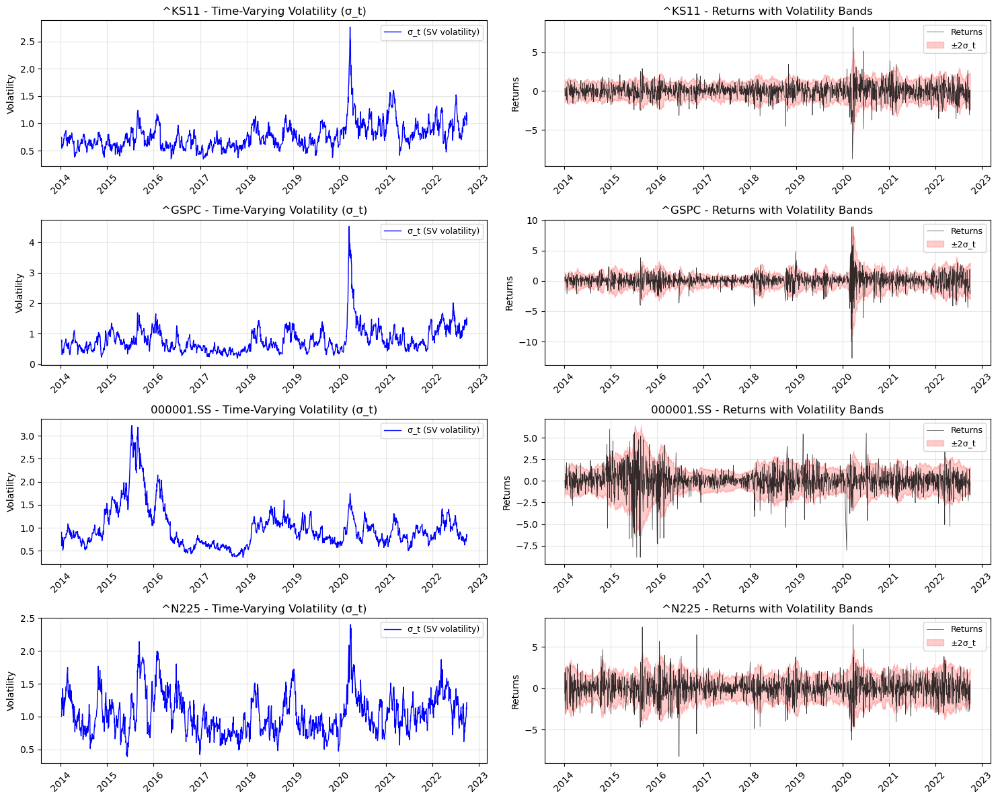

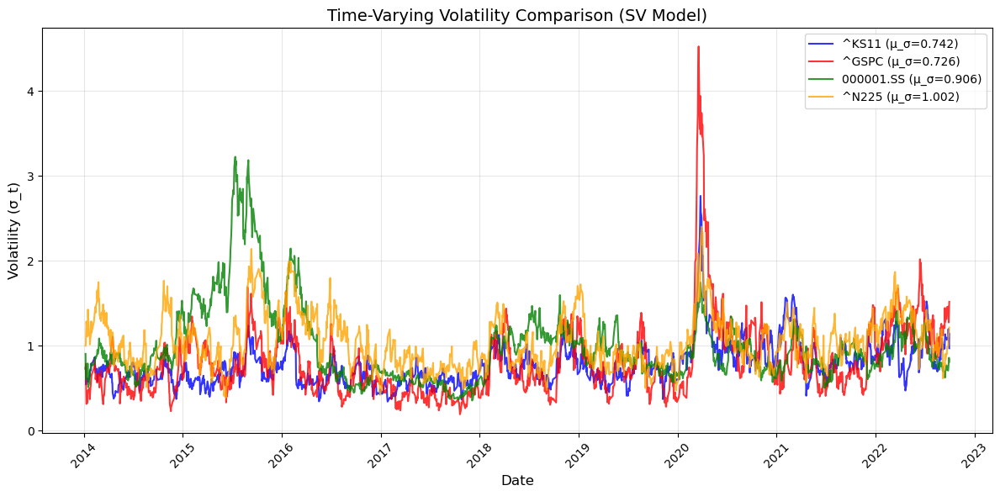

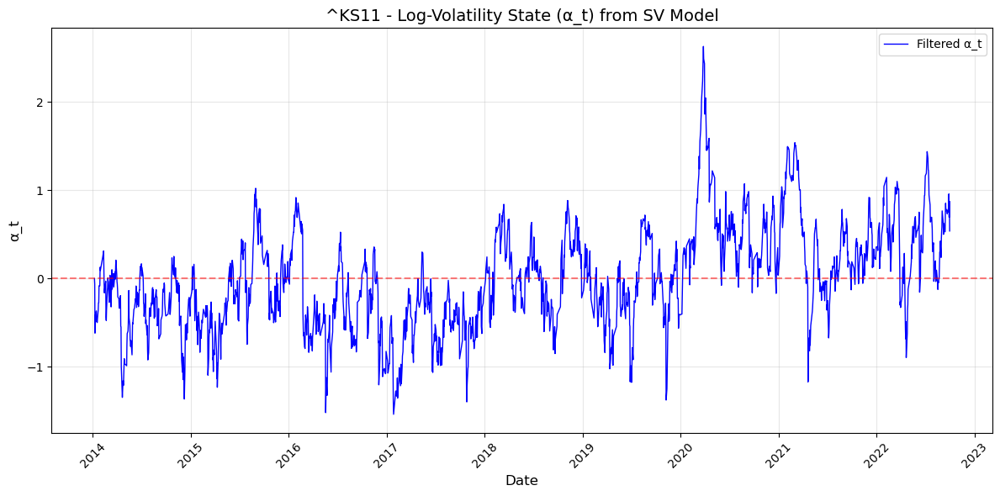


^KS11 - Volatility Statistics:
  Mean σ_t: 0.7740
  Std σ_t: 0.2542
  Min σ_t: 0.3438
  Max σ_t: 2.7654
  Unconditional σ: 0.7420


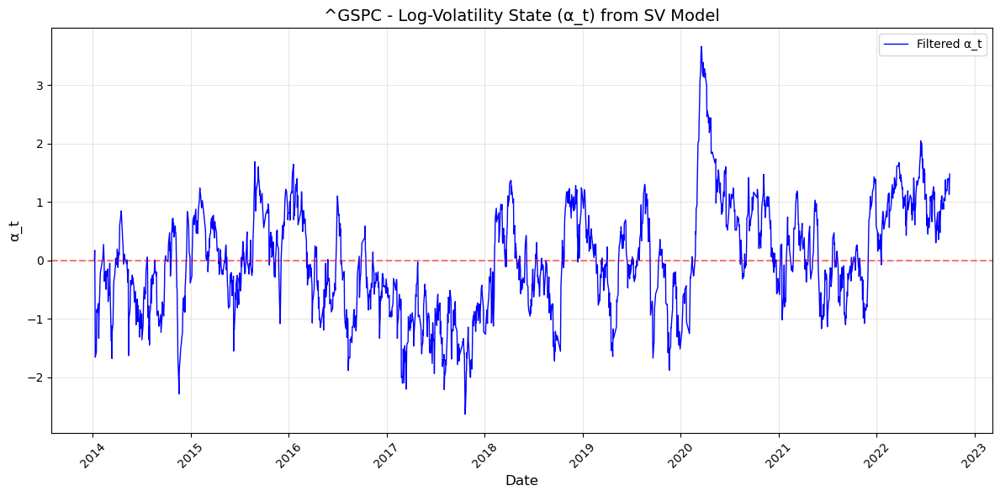


^GSPC - Volatility Statistics:
  Mean σ_t: 0.8064
  Std σ_t: 0.4462
  Min σ_t: 0.1944
  Max σ_t: 4.5245
  Unconditional σ: 0.7263


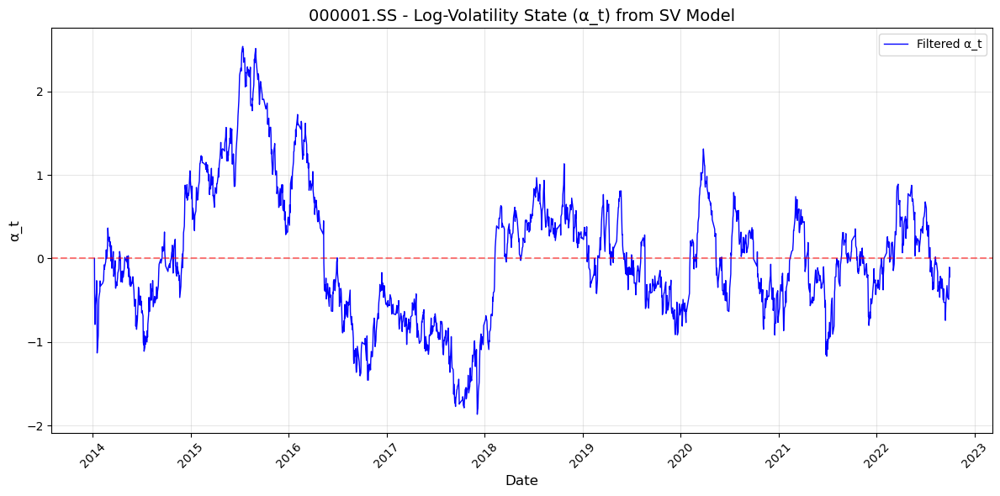


000001.SS - Volatility Statistics:
  Mean σ_t: 0.9926
  Std σ_t: 0.4519
  Min σ_t: 0.3564
  Max σ_t: 3.2258
  Unconditional σ: 0.9062


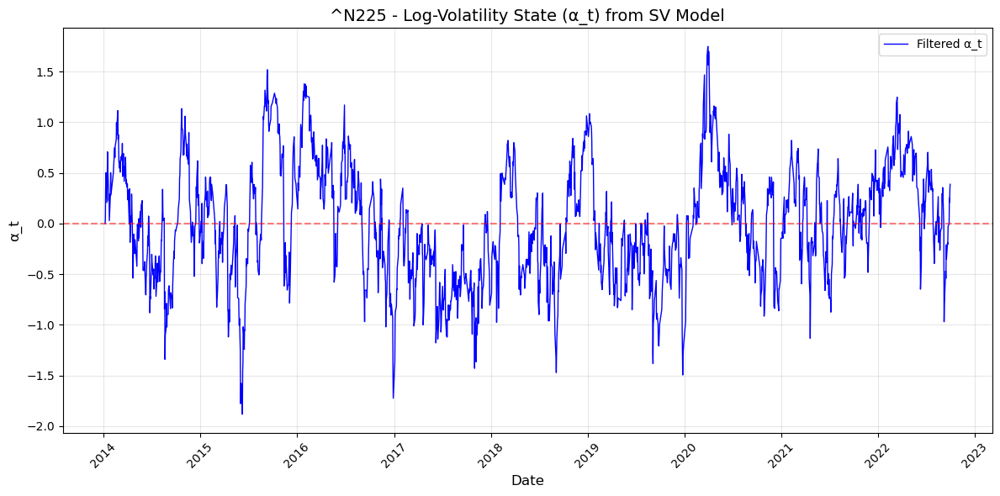


^N225 - Volatility Statistics:
  Mean σ_t: 1.0398
  Std σ_t: 0.3037
  Min σ_t: 0.3910
  Max σ_t: 2.4021
  Unconditional σ: 1.0025

Volatility Summary Statistics
Ticker       Mean σ_t     Std σ_t      Min σ_t      Max σ_t     
--------------------------------------------------------------------------------
^KS11        0.7740       0.2542       0.3438       2.7654      
^GSPC        0.8064       0.4462       0.1944       4.5245      
000001.SS    0.9926       0.4519       0.3564       3.2258      
^N225        1.0398       0.3037       0.3910       2.4021      


In [66]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

def plot_sv_volatility(sv_results, train_returns, figsize=(15, 12)):
    """
    Plot time-varying volatility from SV model results
    """
    fig, axes = plt.subplots(4, 2, figsize=figsize)
    axes = axes.flatten()
    
    plot_idx = 0
    for ticker, result in sv_results.items():
        # Get data
        dates = result['dates']
        sigma_t = result['sigma_t']
        returns = train_returns[ticker].values
        
        # Plot 1: Time-varying volatility
        ax1 = axes[plot_idx]
        ax1.plot(dates, sigma_t, 'b-', linewidth=1, label='σ_t (SV volatility)')
        ax1.set_title(f'{ticker} - Time-Varying Volatility (σ_t)', fontsize=12)
        ax1.set_ylabel('Volatility', fontsize=10)
        ax1.grid(True, alpha=0.3)
        ax1.legend(fontsize=9)
        
        # Format x-axis
        ax1.xaxis.set_major_locator(mdates.YearLocator())
        ax1.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.setp(ax1.xaxis.get_majorticklabels(), rotation=45)
        
        # Plot 2: Returns with volatility bands
        ax2 = axes[plot_idx + 1]
        ax2.plot(dates, returns, 'k-', linewidth=0.5, alpha=0.8, label='Returns')
        ax2.fill_between(dates, 2*sigma_t, -2*sigma_t, alpha=0.2, color='red', label='±2σ_t')
        ax2.set_title(f'{ticker} - Returns with Volatility Bands', fontsize=12)
        ax2.set_ylabel('Returns', fontsize=10)
        ax2.grid(True, alpha=0.3)
        ax2.legend(fontsize=9)
        
        # Format x-axis
        ax2.xaxis.set_major_locator(mdates.YearLocator())
        ax2.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45)
        
        plot_idx += 2
    
    plt.tight_layout()
    plt.savefig('sv_volatility_plots.png', dpi=300, bbox_inches='tight')
    plt.show()

# Call the plotting function
plot_sv_volatility(sv_results, train_returns)

# Additional plot: Compare volatilities across assets
def plot_volatility_comparison(sv_results, figsize=(12, 6)):
    """
    Compare volatilities across all assets in one plot
    """
    plt.figure(figsize=figsize)
    
    colors = ['blue', 'red', 'green', 'orange']
    
    for idx, (ticker, result) in enumerate(sv_results.items()):
        dates = result['dates']
        sigma_t = result['sigma_t']
        
        plt.plot(dates, sigma_t, color=colors[idx], linewidth=1.5, 
                label=f'{ticker} (μ_σ={result["sigma"]:.3f})', alpha=0.8)
    
    plt.title('Time-Varying Volatility Comparison (SV Model)', fontsize=14)
    plt.ylabel('Volatility (σ_t)', fontsize=12)
    plt.xlabel('Date', fontsize=12)
    plt.legend(loc='upper right', fontsize=10)
    plt.grid(True, alpha=0.3)
    
    # Format x-axis
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    plt.xticks(rotation=45)
    
    plt.tight_layout()
    plt.savefig('sv_volatility_comparison.png', dpi=300, bbox_inches='tight')
    plt.show()

# Call comparison plot
plot_volatility_comparison(sv_results)

# Plot smoothed vs filtered states (alpha_t)
def plot_alpha_states(sv_results, ticker, figsize=(12, 6)):
    """
    Plot filtered log-volatility states (alpha_t)
    """
    result = sv_results[ticker]
    dates = result['dates']
    alpha_t = result['alpha_t']
    
    plt.figure(figsize=figsize)
    
    plt.plot(dates, alpha_t, 'b-', linewidth=1, label='Filtered α_t')
    plt.axhline(y=0, color='r', linestyle='--', alpha=0.5)
    
    plt.title(f'{ticker} - Log-Volatility State (α_t) from SV Model', fontsize=14)
    plt.ylabel('α_t', fontsize=12)
    plt.xlabel('Date', fontsize=12)
    plt.legend(fontsize=10)
    plt.grid(True, alpha=0.3)
    
    # Format x-axis
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    plt.xticks(rotation=45)
    
    plt.tight_layout()
    plt.show()
    
    # Print statistics
    print(f"\n{ticker} - Volatility Statistics:")
    print(f"  Mean σ_t: {result['sigma_t'].mean():.4f}")
    print(f"  Std σ_t: {result['sigma_t'].std():.4f}")
    print(f"  Min σ_t: {result['sigma_t'].min():.4f}")
    print(f"  Max σ_t: {result['sigma_t'].max():.4f}")
    print(f"  Unconditional σ: {result['sigma']:.4f}")

# Plot alpha_t for each ticker
for ticker in sv_results.keys():
    plot_alpha_states(sv_results, ticker)

# Summary statistics table
print("\n" + "="*80)
print("Volatility Summary Statistics")
print("="*80)
print(f"{'Ticker':<12} {'Mean σ_t':<12} {'Std σ_t':<12} {'Min σ_t':<12} {'Max σ_t':<12}")
print("-"*80)

for ticker, result in sv_results.items():
    sigma_t = result['sigma_t']
    print(f"{ticker:<12} {sigma_t.mean():<12.4f} {sigma_t.std():<12.4f} "
          f"{sigma_t.min():<12.4f} {sigma_t.max():<12.4f}")

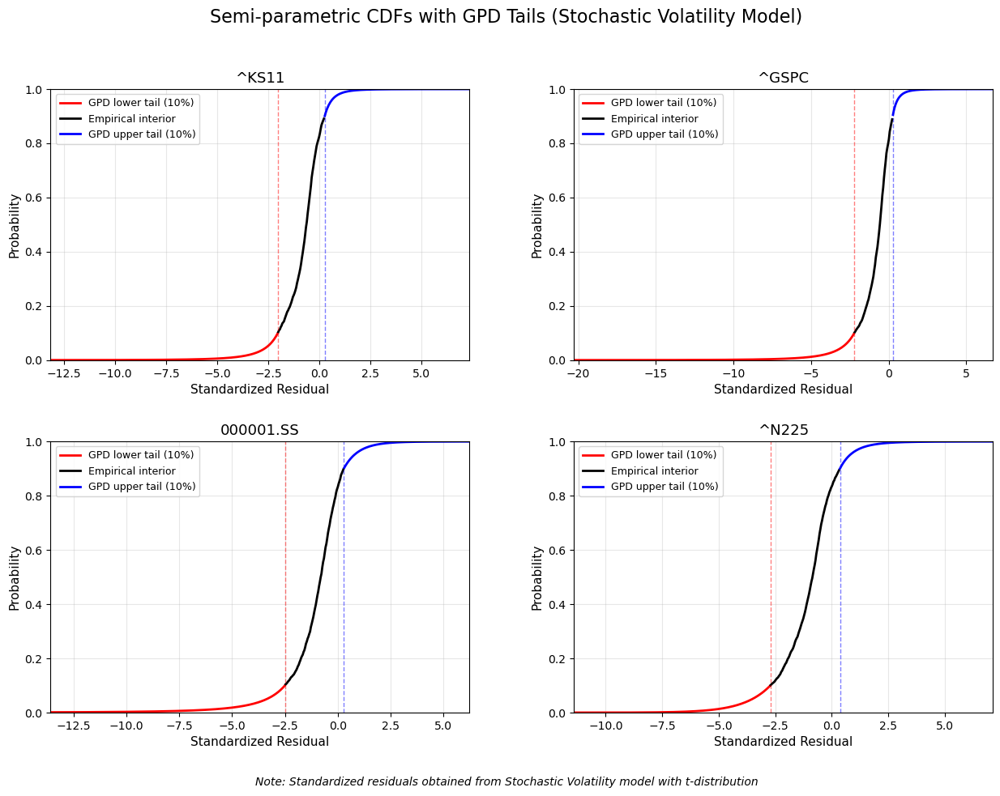


EVT Model Summary (Stochastic Volatility-filtered residuals)

^KS11:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.3010, Scale (σ): 0.6684
  Upper GPD - Shape (ξ): 0.2025, Scale (σ): 0.3527
  Thresholds - Lower: -2.0279, Upper: 0.2724
  Tail observations - Lower: 189, Upper: 189

^GSPC:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.3114, Scale (σ): 0.9432
  Upper GPD - Shape (ξ): 0.2088, Scale (σ): 0.3090
  Thresholds - Lower: -2.2173, Upper: 0.2600
  Tail observations - Lower: 189, Upper: 189

000001.SS:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): 0.3333, Scale (σ): 1.0988
  Upper GPD - Shape (ξ): 0.0298, Scale (σ): 0.6942
  Thresholds - Lower: -2.5032, Upper: 0.2872
  Tail observations - Lower: 189, Upper: 189

^N225:
  Tail fractions - Lower: 10%, Upper: 10%
  Lower GPD - Shape (ξ): -0.0212, Scale (σ): 1.1602
  Upper GPD - Shape (ξ): 0.1135, Scale (σ): 0.6062
  Thresholds - Lower: -2.7193, Upper: 0.3590
  Tail obs

In [20]:
sv_residuals = residuals_dict 
evt_models, uniform_data = plot_evt_cdfs_by_model(
    sv_residuals, 
    model_type='Stochastic Volatility',
    tail_fractions=TAIL_FRACTIONS  # 자산별 꼬리 비율 전달
)


Fitting C-Vine Copula for SV Model

Fitting SV-t-EVT-CVine Copula...
Number of observations: 1887
Assets: ['^KS11', '^GSPC', '000001.SS', '^N225']

Asymmetric Tail Fractions:
  ^KS11: Lower 10%, Upper 10%
  ^GSPC: Lower 10%, Upper 10%
  000001.SS: Lower 10%, Upper 10%
  ^N225: Lower 10%, Upper 10%
** Tree:  1
1,0  --->  Student : parameters =  [0.2557937939521455, 4.221578809518385]
2,0  --->  Gumbel180 : parameters =  1.2649885730222579
0,3  --->  Student : parameters =  [0.5619617512257318, 6.778907335055588]
** Tree:  2
1,3|0  --->  Student : parameters =  [0.1237651749271024, 7.42317542032143]
2,3|0  --->  Gumbel180 : parameters =  1.07680022363713
** Tree:  3
1,2|3,0  --->  Frank : parameters =  0.49423221728489136


<Figure size 1200x800 with 0 Axes>

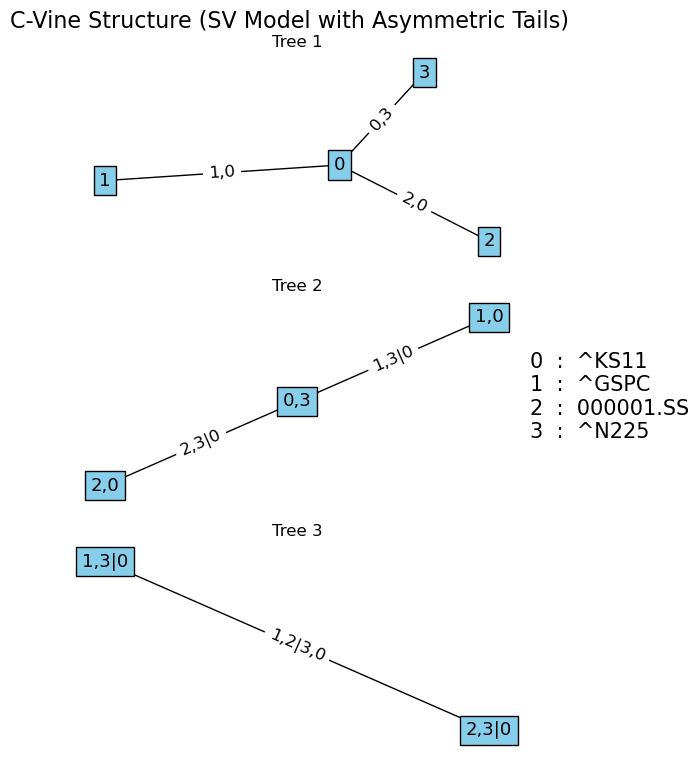

<Figure size 640x480 with 0 Axes>


C-Vine Copula Structure:
Structure Matrix M:
[[ 0.  0.  3.  3.]
 [ 3.  3.  0. nan]
 [ 2.  2. nan nan]
 [ 1. nan nan nan]]

Copula Families C:
[[15.  4. 15. nan]
 [15.  4. nan nan]
 [10. nan nan nan]
 [nan nan nan nan]]

Parameters P:
[[list([0.2557937939521455, 4.221578809518385]) 1.2649885730222579
  list([0.5619617512257318, 6.778907335055588]) nan]
 [list([0.1237651749271024, 7.42317542032143]) 1.07680022363713 nan nan]
 [0.49423221728489136 nan nan nan]
 [nan nan nan nan]]


In [29]:
#sv_evt = plot_gpd_tail_fits_by_model(sv_residuals, model_type='SV')

M_sv, P_sv, C_sv, uniform_sv, evt_models_sv = fit_vine_copula_by_model(
   sv_residuals, 
   model_type='SV',
   vine_type='C'
)


Fitting D-Vine Copula for SV Model

Fitting SV-t-EVT-DVine Copula...
Number of observations: 1887
Assets: ['^KS11', '^GSPC', '000001.SS', '^N225']

Asymmetric Tail Fractions:
  ^KS11: Lower 10%, Upper 10%
  ^GSPC: Lower 10%, Upper 10%
  000001.SS: Lower 10%, Upper 10%
  ^N225: Lower 10%, Upper 10%
** Tree:  1
1,3  --->  Student : parameters =  [0.24114500643725714, 3.8781176477705284]
2,0  --->  Gumbel180 : parameters =  1.2649885730222579
0,3  --->  Student : parameters =  [0.5619617512257318, 6.778907335055588]
** Tree:  2
1,0|3  --->  Student : parameters =  [0.17001955787909806, 10.519633360360581]
2,3|0  --->  Gumbel180 : parameters =  1.07680022363713
** Tree:  3
1,2|0,3  --->  Frank : parameters =  0.4837348131889031


<Figure size 1200x800 with 0 Axes>

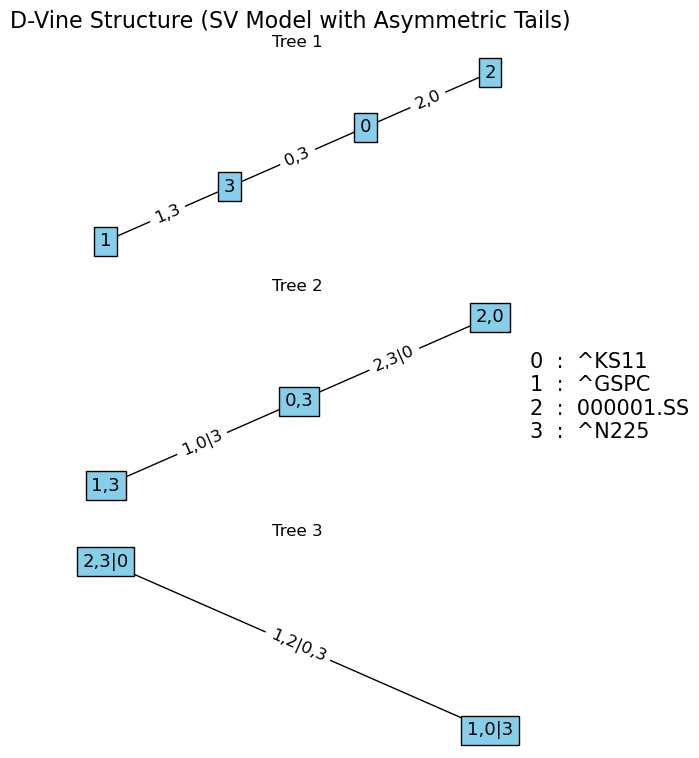

<Figure size 640x480 with 0 Axes>


D-Vine Copula Structure:
Structure Matrix M:
[[ 3.  0.  3.  3.]
 [ 0.  3.  0. nan]
 [ 2.  2. nan nan]
 [ 1. nan nan nan]]

Copula Families C:
[[15.  4. 15. nan]
 [15.  4. nan nan]
 [10. nan nan nan]
 [nan nan nan nan]]

Parameters P:
[[list([0.24114500643725714, 3.8781176477705284]) 1.2649885730222579
  list([0.5619617512257318, 6.778907335055588]) nan]
 [list([0.17001955787909806, 10.519633360360581]) 1.07680022363713 nan
  nan]
 [0.4837348131889031 nan nan nan]
 [nan nan nan nan]]


In [30]:
M_sv, P_sv, C_sv, uniform_sv, evt_models_sv = fit_vine_copula_by_model(
   sv_residuals, 
   model_type='SV',
   vine_type='D'
)

In [22]:
def var_backtesting_periodic_reestimation_sv(train_returns, test_returns, 
                                            lookback_window=250, reestimation_freq=5,
                                            n_sim=1000, var_levels=[0.90, 0.95, 0.99], 
                                            tail_fractions=None, vine_type='C'):  # 변경
    
    # 기본값 설정
    if tail_fractions is None:
        tail_fractions = {asset: {'lower': 0.1, 'upper': 0.1} 
                         for asset in train_returns.keys()}
    
    print(f"\n{'='*60}")
    print(f"Periodic Reestimation VaR Backtesting for SV-QML Model")
    print(f"Lookback window: {lookback_window} days")
    print(f"Reestimation frequency: every {reestimation_freq} days")
    print(f"Using asymmetric tail fractions")  # 추가
    print(f"{'='*60}")
    
    test_dates = test_returns[list(test_returns.keys())[0]].index
    n_test = len(test_dates)
    
    var_results = {level: {'VaR': [], 'Returns': [], 'Violations': []} 
                  for level in var_levels}
    portfolio_returns = []
    
    n_assets = len(test_returns)
    weights = np.ones(n_assets) / n_assets
    
    current_var_values = {level: None for level in var_levels}
    
    for day_idx in range(n_test):
        current_date = test_dates[day_idx]
        
        # Reestimate model only at specified frequency
        if day_idx % reestimation_freq == 0:
            print(f"Reestimating model at day {day_idx + 1}/{n_test}")
            
            # Prepare rolling window data
            rolling_window_data = {}
            
            for asset in train_returns.keys():
                if day_idx == 0:
                    rolling_window_data[asset] = train_returns[asset].iloc[-lookback_window:]
                else:
                    all_historical = pd.concat([train_returns[asset], test_returns[asset].iloc[:day_idx]])
                    rolling_window_data[asset] = all_historical.iloc[-lookback_window:]
            
            try:
                # Fit SV models - 여기서 estimate_sv_qml_all 함수가 plot을 비활성화하도록 수정 필요
                sv_results = {}
                for ticker in rolling_window_data.keys():
                    print(f"  Estimating SV for {ticker}...", end='')
                    returns = rolling_window_data[ticker]
                    
                    # SV 추정 (plot 없이)
                    y = returns.values
                    mu = np.mean(y)
                    y_centered = y - mu
                    x = np.log(y_centered**2 + 1e-8)
                    c = -1.27
                    var_c = 4.93
                    x_star = x - c
                    
                    # Kalman filter 설정 및 최적화
                    def setup_kalman(phi, sigma_eta):
                        from filterpy.kalman import KalmanFilter
                        kf = KalmanFilter(dim_x=1, dim_z=1)
                        kf.F = np.array([[phi]])
                        kf.H = np.array([[1.0]])
                        kf.R = var_c
                        kf.Q = sigma_eta**2
                        kf.x = np.array([[0.0]])
                        kf.P = np.array([[sigma_eta**2 / (1 - phi**2)]])
                        return kf
                    
                    def neg_log_likelihood(params):
                        phi, sigma_eta = params
                        if abs(phi) >= 0.99 or sigma_eta <= 0:
                            return 1e10
                        kf = setup_kalman(phi, sigma_eta)
                        log_lik = 0
                        for i in range(len(x_star)):
                            kf.predict()
                            kf.update(x_star[i])
                            v = x_star[i] - kf.H @ kf.x_prior
                            F = kf.H @ kf.P_prior @ kf.H.T + kf.R
                            log_lik += -0.5 * (np.log(2*np.pi) + np.log(F) + v**2/F)
                        return -log_lik
                    
                    from scipy.optimize import minimize
                    result = minimize(neg_log_likelihood, [0.9, 0.3], 
                                    bounds=[(0.01, 0.99), (0.01, 2.0)],
                                    method='L-BFGS-B')
                    
                    phi_hat, sigma_eta_hat = result.x
                    
                    # Filtered states 계산
                    kf = setup_kalman(phi_hat, sigma_eta_hat)
                    filtered_states = []
                    for i in range(len(x_star)):
                        kf.predict()
                        kf.update(x_star[i])
                        filtered_states.append(kf.x[0, 0])
                    
                    filtered_states = np.array(filtered_states)
                    sigma_hat = np.std(y_centered)
                    volatility = sigma_hat * np.exp(filtered_states / 2)
                    
                    sv_results[ticker] = {
                        'phi': phi_hat,
                        'sigma_eta': sigma_eta_hat,
                        'mu': mu,
                        'volatility': volatility,
                        'filtered_states': filtered_states
                    }
                    print(" done")
                
                # Get residuals
                residuals = get_sv_residuals(rolling_window_data, sv_results)
                
                # EVT and Copula fitting with asset-specific tail fractions
                evt_models = {}
                uniform_data_dict = {}
                
                for asset, resid in residuals.items():
                    if resid is None:
                        continue
                    
                    data = np.array(resid)
                    if data.ndim > 1:
                        data = data[:, 0]
                    
                    # 자산별 꼬리 비율 적용
                    asset_tail_fractions = tail_fractions.get(asset, {'lower': 0.1, 'upper': 0.1})
                    
                    evt_obj = ParetoTailsEVT(
                        data, 
                        tail_fraction_up=asset_tail_fractions['upper'],
                        tail_fraction_down=asset_tail_fractions['lower']
                    )
                    evt_models[asset] = evt_obj
                    
                    uniform_data = evt_obj.cdf(data)
                    uniform_data_dict[asset] = uniform_data
                
                uniform_evt = pd.DataFrame(uniform_data_dict)
                u_data = uniform_evt.values
                
                M, P, C = fit_vinecop(u_data, list(range(1, 16)), vine=vine_type)
                u_sim = sample_vinecop(M, P, C, n_sim)
                
                simulated_residuals = np.zeros((n_sim, n_assets))
                for i, asset in enumerate(uniform_evt.columns):
                    simulated_residuals[:, i] = evt_models[asset].icdf(u_sim[:, i])
                
                # Get last volatilities from SV model
                last_volatilities = {}
                for asset in sv_results.keys():
                    last_volatilities[asset] = sv_results[asset]['volatility'][-1]
                
                # Simulate returns
                simulated_returns = np.zeros((n_sim, n_assets))
                for i, asset in enumerate(uniform_evt.columns):
                    mean = sv_results[asset]['mu']
                    vol = last_volatilities[asset]
                    simulated_returns[:, i] = mean + vol * simulated_residuals[:, i]
                
                portfolio_sim_returns = simulated_returns @ weights
                
                # Update VaR values
                for level in var_levels:
                    current_var_values[level] = np.percentile(portfolio_sim_returns, (1 - level) * 100)
                
            except Exception as e:
                print(f"Error on {current_date}: {e}")
                # Use historical VaR as fallback
                for level in var_levels:
                    hist_portfolio_returns = []
                    for idx in range(len(rolling_window_data[list(rolling_window_data.keys())[0]])):
                        daily_ret = sum(rolling_window_data[asset].iloc[idx] * weights[i] 
                                      for i, asset in enumerate(rolling_window_data.keys()))
                        hist_portfolio_returns.append(daily_ret)
                    
                    current_var_values[level] = np.percentile(hist_portfolio_returns, (1 - level) * 100)
        
        # Use current VaR values
        for level in var_levels:
            var_results[level]['VaR'].append(current_var_values[level])
        
        # Calculate actual portfolio return
        daily_returns = [test_returns[asset].loc[current_date] for asset in test_returns.keys()]
        portfolio_return = np.array(daily_returns) @ weights
        portfolio_returns.append(portfolio_return)
        
        for level in var_levels:
            var_results[level]['Returns'].append(portfolio_return)
    
    # Testing and results
    test_results = {}
    
    for level in var_levels:
        var_array = np.array(var_results[level]['VaR'])
        returns_array = np.array(var_results[level]['Returns'])
        violations = returns_array < var_array
        var_results[level]['Violations'] = violations
        
        kupiec_result = kupiec_test(violations, len(violations), level)
        christoffersen_result = christoffersen_test(violations, level)
        
        test_results[level] = {
            'kupiec': kupiec_result,
            'christoffersen': christoffersen_result
        }
        
        print(f"\n{level*100}% VaR Results:")
        print(f"Total observations: {len(violations)}")
        print(f"Violations: {kupiec_result['violations']}")
        print(f"Violation rate: {kupiec_result['violation_rate']:.4f}")
        print(f"Expected rate: {kupiec_result['expected_rate']:.4f}")
        print(f"\nKupiec Test:")
        print(f"  LR statistic: {kupiec_result['statistic']:.4f}")
        print(f"  p-value: {kupiec_result['p_value']:.4f}")
        print(f"\nChristoffersen Test:")
        print(f"  UC statistic: {christoffersen_result['uc_statistic']:.4f} (p-value: {christoffersen_result['uc_p_value']:.4f})")
        print(f"  Independence statistic: {christoffersen_result['ind_statistic']:.4f} (p-value: {christoffersen_result['ind_p_value']:.4f})")
        print(f"  CC statistic: {christoffersen_result['cc_statistic']:.4f} (p-value: {christoffersen_result['cc_p_value']:.4f})")
    
    # 사용된 꼬리 비율 출력
    print(f"\nAsymmetric Tail Fractions Used:")
    for asset, fractions in tail_fractions.items():
        print(f"  {asset}: Lower {fractions['lower']*100:.0f}%, Upper {fractions['upper']*100:.0f}%")
    
    backtest_results = {
        'model_type': 'SV-QML',
        'var_results': var_results,
        'test_results': test_results,
        'portfolio_returns': portfolio_returns,
        'test_dates': test_dates,
        'lookback_window': lookback_window,
        'reestimation_freq': reestimation_freq,
        'n_sim': n_sim,
        'tail_fractions': tail_fractions  # 추가
    }
    
    return backtest_results



In [40]:
# SV 백테스팅 실행
sv_backtest = var_backtesting_periodic_reestimation_sv(
    train_returns, 
    test_returns,
    tail_fractions=TAIL_FRACTIONS,reestimation_freq=90, 
    n_sim=10000  
)


Periodic Reestimation VaR Backtesting for SV-QML Model
Lookback window: 250 days
Reestimation frequency: every 90 days
Using asymmetric tail fractions
Reestimating model at day 1/484
  Estimating SV for ^KS11... done
  Estimating SV for ^GSPC... done
  Estimating SV for 000001.SS... done
  Estimating SV for ^N225... done
Error on 2022-10-11 00:00:00: name 'get_sv_residuals' is not defined
Reestimating model at day 91/484
  Estimating SV for ^KS11... done
  Estimating SV for ^GSPC... done
  Estimating SV for 000001.SS... done
  Estimating SV for ^N225... done
Error on 2023-03-09 00:00:00: name 'get_sv_residuals' is not defined
Reestimating model at day 181/484
  Estimating SV for ^KS11... done
  Estimating SV for ^GSPC... done
  Estimating SV for 000001.SS... done
  Estimating SV for ^N225... done
Error on 2023-08-03 00:00:00: name 'get_sv_residuals' is not defined
Reestimating model at day 271/484
  Estimating SV for ^KS11... done
  Estimating SV for ^GSPC... done
  Estimating SV for 

In [98]:
def portfolio_garch_var_periodic_reestimation(train_returns, test_returns, 
                                             lookback_window=250, reestimation_freq=1,
                                             var_levels=[0.95, 0.99], model_type='GARCH', 
                                             garch_p=1, garch_q=1, n_simulations=10000):
    """
    GARCH-t 포트폴리오 VaR with periodic reestimation (EVT-Copula와 동일한 방식)
    """
    
    print(f"\n{'='*60}")
    print(f"Periodic Reestimation VaR Backtesting for {model_type}-t Model")
    print(f"Lookback window: {lookback_window} days")
    print(f"Reestimation frequency: every {reestimation_freq} days")
    print(f"{'='*60}")
    
    # Setup
    n_assets = len(test_returns)
    weights = np.array([1/n_assets] * n_assets)
    tickers = list(test_returns.keys())
    
    # DataFrame으로 변환하여 날짜 정렬
    test_df = pd.DataFrame(test_returns)
    test_df = test_df.dropna()  # NaN 제거
    test_dates = test_df.index
    n_test = len(test_dates)
    
    # Storage
    portfolio_returns_actual = []
    var_forecasts = {level: [] for level in var_levels}
    current_var_values = {level: None for level in var_levels}
    
    for day_idx in range(n_test):
        current_date = test_dates[day_idx]
        
        # Reestimate only at specified frequency
        if day_idx % reestimation_freq == 0:
            if day_idx % 50 == 0:  # Progress indicator
                print(f"Reestimating model at day {day_idx + 1}/{n_test}")
            
            # Prepare rolling window data
            rolling_window_data = {}
            
            for asset in tickers:
                if day_idx == 0:
                    # Use last 'lookback_window' days from train data
                    rolling_window_data[asset] = train_returns[asset].iloc[-lookback_window:]
                else:
                    # Combine train and available test data
                    all_historical = pd.concat([train_returns[asset], 
                                              test_df[asset].iloc[:day_idx]])
                    rolling_window_data[asset] = all_historical.iloc[-lookback_window:]
            
            try:
                # Fit GARCH models for each asset
                one_step_simulations = []
                
                for asset in tickers:
                    window_returns = rolling_window_data[asset]
                    
                    # GARCH model
                    if model_type == 'GARCH':
                        model = arch_model(window_returns, vol='Garch', p=garch_p, q=garch_q, 
                                         dist='StudentsT', rescale=False)
                    elif model_type == 'EGARCH':
                        model = arch_model(window_returns, vol='EGARCH', p=garch_p, q=garch_q, 
                                         dist='StudentsT', rescale=False)
                    elif model_type == 'GJR-GARCH':
                        model = arch_model(window_returns, vol='GARCH', p=garch_p, q=garch_q, o=1,
                                         dist='StudentsT', rescale=False)
                    
                    # Fit model
                    res = model.fit(disp='off', show_warning=False)
                    
                    # Extract parameters
                    mu = res.params['mu']
                    nu = res.params['nu']
                    
                    # 1-step ahead volatility forecast
                    forecast = res.forecast(horizon=1)
                    sigma_forecast = np.sqrt(forecast.variance.values[-1, 0])
                    
                    # Simulate from Student-t
                    std_t_draws = t.rvs(df=nu, size=n_simulations)
                    returns_simulated = mu + sigma_forecast * std_t_draws
                    one_step_simulations.append(returns_simulated)
                
                # Portfolio returns simulation
                portfolio_simulations = np.zeros(n_simulations)
                for j, sim in enumerate(one_step_simulations):
                    portfolio_simulations += weights[j] * sim
                
                # Update VaR values
                for level in var_levels:
                    current_var_values[level] = np.percentile(portfolio_simulations, (1-level)*100)
                    
            except Exception as e:
                print(f"Error on {current_date}: {e}")
                # Use previous VaR or historical if first day
                if day_idx == 0:
                    for level in var_levels:
                        current_var_values[level] = -2.0  # Conservative default
        
        # Store current VaR values
        for level in var_levels:
            var_forecasts[level].append(current_var_values[level])
        
        # Calculate actual portfolio return using DataFrame
        portfolio_return = (test_df.iloc[day_idx] * weights).sum()
        portfolio_returns_actual.append(portfolio_return)
    
    # Backtesting
    portfolio_returns_actual = np.array(portfolio_returns_actual)
    
    results = {}
    for level in var_levels:
        var_values = np.array(var_forecasts[level])
        violations = portfolio_returns_actual < var_values
        
        # Tests
        kupiec_result = kupiec_test(violations, len(violations), level)
        chris_result = christoffersen_test(violations, level)
        
        results[f'VaR_{int(level*100)}'] = {
            'var_values': var_values,
            'portfolio_returns': portfolio_returns_actual,
            'dates': test_dates,
            'violations': violations,
            'kupiec': kupiec_result,
            'christoffersen': chris_result
        }
        
        # Print results
        print(f"\n{int(level*100)}% VaR Results:")
        print(f"Total observations: {len(violations)}")
        print(f"Violations: {kupiec_result['violations']}")
        print(f"Violation rate: {kupiec_result['violation_rate']:.4f}")
        print(f"Expected rate: {kupiec_result['expected_rate']:.4f}")
        print(f"Kupiec Test:")
        print(f"  LR statistic: {kupiec_result['statistic']:.4f}")
        print(f"  p-value: {kupiec_result['p_value']:.4f}")
        print(f"Christoffersen Test:")
        print(f"  UC statistic: {chris_result['uc_statistic']:.4f} (p-value: {chris_result['uc_p_value']:.4f})")
        print(f"  Independence statistic: {chris_result['ind_statistic']:.4f} (p-value: {chris_result['ind_p_value']:.4f})")
        print(f"  CC statistic: {chris_result['cc_statistic']:.4f} (p-value: {chris_result['cc_p_value']:.4f})")
    
    return results

# 실행
print("Starting Portfolio GARCH-t VaR Backtesting (Periodic Reestimation)...")
garch_results = portfolio_garch_var_periodic_reestimation(
    train_returns, 
    test_returns,
    lookback_window=250,
    reestimation_freq=1,  # EVT-Copula와 동일하게 설정
    var_levels=[0.95, 0.99],
    model_type='GARCH'
)

Starting Portfolio GARCH-t VaR Backtesting (Periodic Reestimation)...

Periodic Reestimation VaR Backtesting for GARCH-t Model
Lookback window: 250 days
Reestimation frequency: every 1 days
Reestimating model at day 1/484
Reestimating model at day 51/484
Reestimating model at day 101/484
Reestimating model at day 151/484
Reestimating model at day 201/484
Reestimating model at day 251/484
Reestimating model at day 301/484
Reestimating model at day 351/484
Reestimating model at day 401/484
Reestimating model at day 451/484

95% VaR Results:
Total observations: 484
Violations: 33
Violation rate: 0.0682
Expected rate: 0.0500
Kupiec Test:
  LR statistic: 6.4251
  p-value: 0.0113
Christoffersen Test:
  UC statistic: 6.4251 (p-value: 0.0113)
  Independence statistic: 11.5969 (p-value: 0.0007)
  CC statistic: 18.0220 (p-value: 0.0001)

99% VaR Results:
Total observations: 484
Violations: 16
Violation rate: 0.0331
Expected rate: 0.0100
Kupiec Test:
  LR statistic: 16.5251
  p-value: 0.0000
Chri